In [27]:
import numpy as np
from numpy.fft import fftshift, fftfreq, fft
import matplotlib.pyplot as plt
import pandas as pd
import sys
sys.path.append("..")
from utils import *
from utils import Shuffler

In [28]:
df = pd.read_csv("../simulation/data/debug/excitation_sinusoidal.csv")

In [29]:
df

,Unnamed: 0,t,x,y,fx,fy,freq,axis,seal,episode
0,0,0.0000,6.848546e-07,-6.186171e-07,-0.058351,-0.019020,4,x,True,0
1,1,0.0001,-7.602323e-07,1.305000e-06,0.015808,0.008943,4,x,True,0
2,2,0.0002,6.286123e-07,2.155544e-07,-0.016834,0.016824,4,x,True,0
3,3,0.0003,-1.456910e-07,1.227568e-06,0.008314,-0.009363,4,x,True,0
4,4,0.0004,1.245632e-07,-9.123509e-07,0.013657,0.009945,4,x,True,0
...,...,...,...,...,...,...,...,...,...,...
5599995,99995,9.9995,-6.194120e-07,1.078341e-06,-0.025812,-0.201203,69,y,False,0
5599996,99996,9.9996,3.940618e-07,8.447836e-07,-0.013240,-0.170195,69,y,False,0
5599997,99997,9.9997,3.352136e-07,-1.368463e-06,0.005164,-0.117828,69,y,False,0
5599998,99998,9.9998,1.354163e-06,-1.234131e-06,0.014042,-0.080056,69,y,False,0


In [30]:
freq = 69
sel_df = df[(df.seal == False) & (df.axis == "x") & (df.episode == 0) & (df.freq == freq)]

(2.0, 3.0)

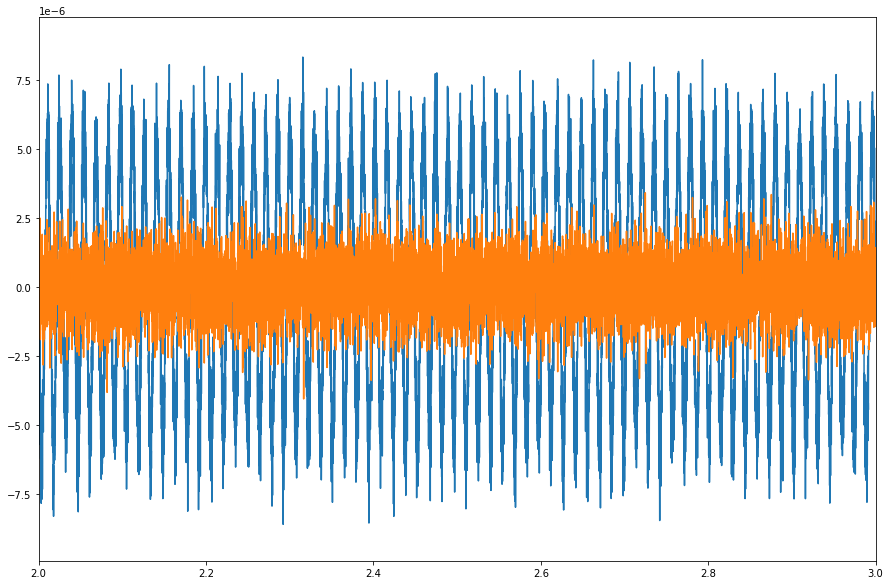

In [31]:
plt.figure(figsize=(15,10))
plt.plot(sel_df.t[sel_df.t > 2], sel_df.x[sel_df.t > 2])
plt.plot(sel_df.t[sel_df.t > 2], sel_df.y[sel_df.t > 2])
plt.xlim(2, 3)

(2.0, 3.0)

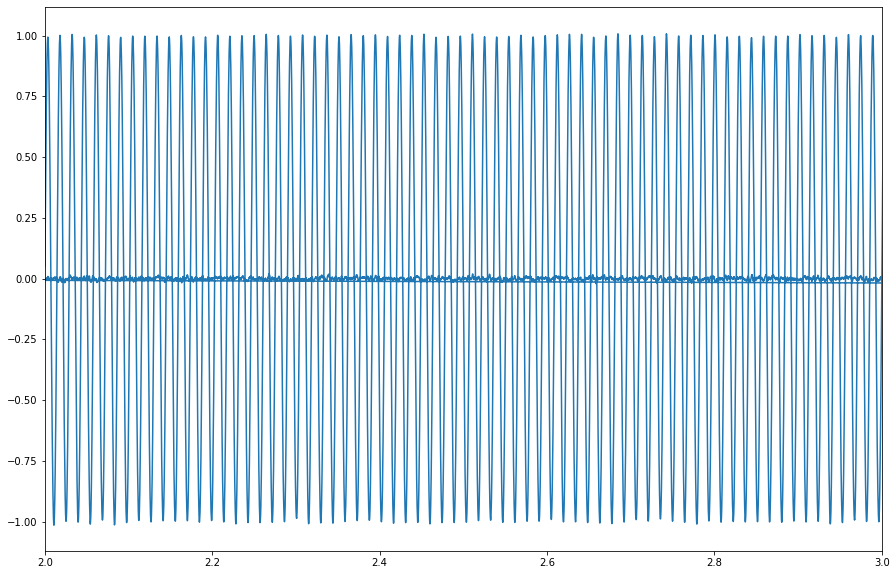

In [52]:
plt.figure(figsize=(15,10))
plt.plot(sel_df.t[sel_df.t > 2], sel_df.fx[sel_df.t > 2])
#plt.plot(sel_df.t[sel_df.t > 2], sel_df.fy[sel_df.t > 2])
plt.xlim(2, 3)

# Linear Regression

In [33]:
def linreg_estimate(df):
    
    #df["x_dot2"] =  df["x_dot2"].shift()
    #df["y_dot2"] =  df["y_dot2"].shift()
    
    df = df[df.t > 0.5]
    X = df[["x_dot", "y_dot", "x", "y"]].values
    df["fx_"] = df["fx"] - 1*df["x_dot2"]
    df["fy_"] = df["fy"] - 1*df["y_dot2"]
    Y = df[["fx_", "fy_"]].values
    params = np.linalg.inv( X.transpose() @ X ) @ X.transpose() @ Y
    
    C = params[:2].transpose()
    K = params[2:].transpose()
    
    return {"C" : C,
            "K" : K}

def add_derivatives(df):
    all_data = pd.DataFrame()
    
    for name, group in df.groupby(["seal", "episode", "freq"]):
        
        dt = (df["t"] - df["t"].shift()).median()
        group = append_derivatives_to_dataframe(group, "x", dt=dt)
        group = append_derivatives_to_dataframe(group, "y", dt=dt)
        group = append_derivatives_to_dataframe(group, "fx", dt=dt)
        group = append_derivatives_to_dataframe(group, "fy", dt=dt)
        
        all_data = pd.concat([all_data, group])
        
    return all_data
        
    

In [34]:
freq = 19
sel_df = df[(df.seal == True) & (df.episode == 0) & (df.freq == freq)]
sel_df = add_derivatives(sel_df)
with_seal = linreg_estimate(sel_df)

<ipython-input-33-91a1c2329b6d>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fx_"] = df["fx"] - 1*df["x_dot2"]
<ipython-input-33-91a1c2329b6d>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fy_"] = df["fy"] - 1*df["y_dot2"]


In [35]:
sel_df = df[(df.seal == False) & (df.episode == 0) & (df.freq == freq)]
sel_df = add_derivatives(sel_df)
wo_seal = linreg_estimate(sel_df)

<ipython-input-33-91a1c2329b6d>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fx_"] = df["fx"] - 1*df["x_dot2"]
<ipython-input-33-91a1c2329b6d>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fy_"] = df["fy"] - 1*df["y_dot2"]


In [36]:
print("Seal C:", with_seal["C"] - wo_seal["C"])
print("Seal K:", with_seal["K"] - wo_seal["K"])

Seal C: [[ 4.10500742e+01 -4.04341840e-03]
 [-8.21462619e-02  4.29716414e+01]]
Seal K: [[4393.24600422 -400.83864032]
 [ 434.06037616  427.64716437]]


In [37]:
Cs = []
Ks = []
Fs = []

for freq in df.freq.unique():
    
    sel_df = df[(df.seal == True) &  (df.freq == freq)]
    sel_df = add_derivatives(sel_df)
    with_seal = linreg_estimate(sel_df)
    
    sel_df = df[(df.seal == False) &  (df.freq == freq)]
    sel_df = add_derivatives(sel_df)
    wo_seal = linreg_estimate(sel_df)

    C = with_seal["C"] - wo_seal["C"]
    K = with_seal["K"] - wo_seal["K"]
    
    Cs.append(C)
    Ks.append(K)
    Fs.append(freq)
    
Cs = np.array(Cs)
Ks = np.array(Ks)
Fs = np.array(Fs)

<ipython-input-33-91a1c2329b6d>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fx_"] = df["fx"] - 1*df["x_dot2"]
<ipython-input-33-91a1c2329b6d>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["fy_"] = df["fy"] - 1*df["y_dot2"]
<ipython-input-33-91a1c2329b6d>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_gu

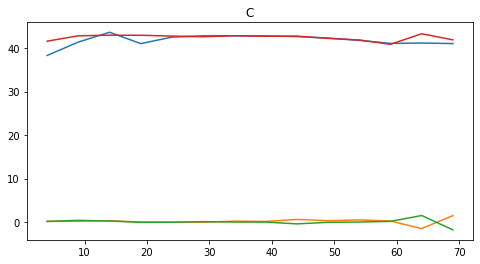

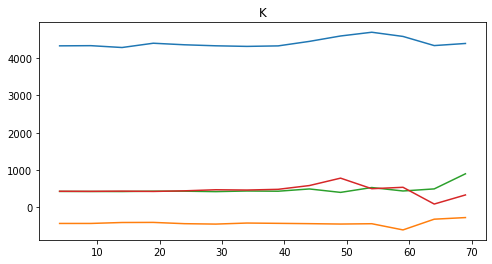

In [38]:
plt.figure(figsize=(8,4))
plt.title("C")
plt.plot(Fs, Cs[:, 0, 0])
plt.plot(Fs, Cs[:, 0, 1])
plt.plot(Fs, Cs[:, 1, 0])
plt.plot(Fs, Cs[:, 1, 1])
plt.show()


plt.figure(figsize=(8,4))
plt.title("K")
plt.plot(Fs, Ks[:, 0, 0])
plt.plot(Fs, Ks[:, 0, 1])
plt.plot(Fs, Ks[:, 1, 0])
plt.plot(Fs, Ks[:, 1, 1])
plt.show()

# EIV Estimator

In [39]:
def to_frequency_domain(df):
    data={}
    
    dt = (df["t"] - df["t"].shift()).median()
    for col in ["x", "y", "fy", "fx"]:
        data[col + "f"] = fftshift(fft(df[col].values))
    data["freqs"] = fftshift(fftfreq(data["xf"].shape[0], d = dt))
    return pd.DataFrame(data)

def eiv_estimate(df, freq):
    
    df_freq = pd.DataFrame()
    
    for (episode, axis), group in df.groupby(["episode", "axis"]):
        _df = to_frequency_domain(group)
        _df["axis"] = axis
        _df["episode"] = episode
        
        df_freq = pd.concat([df_freq, _df])
        
    df_freq = select_frequency(df_freq, freq=freq)
    
    Us = []
    Ys = []
    for episode, group in df_freq.groupby("episode"):
        U = group[["xf", "yf"]].values.transpose()
        Y = group[["fxf", "fyf"]].values.transpose()
        Us.append(U)
        Ys.append(Y)
        
    Us = np.array(Us)
    Ys = np.array(Ys)
    
    G = np.mean(Ys, axis=0) @ np.linalg.inv(np.mean(Us, axis=0))
    C = np.imag(G) / (2 * np.pi * freq)
    K = np.real(G) + (2 * np.pi * freq) ** 2 * np.array([[1, 0], [0, 1]])

    return {"freq": freq,
            "G": G,
            "C": C,
            "K": K}
    return df_freq

def select_frequency(df, freq, tol=1e-2):
    
    return df[np.abs(df.freqs - freq) <= tol]


In [40]:
freq = 19
sel_df = df[(df.seal == True) & (df.freq == freq)]
with_seal = eiv_estimate(sel_df, freq)

In [41]:
sel_df = df[(df.seal == False) & (df.freq == freq)]
wo_seal = eiv_estimate(sel_df, freq)

In [42]:
print("Seal C",with_seal["C"] - wo_seal["C"])
print("Seal K", with_seal["K"] - wo_seal["K"])

Seal C [[ 4.31286642e+01 -1.27702151e-03]
 [-5.08415970e-03  4.31620177e+01]]
Seal K [[4308.57876977 -431.7063422 ]
 [ 432.13473478  425.23597319]]


In [43]:
Cs = []
Ks = []
Fs = []

for freq in df.freq.unique():
    
    sel_df = df[(df.seal == True) &  (df.freq == freq)]
    with_seal = eiv_estimate(sel_df, freq)
    
    sel_df = df[(df.seal == False) &  (df.freq == freq)]
    wo_seal = eiv_estimate(sel_df, freq)

    C = with_seal["C"] - wo_seal["C"]
    K = with_seal["K"] - wo_seal["K"]
    
    Cs.append(C)
    Ks.append(K)
    Fs.append(freq)
    
Cs = np.array(Cs)
Ks = np.array(Ks)
Fs = np.array(Fs)

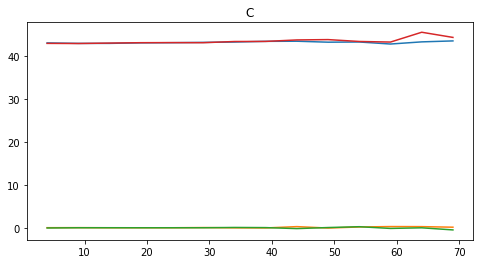

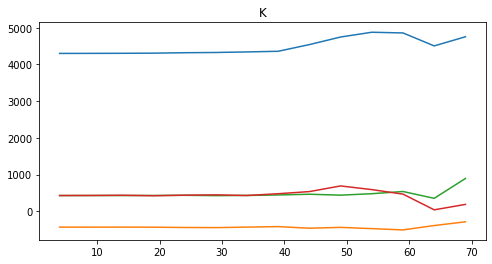

In [44]:
plt.figure(figsize=(8,4))
plt.title("C")
plt.plot(Fs, Cs[:, 0, 0])
plt.plot(Fs, Cs[:, 0, 1])
plt.plot(Fs, Cs[:, 1, 0])
plt.plot(Fs, Cs[:, 1, 1])
plt.show()


plt.figure(figsize=(8,4))
plt.title("K")
plt.plot(Fs, Ks[:, 0, 0])
plt.plot(Fs, Ks[:, 0, 1])
plt.plot(Fs, Ks[:, 1, 0])
plt.plot(Fs, Ks[:, 1, 1])
plt.show()

# Optimization

In [45]:
import jax
from jax import numpy as jnp
from jax.experimental.ode import odeint
from jax import grad, jit, vmap, value_and_grad, jacfwd, jacrev, jacobian, hessian
from jax import random
from jax.experimental import stax
from jax.experimental.optimizers import adam, sgd
from models.newton import mse, initialize_params, get_batch_forward_pass, get_loss_function, train

In [46]:
rng = random.PRNGKey(15)
params = initialize_params(rng, dims=2)

In [89]:


        
def optimize(q, q_dot, q_dot2, f, batch_size=10000, step_size=1e3, epochs=7):

    rng = random.PRNGKey(15)
    params = initialize_params(rng, dims=2, scale=1)
    batch_forward_pass = get_batch_forward_pass(mass=[[1, 0],[0, 1]], g=jnp.array([[0],[0]]))
    
    
    shuffler = Shuffler(len(q))
    q_shuffled = shuffler.shuffle(q)
    q_dot_shuffled = shuffler.shuffle(q_dot)
    q_dot2_shuffled = shuffler.shuffle(q_dot2)
    f_shuffled = shuffler.shuffle(f)
    
    def callback(y_pred, y_true, window = 14000):
        
        plt.figure(figsize=(10, 8))
        random_ind = int(np.random.uniform(0, len(y_pred) - window - 1))
        plt.plot(shuffler.undo_shuffle(np.squeeze(y_pred))[random_ind:(random_ind + window)], linestyle="dotted")
        plt.plot(shuffler.undo_shuffle(np.squeeze(y_true))[random_ind:(random_ind + window)])
        plt.show()
    
    params=train(params, q_shuffled, q_dot_shuffled, q_dot2_shuffled, f_shuffled, batch_size=batch_size, optimizer=adam, step_size=step_size, epochs=epochs, callback=callback, batch_forward_pass=batch_forward_pass)
    return params



def optimization_estimate(df):
    q = df[["x", "y"]].values.reshape((-1, 2, 1))
    q_dot = df[["x_dot", "y_dot"]].values.reshape((-1, 2, 1))
    q_dot2 = df[["x_dot2", "y_dot2"]].values.reshape((-1, 2, 1))
    f = df[["fx", "fy"]].values.reshape((-1, 2, 1))
    params = optimize(q, q_dot, q_dot2, f, batch_size=8192, step_size=1e3, epochs=7)
    K, C = params
    return {"K" : K,
            "C" : C}
    

In [90]:
df_ = add_derivatives(df)

  4%|▍         | 1/24 [00:00<00:03,  6.48it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 71.03it/s]


Epoch 0 , mean error: 1.018231 params: [DeviceArray([[11486.004  ,   212.62305],
             [  561.0532 ,  6009.8594 ]], dtype=float32), DeviceArray([[ 318.2941 , -267.76196],
             [ 273.58557,  343.68863]], dtype=float32)]


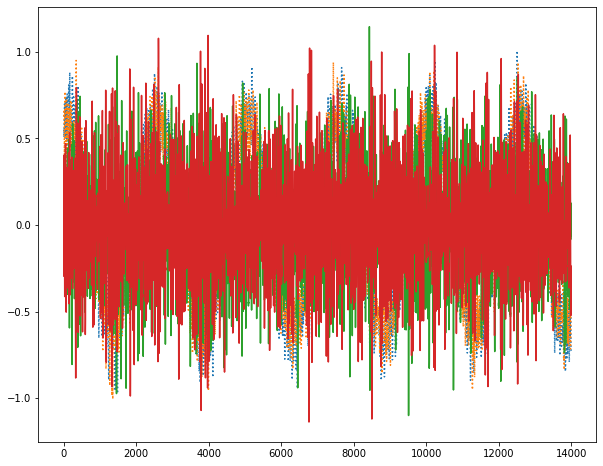

 46%|████▌     | 11/24 [00:00<00:00, 108.74it/s]

Epoch 1


100%|██████████| 24/24 [00:00<00:00, 103.95it/s]


Epoch 1 , mean error: 0.17327563 params: [DeviceArray([[12679.007  ,  -365.48926],
             [  304.4542 ,  7363.422  ]], dtype=float32), DeviceArray([[ 62.579887,  89.06546 ],
             [-57.419693,  41.643806]], dtype=float32)]


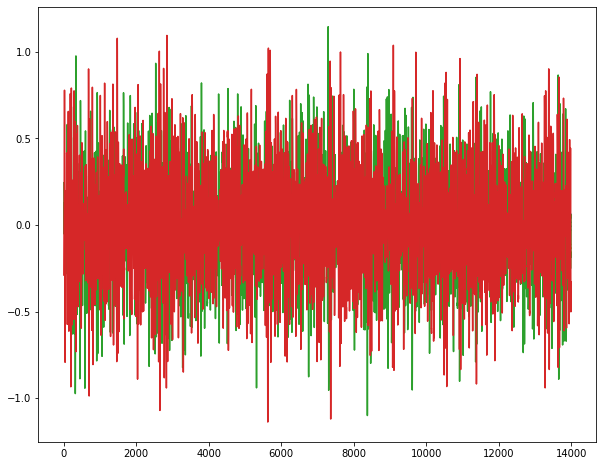

 38%|███▊      | 9/24 [00:00<00:00, 87.38it/s]

Epoch 2


100%|██████████| 24/24 [00:00<00:00, 99.00it/s]


Epoch 2 , mean error: 0.101919405 params: [DeviceArray([[11902.1    ,  -358.19702],
             [  347.39243,  7753.3525 ]], dtype=float32), DeviceArray([[ 50.64792 , -14.329547],
             [ 10.819392,  36.479855]], dtype=float32)]


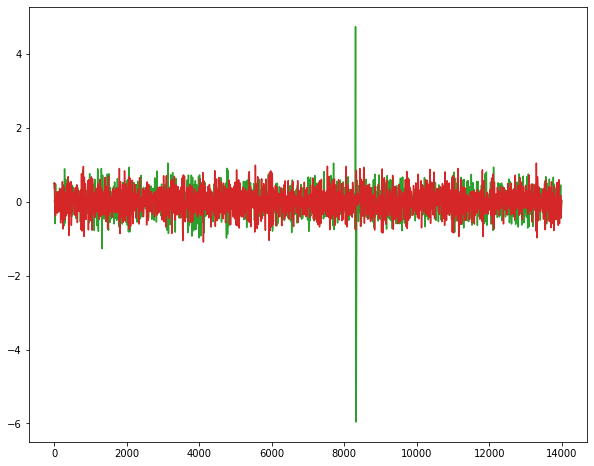

 46%|████▌     | 11/24 [00:00<00:00, 107.07it/s]

Epoch 3


100%|██████████| 24/24 [00:00<00:00, 110.41it/s]


Epoch 3 , mean error: 0.09685236 params: [DeviceArray([[11815.04   ,  -358.7802 ],
             [  371.10004,  7852.8823 ]], dtype=float32), DeviceArray([[57.916454 , -2.1863704],
             [ 6.5157075, 64.35789  ]], dtype=float32)]


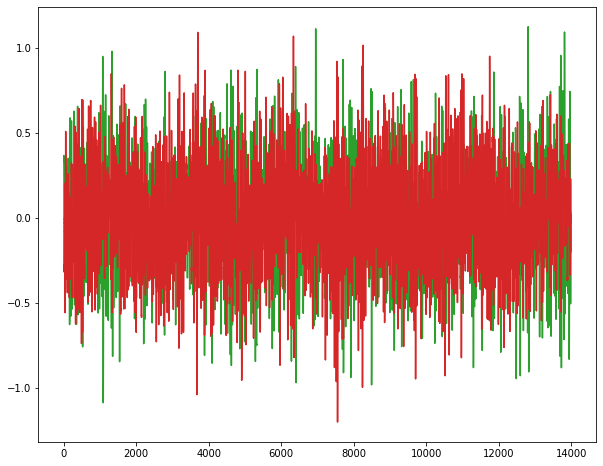

100%|██████████| 24/24 [00:00<00:00, 146.29it/s]

Epoch 4
Epoch 4 , mean error: 0.09638714 params: [DeviceArray([[11878.118 ,  -348.2962],
             [  375.0857,  7875.5215]], dtype=float32), DeviceArray([[60.602173,  2.213099],
             [ 5.628192, 59.450314]], dtype=float32)]


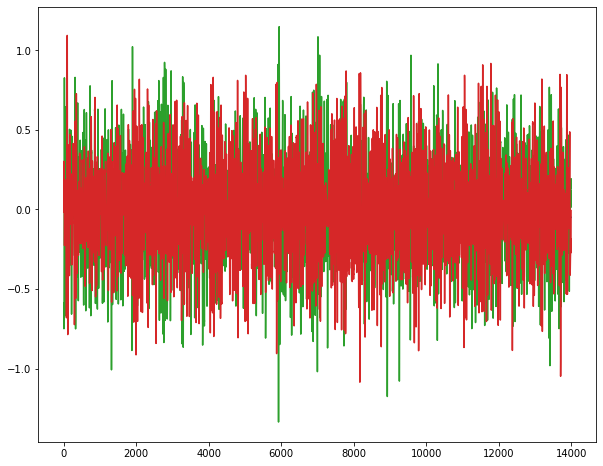

100%|██████████| 24/24 [00:00<00:00, 149.30it/s]

Epoch 5
Epoch 5 , mean error: 0.096372105 params: [DeviceArray([[11886.807  ,  -345.49878],
             [  372.5155 ,  7879.102  ]], dtype=float32), DeviceArray([[61.00445   , -0.15473032],
             [ 6.028794  , 57.803356  ]], dtype=float32)]


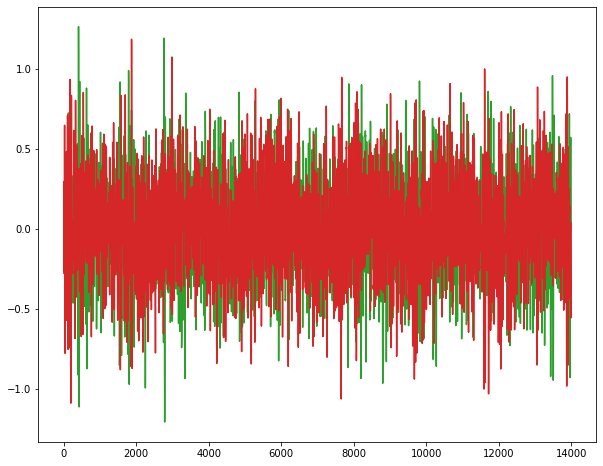

100%|██████████| 24/24 [00:00<00:00, 154.33it/s]

Epoch 6
Epoch 6 , mean error: 0.09636965 params: [DeviceArray([[11882.833  ,  -346.30157],
             [  371.92706,  7878.851  ]], dtype=float32), DeviceArray([[60.485107  ,  0.25213993],
             [ 5.955807  , 58.265163  ]], dtype=float32)]


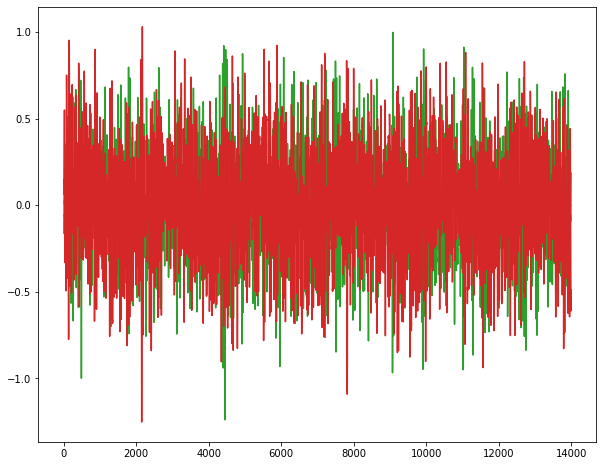

  4%|▍         | 1/24 [00:00<00:02,  8.86it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 94.78it/s]


Epoch 0 , mean error: 1.6613741 params: [DeviceArray([[5853.5107  ,  459.98032 ],
             [ -41.050636, 5749.0654  ]], dtype=float32), DeviceArray([[ 292.14417, -227.73228],
             [ 250.72864,  273.93823]], dtype=float32)]


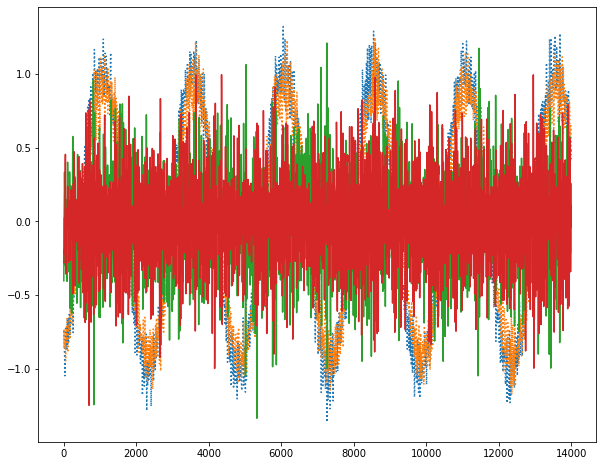

100%|██████████| 24/24 [00:00<00:00, 182.82it/s]

Epoch 1
Epoch 1 , mean error: 0.22628732 params: [DeviceArray([[7.0733315e+03, 4.8630066e+00],
             [2.2133362e+01, 6.9701602e+03]], dtype=float32), DeviceArray([[-57.32535,  83.6048 ],
             [-89.53372, -62.80094]], dtype=float32)]


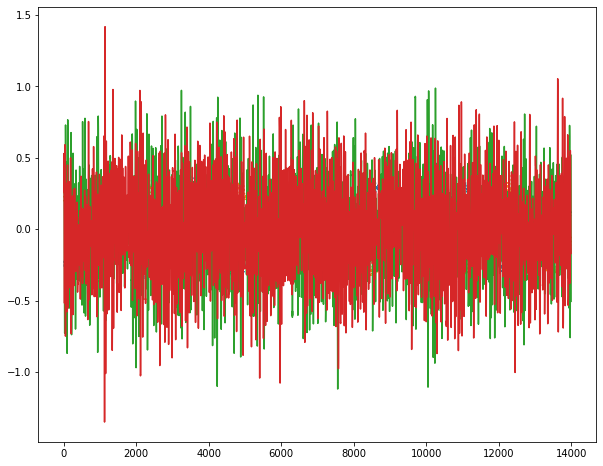

100%|██████████| 24/24 [00:00<00:00, 162.55it/s]

Epoch 2
Epoch 2 , mean error: 0.10559106 params: [DeviceArray([[7405.7383 , -110.72167],
             [ -46.57004, 7327.028  ]], dtype=float32), DeviceArray([[ 29.049852, -20.436733],
             [ 16.166313,  34.92258 ]], dtype=float32)]


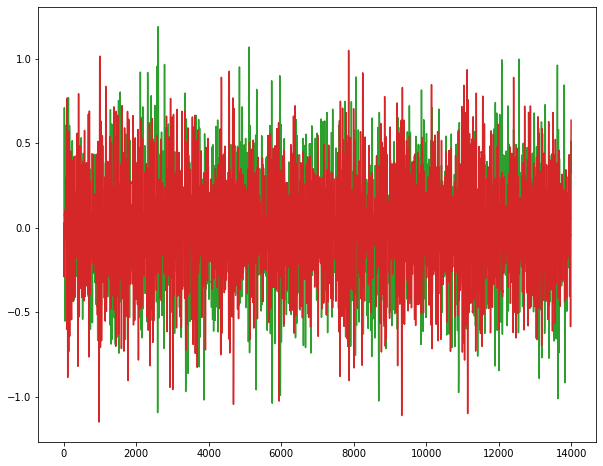

100%|██████████| 24/24 [00:00<00:00, 171.83it/s]

Epoch 3
Epoch 3 , mean error: 0.09544251 params: [DeviceArray([[7513.504   ,  -72.061966],
             [ -22.100357, 7434.807   ]], dtype=float32), DeviceArray([[22.899853 ,  2.8242807],
             [-5.3366046, 19.75897  ]], dtype=float32)]


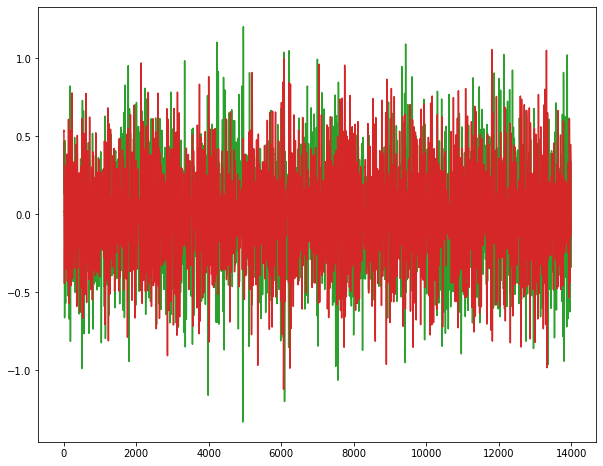

100%|██████████| 24/24 [00:00<00:00, 179.81it/s]

Epoch 4
Epoch 4 , mean error: 0.09490442 params: [DeviceArray([[7543.2256  ,  -61.517586],
             [ -31.39785 , 7463.031   ]], dtype=float32), DeviceArray([[17.918344 ,  1.4178855],
             [-4.674137 , 17.758533 ]], dtype=float32)]


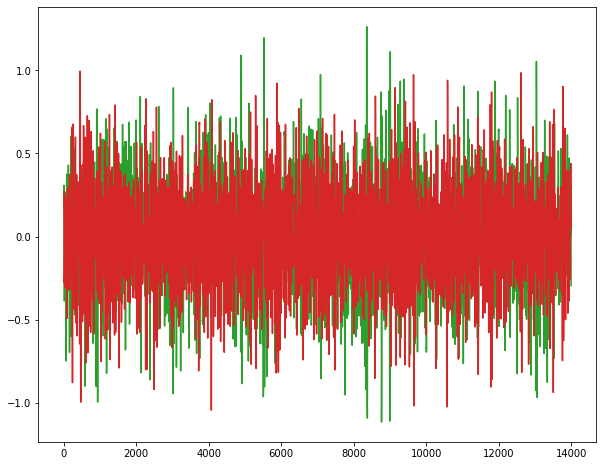

100%|██████████| 24/24 [00:00<00:00, 179.63it/s]

Epoch 5
Epoch 5 , mean error: 0.09484869 params: [DeviceArray([[7552.542   ,  -60.299347],
             [ -31.009422, 7470.8096  ]], dtype=float32), DeviceArray([[20.024729  ,  0.24470448],
             [-3.2163348 , 19.830853  ]], dtype=float32)]


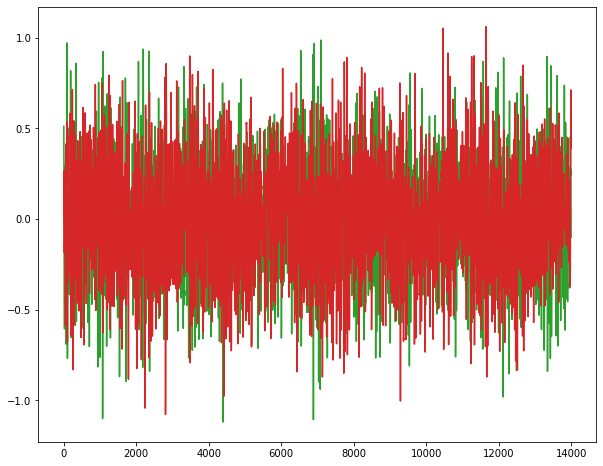

100%|██████████| 24/24 [00:00<00:00, 179.19it/s]

Epoch 6
Epoch 6 , mean error: 0.094832785 params: [DeviceArray([[7556.4194  ,  -59.097977],
             [ -32.466362, 7472.8257  ]], dtype=float32), DeviceArray([[19.759516 ,  1.0831771],
             [-3.946586 , 19.317537 ]], dtype=float32)]


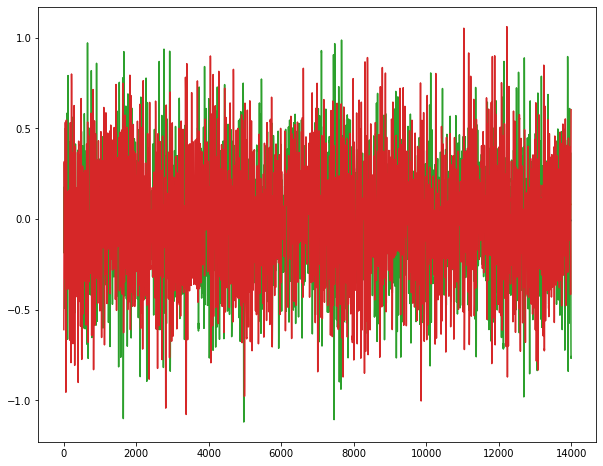

  4%|▍         | 1/24 [00:00<00:02,  8.58it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 93.40it/s]


Epoch 0 , mean error: 6.859693 params: [DeviceArray([[12040.698  ,   355.1147 ],
             [  402.15677,  6170.198  ]], dtype=float32), DeviceArray([[ 274.13904, -270.2766 ],
             [ 260.00943,  360.4308 ]], dtype=float32)]


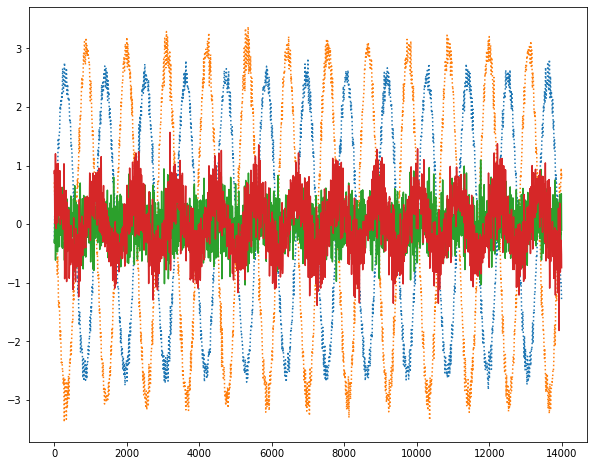

100%|██████████| 24/24 [00:00<00:00, 165.58it/s]

Epoch 1
Epoch 1 , mean error: 0.70337504 params: [DeviceArray([[12653.252  ,  -487.18222],
             [  543.9864 ,  7431.049  ]], dtype=float32), DeviceArray([[ 83.585   ,  99.989456],
             [-44.8304  ,  15.437714]], dtype=float32)]


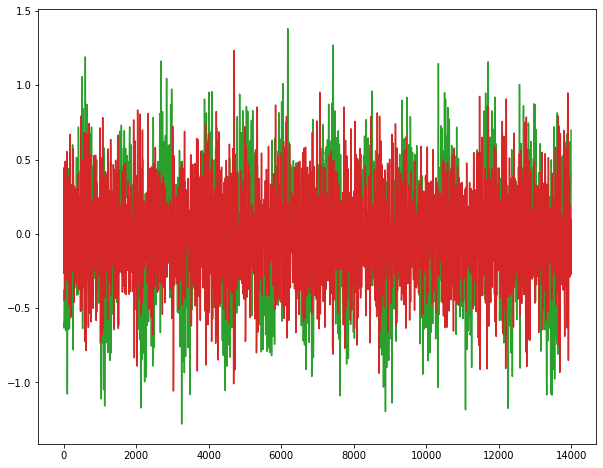

100%|██████████| 24/24 [00:00<00:00, 170.14it/s]

Epoch 2
Epoch 2 , mean error: 0.15343976 params: [DeviceArray([[11750.822  ,  -428.69916],
             [  420.6735 ,  7816.2495 ]], dtype=float32), DeviceArray([[ 76.112495, -18.827286],
             [ -8.248377,  48.174614]], dtype=float32)]


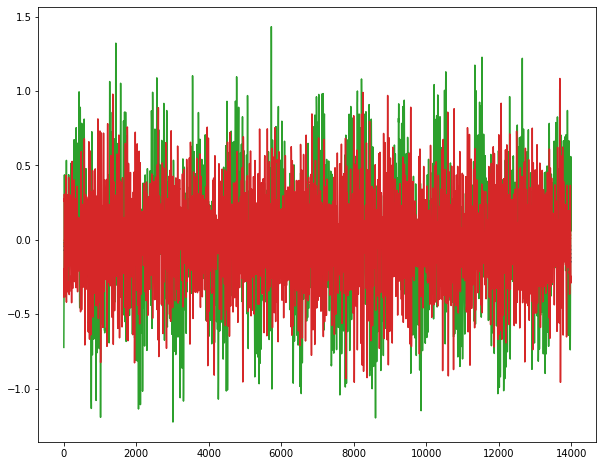

100%|██████████| 24/24 [00:00<00:00, 152.08it/s]

Epoch 3
Epoch 3 , mean error: 0.11296731 params: [DeviceArray([[11807.339  ,  -381.66962],
             [  372.39548,  7913.9263 ]], dtype=float32), DeviceArray([[64.469406 ,  2.9562755],
             [ 4.719755 , 67.682434 ]], dtype=float32)]


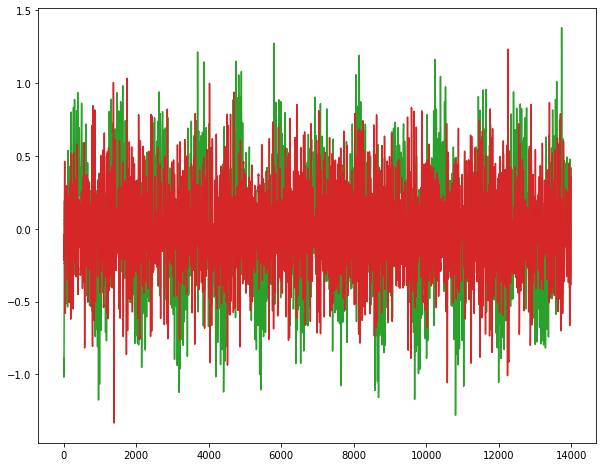

100%|██████████| 24/24 [00:00<00:00, 171.02it/s]

Epoch 4
Epoch 4 , mean error: 0.10944568 params: [DeviceArray([[11871.236  ,  -411.84714],
             [  380.19763,  7926.517  ]], dtype=float32), DeviceArray([[65.746254 ,  2.6914468],
             [-0.3126809, 60.16599  ]], dtype=float32)]


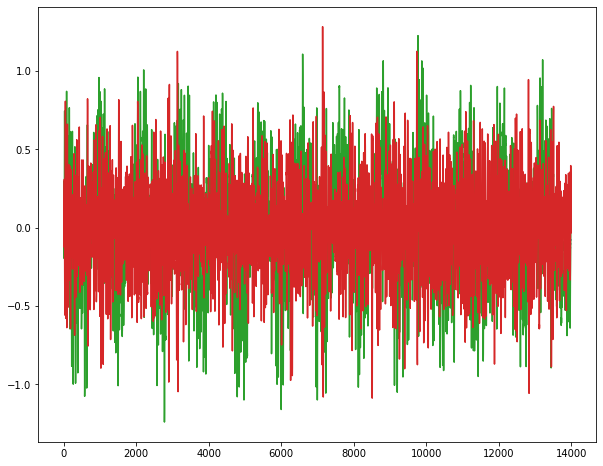

100%|██████████| 24/24 [00:00<00:00, 181.24it/s]

Epoch 5
Epoch 5 , mean error: 0.10920158 params: [DeviceArray([[11859.696  ,  -402.4443 ],
             [  383.58398,  7926.595  ]], dtype=float32), DeviceArray([[67.547295 ,  1.0117258],
             [-1.0161495, 60.12778  ]], dtype=float32)]


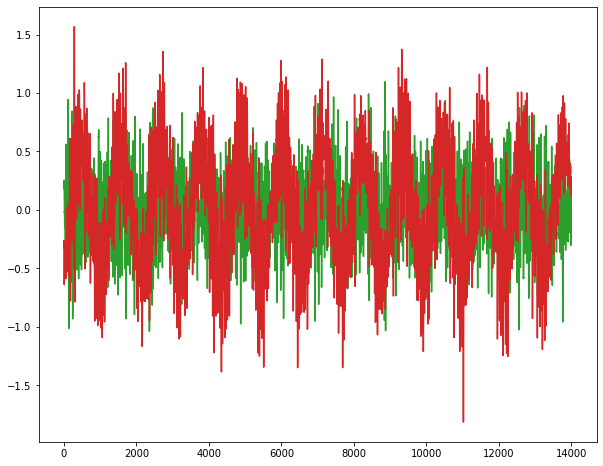

100%|██████████| 24/24 [00:00<00:00, 167.36it/s]

Epoch 6
Epoch 6 , mean error: 0.10926083 params: [DeviceArray([[11855.422  ,  -403.33566],
             [  385.69617,  7925.957  ]], dtype=float32), DeviceArray([[68.230896 ,  1.770596 ],
             [-0.5544048, 60.693127 ]], dtype=float32)]


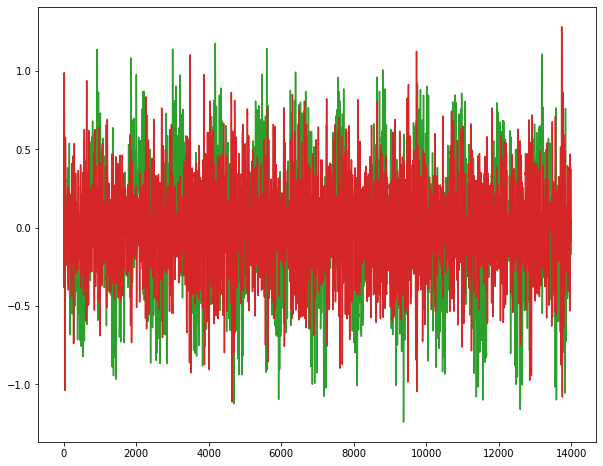

  4%|▍         | 1/24 [00:00<00:02,  8.32it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 95.45it/s]


Epoch 0 , mean error: 17.944197 params: [DeviceArray([[5721.4766  ,  125.841324],
             [-611.86847 , 5821.1553  ]], dtype=float32), DeviceArray([[ 291.11795, -261.29675],
             [-251.34644,  297.17416]], dtype=float32)]


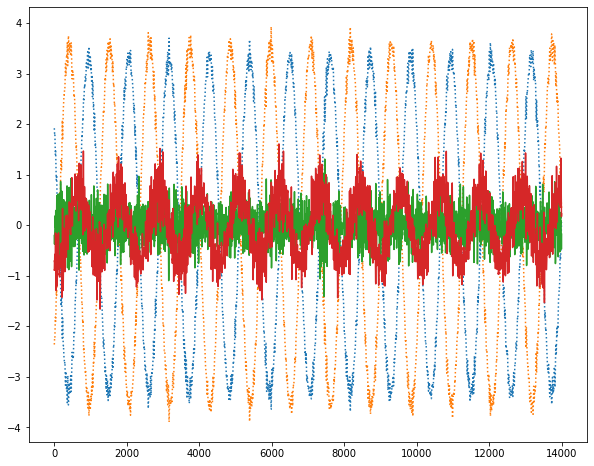

100%|██████████| 24/24 [00:00<00:00, 136.80it/s]

Epoch 1
Epoch 1 , mean error: 1.6529374 params: [DeviceArray([[6993.46    ,   36.745132],
             [-309.48773 , 7088.0996  ]], dtype=float32), DeviceArray([[-63.682728,  80.658905],
             [ 85.61348 , -47.147835]], dtype=float32)]


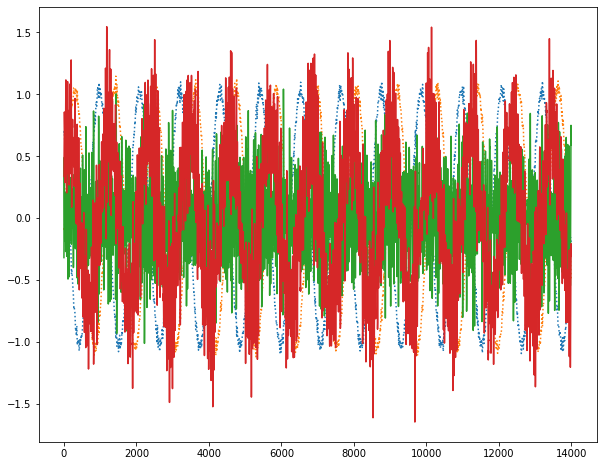

100%|██████████| 24/24 [00:00<00:00, 129.20it/s]

Epoch 2
Epoch 2 , mean error: 0.2401948 params: [DeviceArray([[ 7.3650596e+03,  1.0097606e+00],
             [-1.0900686e+02,  7.3864590e+03]], dtype=float32), DeviceArray([[ 31.198284, -11.07383 ],
             [-20.996351,  18.62557 ]], dtype=float32)]


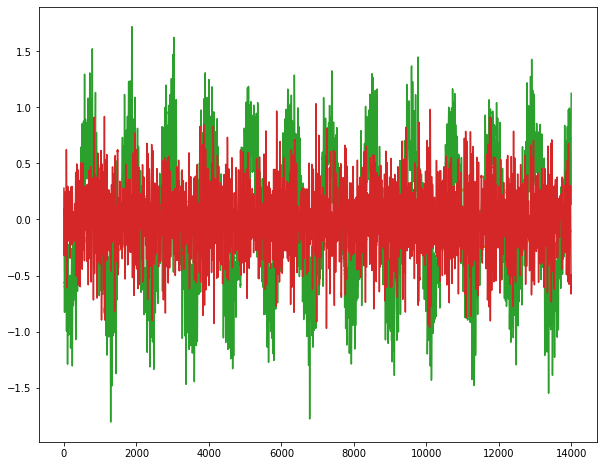

100%|██████████| 24/24 [00:00<00:00, 142.08it/s]

Epoch 3
Epoch 3 , mean error: 0.13387252 params: [DeviceArray([[ 7.4654678e+03, -5.3656597e+00],
             [-9.3484749e+01,  7.4847119e+03]], dtype=float32), DeviceArray([[20.322998 , -1.5034013],
             [ 1.5303614, 24.196083 ]], dtype=float32)]


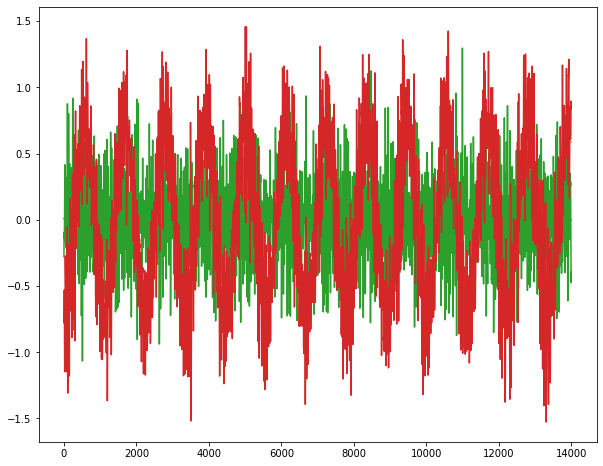

100%|██████████| 24/24 [00:00<00:00, 163.25it/s]

Epoch 4
Epoch 4 , mean error: 0.1257826 params: [DeviceArray([[7495.027   ,   10.315921],
             [ -83.63872 , 7513.131   ]], dtype=float32), DeviceArray([[16.83374  ,  2.5441854],
             [ 0.3270073, 16.970716 ]], dtype=float32)]


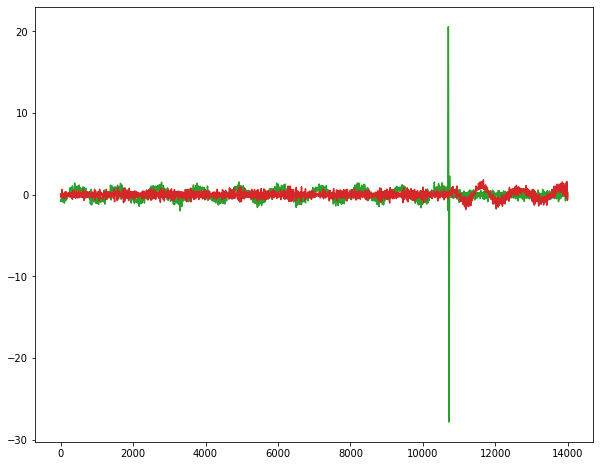

100%|██████████| 24/24 [00:00<00:00, 156.40it/s]

Epoch 5
Epoch 5 , mean error: 0.12499646 params: [DeviceArray([[ 7.5027344e+03,  3.3221865e+00],
             [-8.0743057e+01,  7.5198286e+03]], dtype=float32), DeviceArray([[19.216583  ,  0.32112157],
             [-1.1126907 , 18.378868  ]], dtype=float32)]


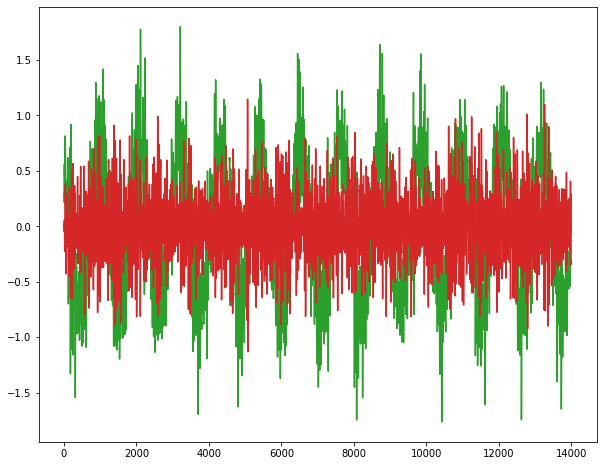

100%|██████████| 24/24 [00:00<00:00, 161.05it/s]

Epoch 6
Epoch 6 , mean error: 0.12500378 params: [DeviceArray([[ 7.5047466e+03,  6.4088621e+00],
             [-8.0465599e+01,  7.5218413e+03]], dtype=float32), DeviceArray([[18.951916  ,  0.6365175 ],
             [-0.44965518, 18.64373   ]], dtype=float32)]


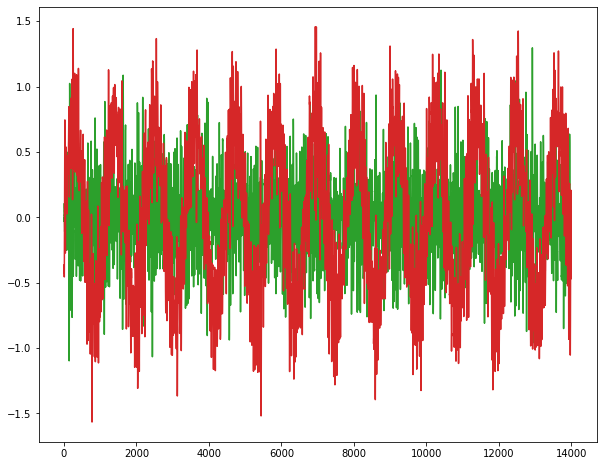

  4%|▍         | 1/24 [00:00<00:02,  8.68it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 90.97it/s]


Epoch 0 , mean error: 22.042154 params: [DeviceArray([[14363.827 ,  -719.3351],
             [ -539.1374,  7740.26  ]], dtype=float32), DeviceArray([[ 278.0083 , -294.3814 ],
             [ 235.05023,  364.31656]], dtype=float32)]


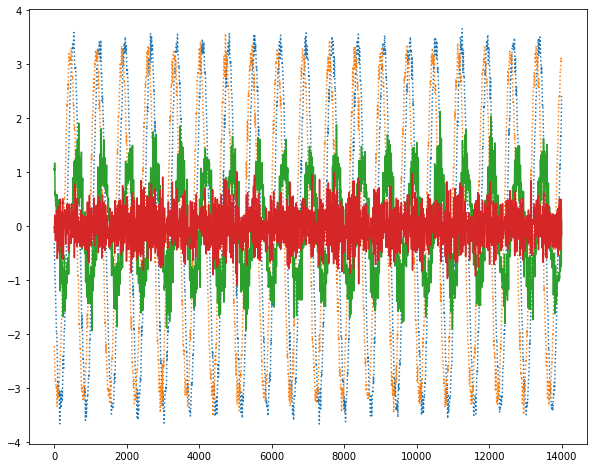

100%|██████████| 24/24 [00:00<00:00, 177.36it/s]

Epoch 1
Epoch 1 , mean error: 2.0318606 params: [DeviceArray([[11362.831  ,  -503.35663],
             [  536.8203 ,  8461.004  ]], dtype=float32), DeviceArray([[ 71.72546,  87.63397],
             [-32.80336,  27.59569]], dtype=float32)]


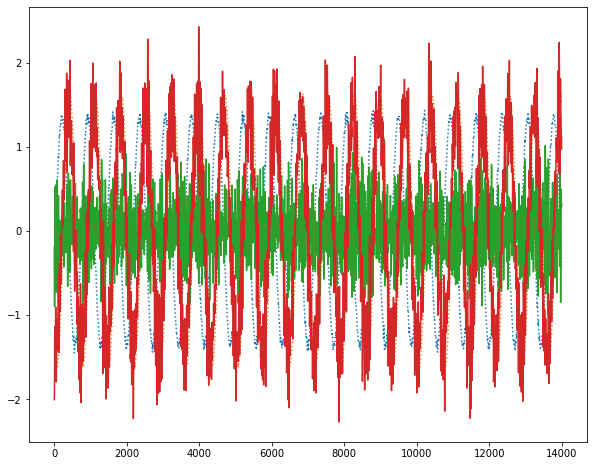

100%|██████████| 24/24 [00:00<00:00, 167.85it/s]

Epoch 2
Epoch 2 , mean error: 0.3614203 params: [DeviceArray([[11891.229  ,  -396.17004],
             [  502.14117,  7944.5835 ]], dtype=float32), DeviceArray([[ 73.79901  ,  -2.2779007],
             [-14.461074 ,  46.675285 ]], dtype=float32)]


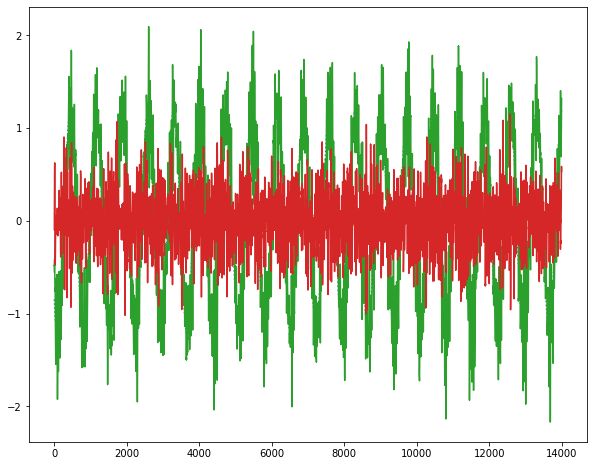

100%|██████████| 24/24 [00:00<00:00, 173.56it/s]

Epoch 3
Epoch 3 , mean error: 0.24111177 params: [DeviceArray([[11873.547  ,  -447.68243],
             [  404.2612 ,  7924.824  ]], dtype=float32), DeviceArray([[67.62505  , -2.9394433],
             [ 3.6322021, 68.63979  ]], dtype=float32)]


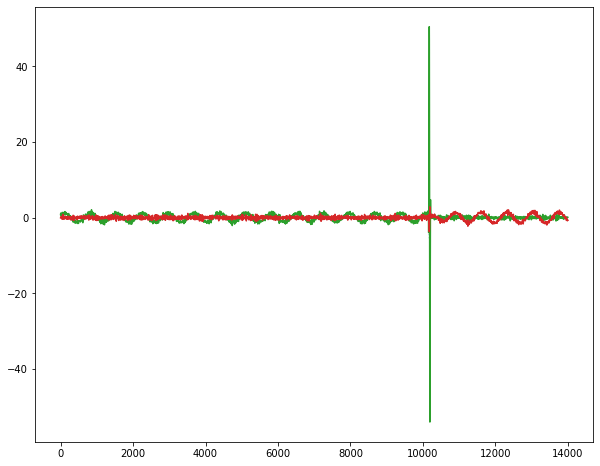

100%|██████████| 24/24 [00:00<00:00, 169.55it/s]

Epoch 4
Epoch 4 , mean error: 0.23247997 params: [DeviceArray([[11839.322  ,  -457.43228],
             [  434.1408 ,  7961.1265 ]], dtype=float32), DeviceArray([[65.298065  ,  4.131823  ],
             [-0.16224802, 62.43564   ]], dtype=float32)]


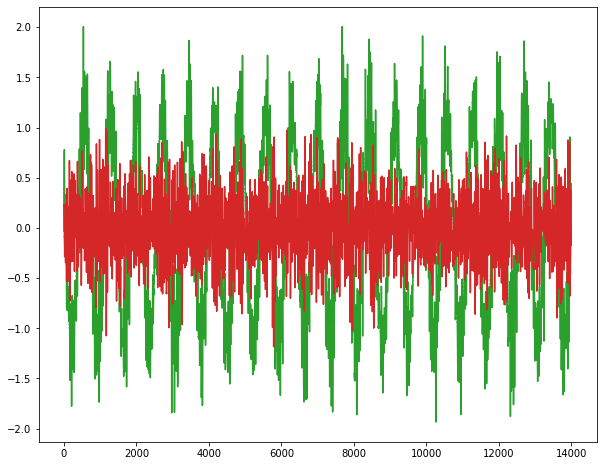

100%|██████████| 24/24 [00:00<00:00, 150.21it/s]

Epoch 5
Epoch 5 , mean error: 0.23123269 params: [DeviceArray([[11856.183  ,  -456.2202 ],
             [  435.06055,  7962.436  ]], dtype=float32), DeviceArray([[67.05022  ,  2.0742006],
             [-1.7072824, 61.925465 ]], dtype=float32)]


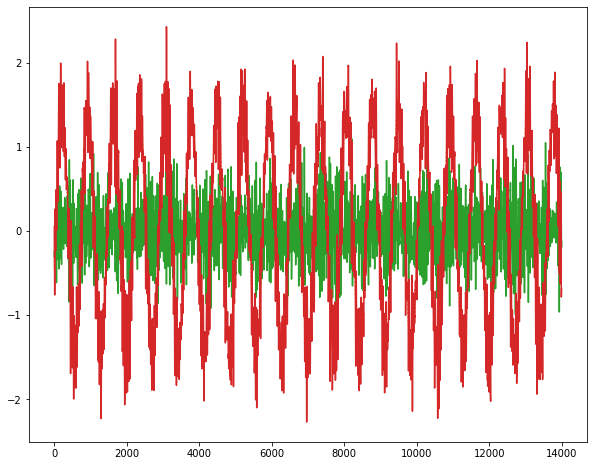

100%|██████████| 24/24 [00:00<00:00, 166.06it/s]

Epoch 6
Epoch 6 , mean error: 0.23111725 params: [DeviceArray([[11849.567  ,  -455.20206],
             [  433.08975,  7960.92   ]], dtype=float32), DeviceArray([[68.25805  ,  2.4050412],
             [-1.1004677, 62.286488 ]], dtype=float32)]


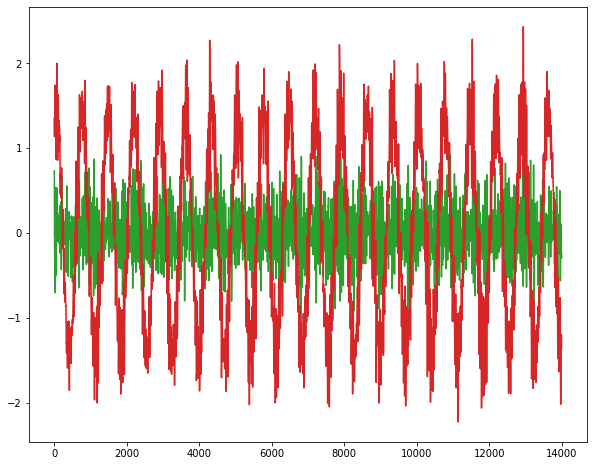

  4%|▍         | 1/24 [00:00<00:04,  5.09it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 73.37it/s]


Epoch 0 , mean error: 306.752 params: [DeviceArray([[6097.526 ,  280.4536],
             [ 705.6986, 5646.094 ]], dtype=float32), DeviceArray([[ 289.44543, -249.94756],
             [-259.72626,  286.98895]], dtype=float32)]


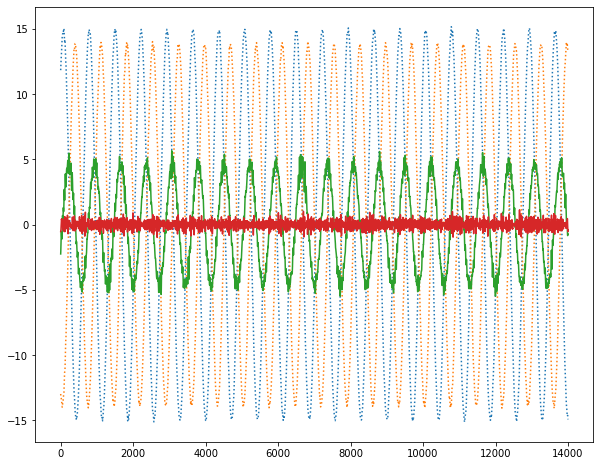

100%|██████████| 24/24 [00:00<00:00, 167.45it/s]

Epoch 1
Epoch 1 , mean error: 28.189432 params: [DeviceArray([[7.1142925e+03, 5.8822021e+00],
             [3.9245705e+01, 6.9352803e+03]], dtype=float32), DeviceArray([[-45.48785,  82.93276],
             [ 84.66436, -53.45308]], dtype=float32)]


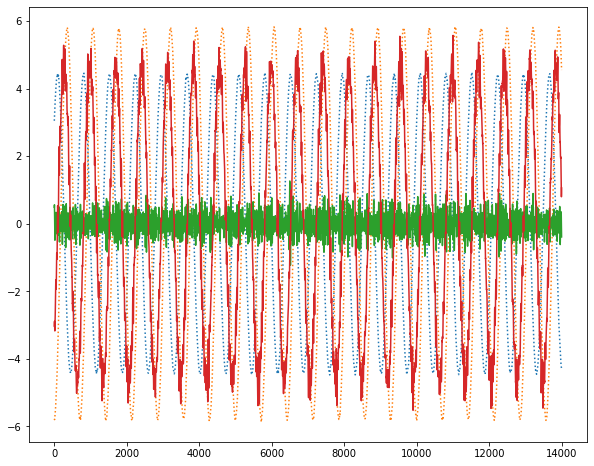

100%|██████████| 24/24 [00:00<00:00, 167.06it/s]

Epoch 2
Epoch 2 , mean error: 5.5679393 params: [DeviceArray([[7475.195   ,   20.947884],
             [ -21.516163, 7393.779   ]], dtype=float32), DeviceArray([[ 12.350418, -16.97845 ],
             [-17.594297,  24.141018]], dtype=float32)]


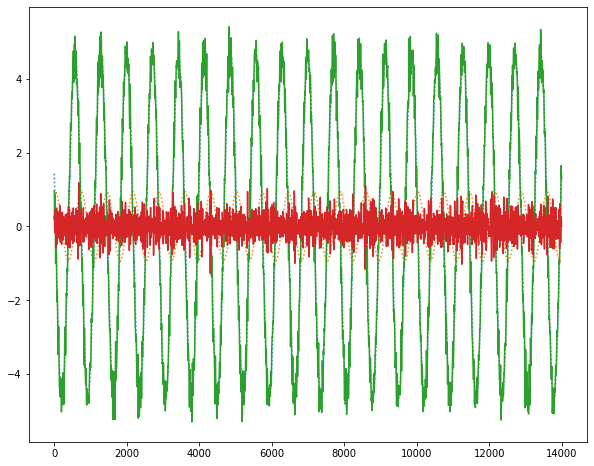

100%|██████████| 24/24 [00:00<00:00, 176.01it/s]

Epoch 3
Epoch 3 , mean error: 3.9176579 params: [DeviceArray([[7591.585   ,   17.420675],
             [ -15.532677, 7473.2217  ]], dtype=float32), DeviceArray([[20.896732  , -0.06217909],
             [ 1.0268316 , 23.124397  ]], dtype=float32)]


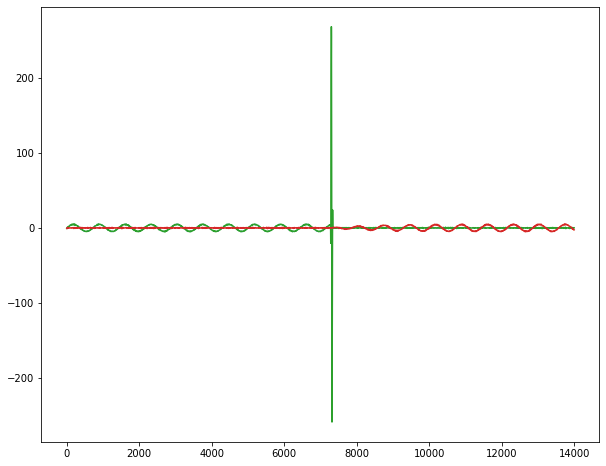

100%|██████████| 24/24 [00:00<00:00, 176.49it/s]

Epoch 4
Epoch 4 , mean error: 3.7046795 params: [DeviceArray([[7614.603   ,   -9.272489],
             [ -18.870285, 7493.626   ]], dtype=float32), DeviceArray([[13.434858 ,  1.2347374],
             [ 1.50887  , 16.975607 ]], dtype=float32)]


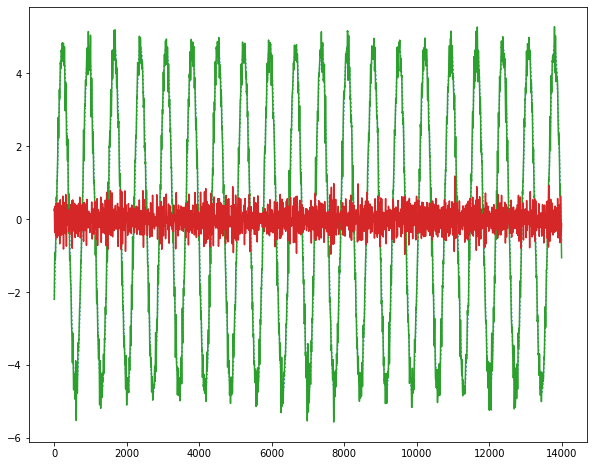

100%|██████████| 24/24 [00:00<00:00, 181.11it/s]

Epoch 5
Epoch 5 , mean error: 3.7165577 params: [DeviceArray([[7620.4907  ,   -8.950033],
             [ -13.47131 , 7498.449   ]], dtype=float32), DeviceArray([[14.160559 , -0.7262937],
             [-0.2808116, 18.886711 ]], dtype=float32)]


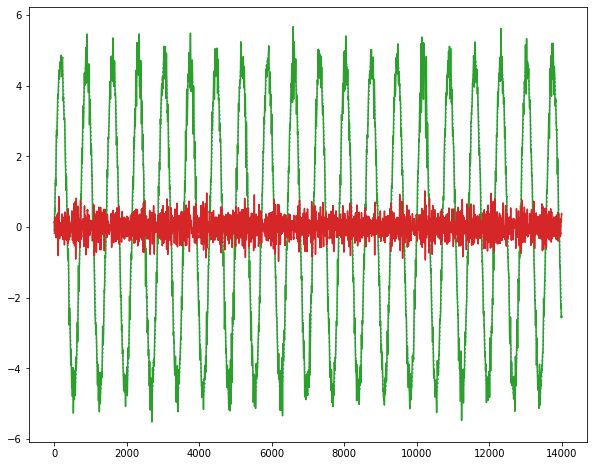

100%|██████████| 24/24 [00:00<00:00, 176.45it/s]

Epoch 6
Epoch 6 , mean error: 3.7219665 params: [DeviceArray([[7621.2095  ,   -9.85222 ],
             [ -11.654628, 7498.569   ]], dtype=float32), DeviceArray([[14.204635  , -0.17058757],
             [ 0.34042475, 18.908464  ]], dtype=float32)]


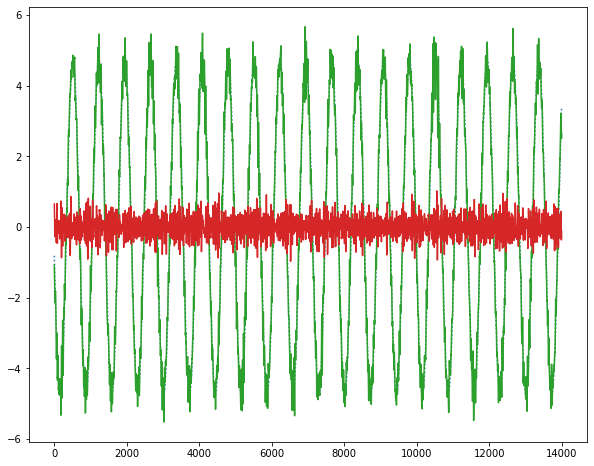

  4%|▍         | 1/24 [00:00<00:02,  8.29it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 94.31it/s]


Epoch 0 , mean error: 19.889551 params: [DeviceArray([[13079.047  ,  -322.15414],
             [  311.3131 ,  8894.85   ]], dtype=float32), DeviceArray([[ 303.6015 , -287.98468],
             [ 261.2036 ,  362.46985]], dtype=float32)]


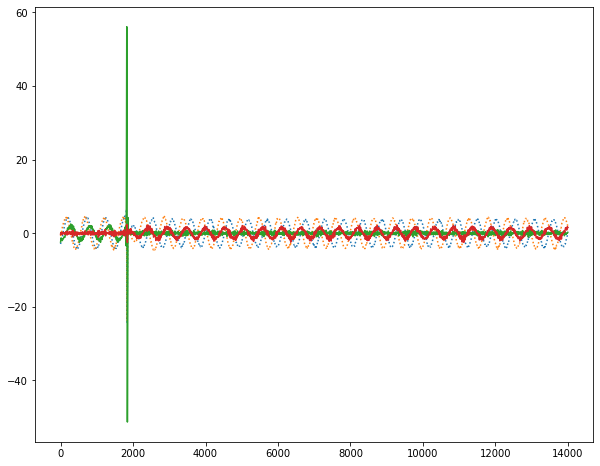

100%|██████████| 24/24 [00:00<00:00, 159.59it/s]

Epoch 1
Epoch 1 , mean error: 1.8670502 params: [DeviceArray([[12159.083  ,  -264.28207],
             [  400.07895,  8013.8833 ]], dtype=float32), DeviceArray([[ 84.67606 , 100.3692  ],
             [-57.041794,  23.754755]], dtype=float32)]


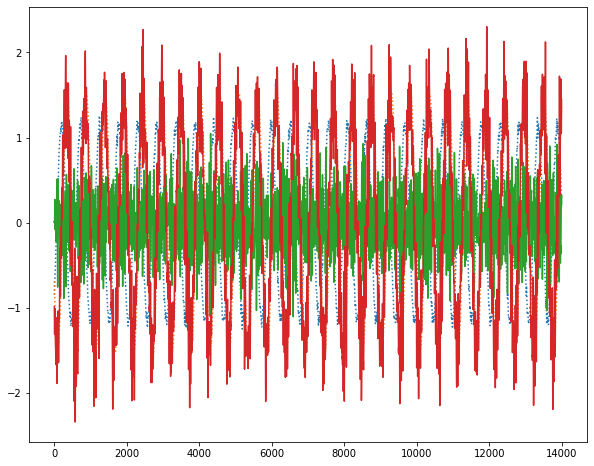

100%|██████████| 24/24 [00:00<00:00, 178.13it/s]

Epoch 2
Epoch 2 , mean error: 0.35972437 params: [DeviceArray([[11644.781  ,  -460.45026],
             [  462.53482,  7827.4517 ]], dtype=float32), DeviceArray([[ 55.059013 , -13.938185 ],
             [ -1.3251677,  44.241783 ]], dtype=float32)]


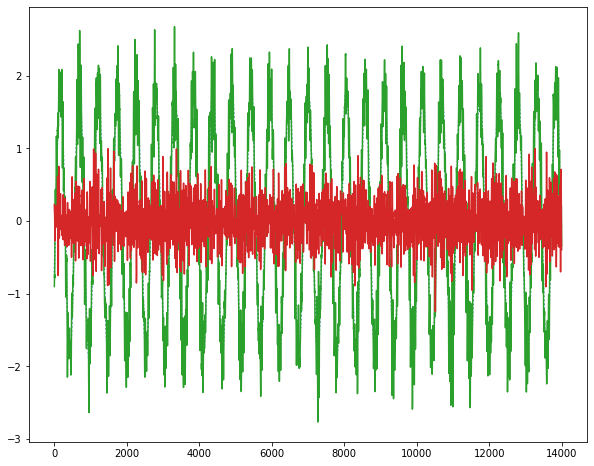

100%|██████████| 24/24 [00:00<00:00, 153.46it/s]

Epoch 3
Epoch 3 , mean error: 0.24695408 params: [DeviceArray([[11860.426  ,  -420.2419 ],
             [  421.63965,  7940.796  ]], dtype=float32), DeviceArray([[59.066425, -5.040296],
             [ 4.193521, 70.27498 ]], dtype=float32)]


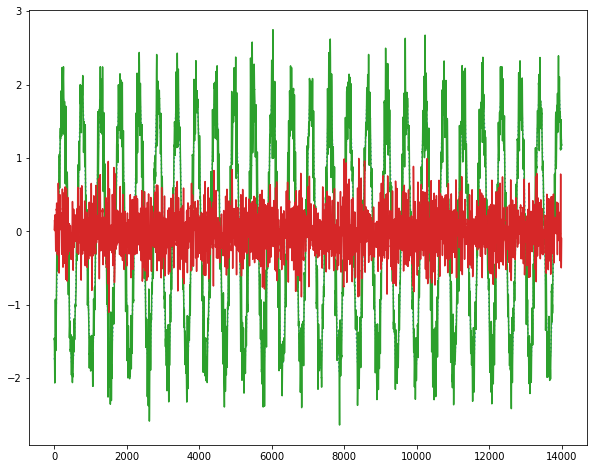

100%|██████████| 24/24 [00:00<00:00, 157.20it/s]

Epoch 4
Epoch 4 , mean error: 0.23867543 params: [DeviceArray([[11834.511  ,  -409.1171 ],
             [  430.35477,  7911.867  ]], dtype=float32), DeviceArray([[62.372677 ,  1.7091144],
             [-0.5055506, 61.031322 ]], dtype=float32)]


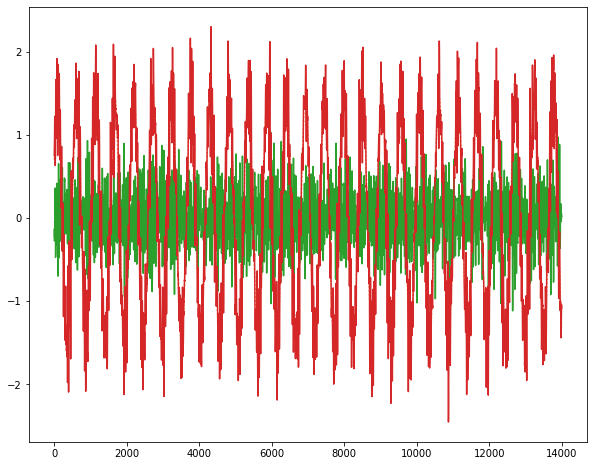

100%|██████████| 24/24 [00:00<00:00, 144.19it/s]

Epoch 5
Epoch 5 , mean error: 0.238119 params: [DeviceArray([[11822.191 ,  -415.4457],
             [  432.6537,  7915.76  ]], dtype=float32), DeviceArray([[63.43694   , -0.89700353],
             [-0.182259  , 60.802555  ]], dtype=float32)]


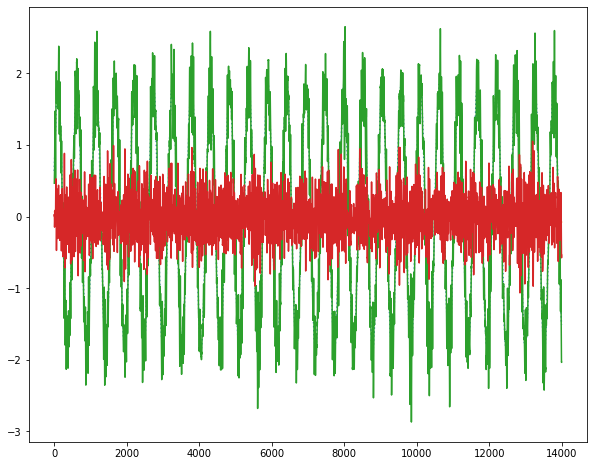

100%|██████████| 24/24 [00:00<00:00, 157.24it/s]

Epoch 6
Epoch 6 , mean error: 0.23808403 params: [DeviceArray([[11825.8    ,  -414.11774],
             [  432.09705,  7916.225  ]], dtype=float32), DeviceArray([[ 6.3314919e+01, -6.0667765e-01],
             [ 3.1691462e-02,  6.1617741e+01]], dtype=float32)]


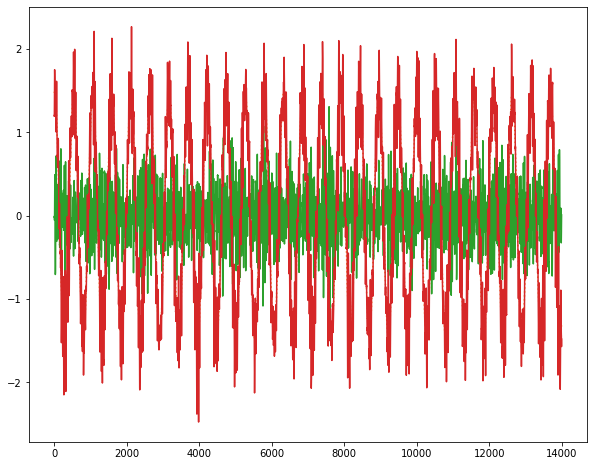

  4%|▍         | 1/24 [00:00<00:02,  8.37it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 92.44it/s]


Epoch 0 , mean error: 31.26546 params: [DeviceArray([[5176.9443 , -303.40717],
             [-278.2536 , 5272.9497 ]], dtype=float32), DeviceArray([[ 302.04962, -242.99727],
             [-263.2875 ,  283.67432]], dtype=float32)]


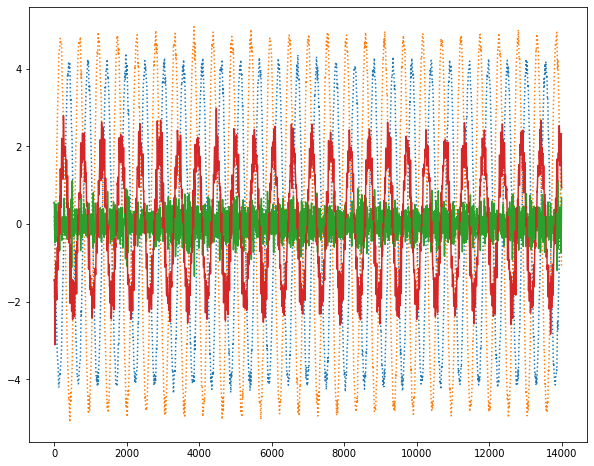

100%|██████████| 24/24 [00:00<00:00, 144.12it/s]

Epoch 1
Epoch 1 , mean error: 2.8330271 params: [DeviceArray([[6965.4775 , -192.70029],
             [ 212.7442 , 6876.277  ]], dtype=float32), DeviceArray([[-60.952168,  81.606155],
             [ 88.43147 , -56.673492]], dtype=float32)]


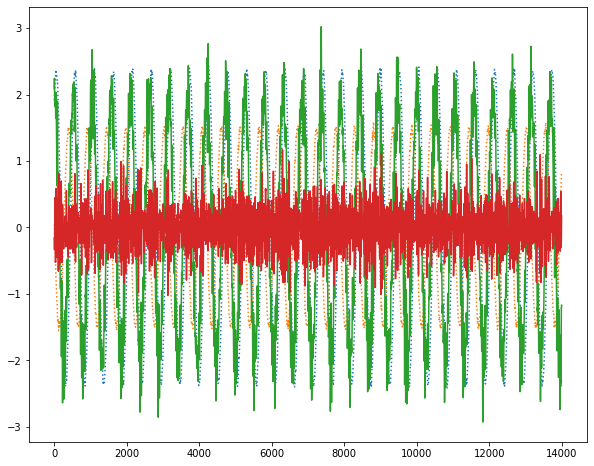

100%|██████████| 24/24 [00:00<00:00, 158.29it/s]

Epoch 2
Epoch 2 , mean error: 0.3205665 params: [DeviceArray([[7447.8184 ,  -77.59311],
             [-173.81354, 7309.506  ]], dtype=float32), DeviceArray([[ 29.756443, -18.379887],
             [-20.882221,  27.204884]], dtype=float32)]


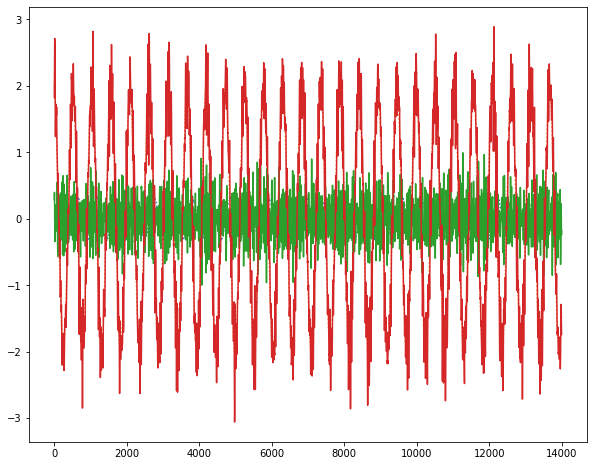

100%|██████████| 24/24 [00:00<00:00, 170.36it/s]

Epoch 3
Epoch 3 , mean error: 0.13212599 params: [DeviceArray([[7519.252   ,  -61.9649  ],
             [   9.615334, 7404.4863  ]], dtype=float32), DeviceArray([[22.669756  ,  0.44616413],
             [ 1.3628488 , 22.218252  ]], dtype=float32)]


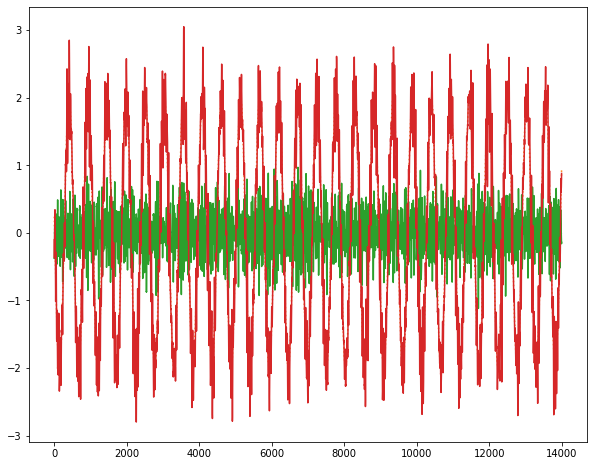

100%|██████████| 24/24 [00:00<00:00, 160.01it/s]

Epoch 4
Epoch 4 , mean error: 0.11783504 params: [DeviceArray([[7535.908   ,  -47.945248],
             [ -56.843254, 7441.609   ]], dtype=float32), DeviceArray([[17.779207 ,  0.7464982],
             [ 0.5706488, 17.03202  ]], dtype=float32)]


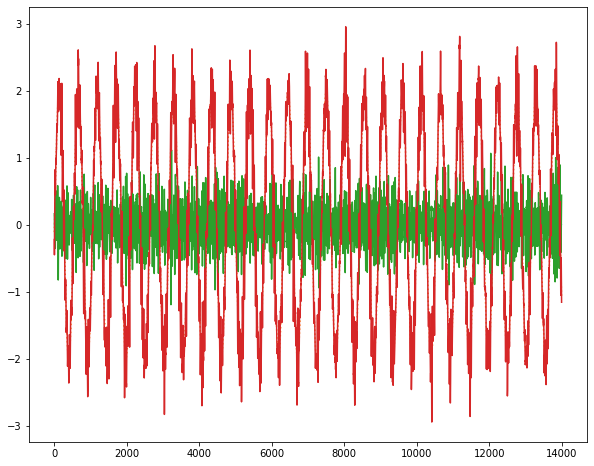

100%|██████████| 24/24 [00:00<00:00, 172.12it/s]

Epoch 5
Epoch 5 , mean error: 0.11660721 params: [DeviceArray([[7535.5996  ,  -46.261257],
             [ -39.371864, 7448.1577  ]], dtype=float32), DeviceArray([[20.078758  , -0.99249065],
             [-1.023224  , 19.206724  ]], dtype=float32)]


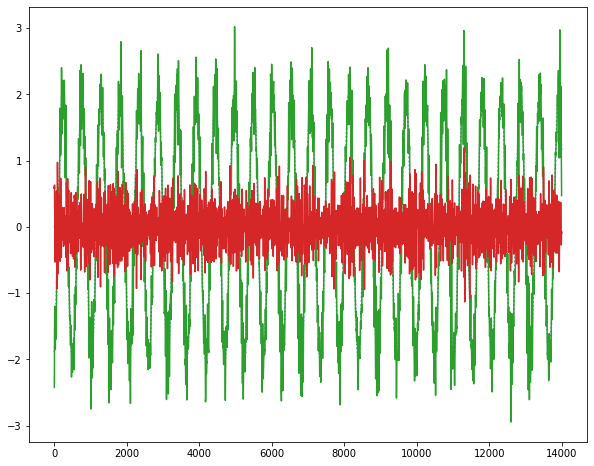

100%|██████████| 24/24 [00:00<00:00, 168.78it/s]

Epoch 6
Epoch 6 , mean error: 0.11658392 params: [DeviceArray([[7535.879   ,  -46.85238 ],
             [ -39.351345, 7448.7354  ]], dtype=float32), DeviceArray([[19.850307  , -0.37681594],
             [-0.37150958, 19.105492  ]], dtype=float32)]


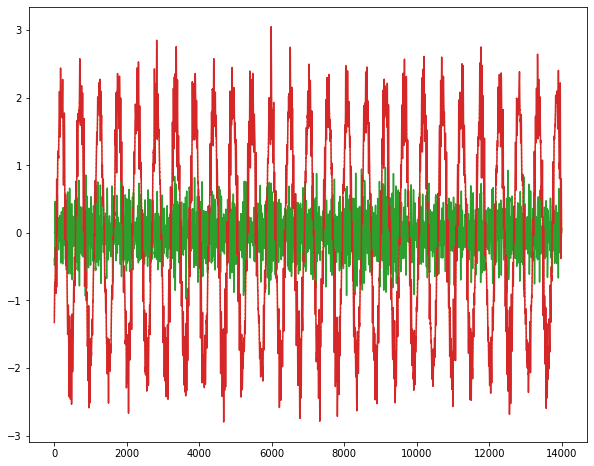

  4%|▍         | 1/24 [00:00<00:02,  8.24it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 90.37it/s]


Epoch 0 , mean error: 9.612493 params: [DeviceArray([[11843.991   ,  -761.44604 ],
             [   51.862762,  7202.893   ]], dtype=float32), DeviceArray([[ 321.5463 , -257.9721 ],
             [ 257.89337,  352.1452 ]], dtype=float32)]


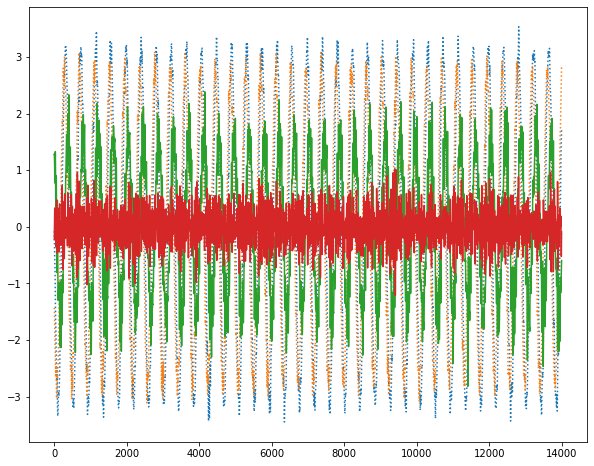

100%|██████████| 24/24 [00:00<00:00, 161.58it/s]

Epoch 1
Epoch 1 , mean error: 0.9121955 params: [DeviceArray([[12580.74  ,  -702.8973],
             [  335.3156,  8119.3813]], dtype=float32), DeviceArray([[ 70.20557 ,  97.01631 ],
             [-75.324165,  33.180084]], dtype=float32)]


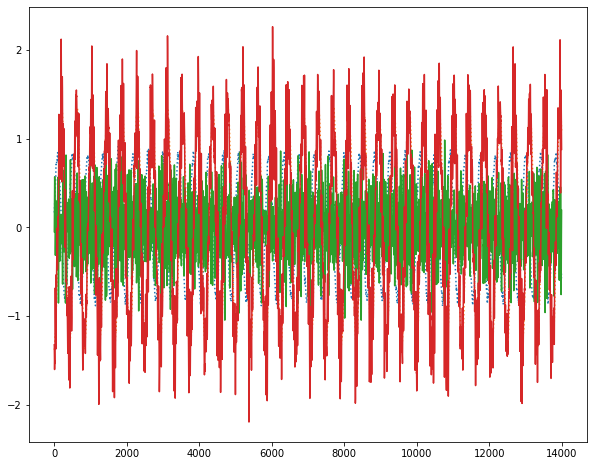

100%|██████████| 24/24 [00:00<00:00, 180.25it/s]

Epoch 2
Epoch 2 , mean error: 0.17795122 params: [DeviceArray([[11857.849 ,  -507.0961],
             [  520.597 ,  7934.5376]], dtype=float32), DeviceArray([[ 43.188778 , -20.978352 ],
             [  7.7764425,  40.29636  ]], dtype=float32)]


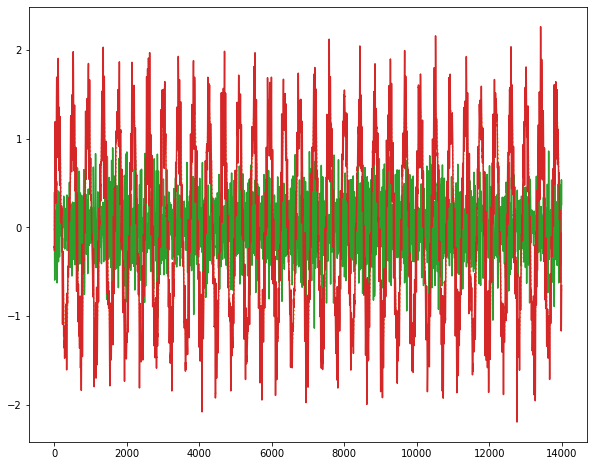

100%|██████████| 24/24 [00:00<00:00, 163.60it/s]

Epoch 3
Epoch 3 , mean error: 0.122003235 params: [DeviceArray([[11820.303  ,  -497.12033],
             [  533.43207,  7863.753  ]], dtype=float32), DeviceArray([[60.547913 ,  4.334321 ],
             [ 1.6045728, 66.60906  ]], dtype=float32)]


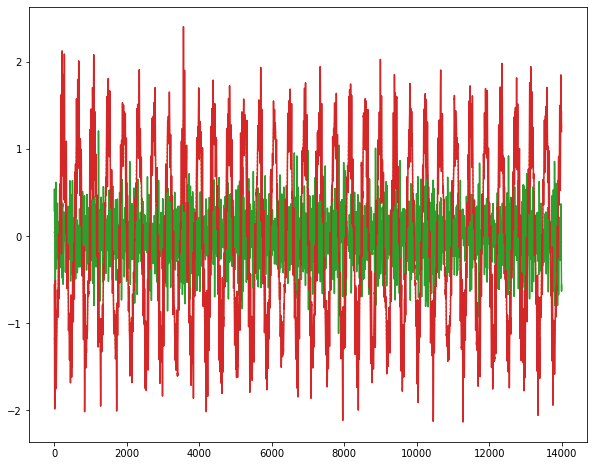

100%|██████████| 24/24 [00:00<00:00, 161.04it/s]

Epoch 4
Epoch 4 , mean error: 0.11787602 params: [DeviceArray([[11876.554  ,  -482.02515],
             [  545.4082 ,  7871.341  ]], dtype=float32), DeviceArray([[63.246784 ,  3.4332156],
             [-2.5405657, 60.517673 ]], dtype=float32)]


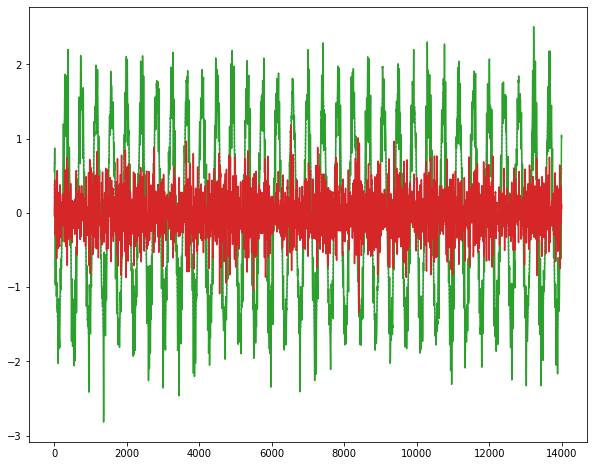

100%|██████████| 24/24 [00:00<00:00, 169.81it/s]

Epoch 5
Epoch 5 , mean error: 0.11756494 params: [DeviceArray([[11878.261  ,  -485.47046],
             [  544.69244,  7872.0293 ]], dtype=float32), DeviceArray([[62.057777 ,  1.8385738],
             [-0.8303029, 59.08955  ]], dtype=float32)]


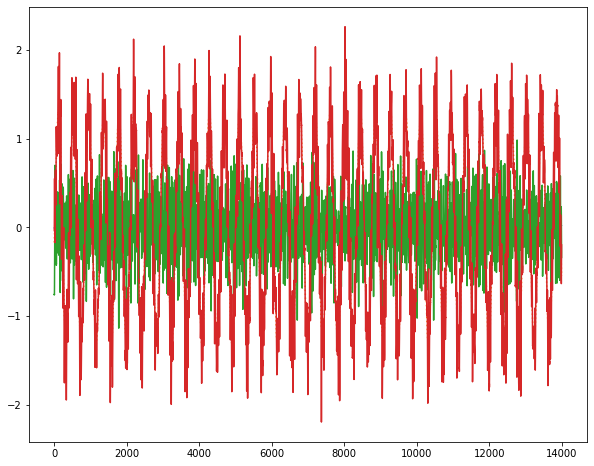

100%|██████████| 24/24 [00:00<00:00, 169.86it/s]

Epoch 6
Epoch 6 , mean error: 0.11749652 params: [DeviceArray([[11874.783  ,  -489.24426],
             [  540.408  ,  7871.3706 ]], dtype=float32), DeviceArray([[61.599297 ,  2.585547 ],
             [-1.1009498, 59.67155  ]], dtype=float32)]


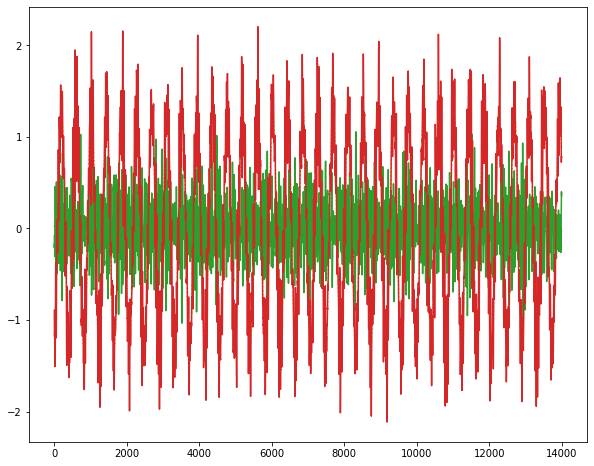

  4%|▍         | 1/24 [00:00<00:02,  8.40it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 89.72it/s]


Epoch 0 , mean error: 9.861955 params: [DeviceArray([[5630.8555,  767.3315],
             [-219.9821, 5498.431 ]], dtype=float32), DeviceArray([[ 286.7433 , -263.9699 ],
             [ 220.62857,  299.19232]], dtype=float32)]


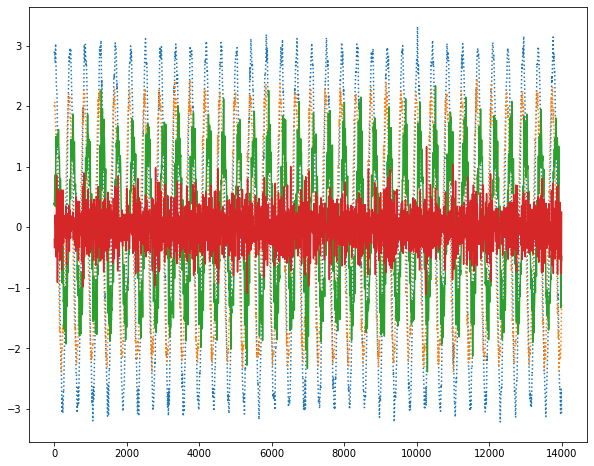

100%|██████████| 24/24 [00:00<00:00, 171.37it/s]

Epoch 1
Epoch 1 , mean error: 0.92589855 params: [DeviceArray([[ 6.9855332e+03, -1.9250183e+00],
             [-2.2045224e+02,  7.0661162e+03]], dtype=float32), DeviceArray([[-52.60836 ,  84.60254 ],
             [ 49.212894, -52.559677]], dtype=float32)]


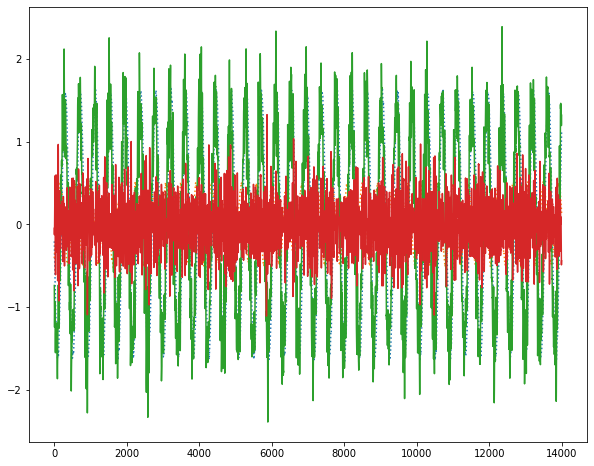

100%|██████████| 24/24 [00:00<00:00, 160.84it/s]

Epoch 2
Epoch 2 , mean error: 0.16124494 params: [DeviceArray([[7368.423  , -185.47539],
             [-244.4739 , 7471.554  ]], dtype=float32), DeviceArray([[ 17.416218, -14.117181],
             [-15.399176,  20.931011]], dtype=float32)]


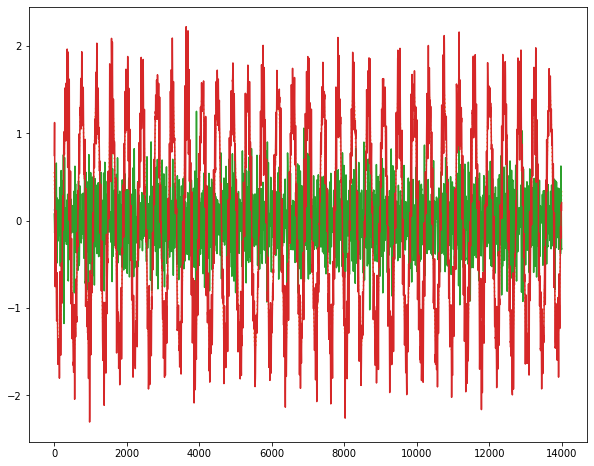

100%|██████████| 24/24 [00:00<00:00, 168.16it/s]

Epoch 3
Epoch 3 , mean error: 0.10106016 params: [DeviceArray([[ 7.4730405e+03,  1.2221489e+00],
             [-1.7851898e+02,  7.5739736e+03]], dtype=float32), DeviceArray([[20.838812  , -0.29321623],
             [-3.517691  , 23.39582   ]], dtype=float32)]


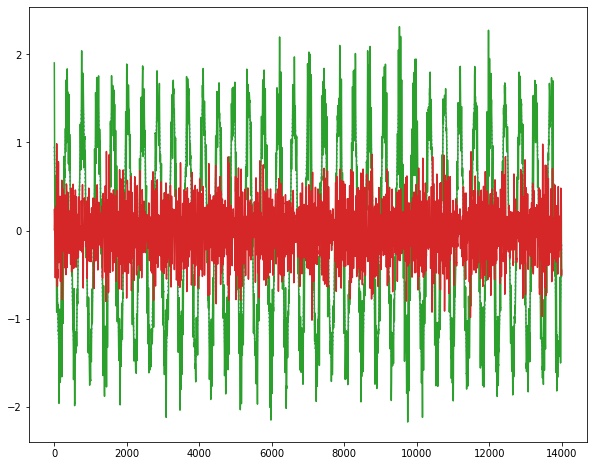

100%|██████████| 24/24 [00:00<00:00, 180.52it/s]

Epoch 4
Epoch 4 , mean error: 0.09678995 params: [DeviceArray([[7505.997   ,  -47.259476],
             [-161.4328  , 7586.6963  ]], dtype=float32), DeviceArray([[13.90485  ,  2.455521 ],
             [ 2.0504994, 16.517921 ]], dtype=float32)]


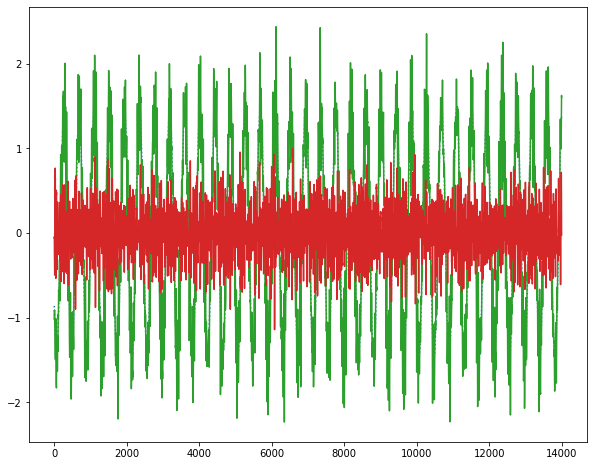

100%|██████████| 24/24 [00:00<00:00, 161.57it/s]

Epoch 5
Epoch 5 , mean error: 0.096587755 params: [DeviceArray([[7515.082  ,  -49.96564],
             [-159.56659, 7586.5483 ]], dtype=float32), DeviceArray([[15.442724  ,  0.33018696],
             [ 1.8914696 , 18.299578  ]], dtype=float32)]


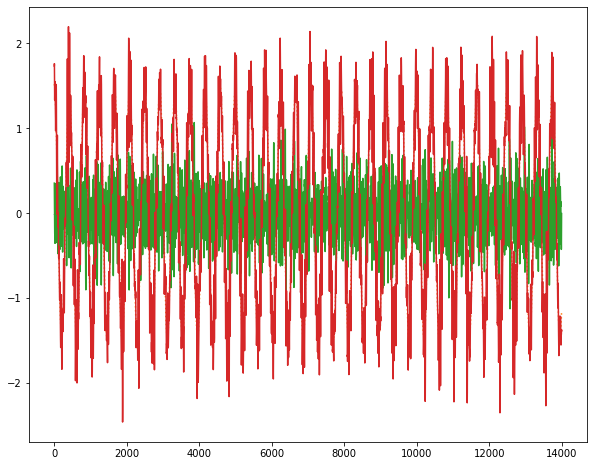

100%|██████████| 24/24 [00:00<00:00, 161.10it/s]

Epoch 6
Epoch 6 , mean error: 0.096552156 params: [DeviceArray([[7518.08    ,  -45.612434],
             [-151.1493  , 7586.7344  ]], dtype=float32), DeviceArray([[15.629126  ,  0.86223924],
             [ 1.6195266 , 18.484459  ]], dtype=float32)]


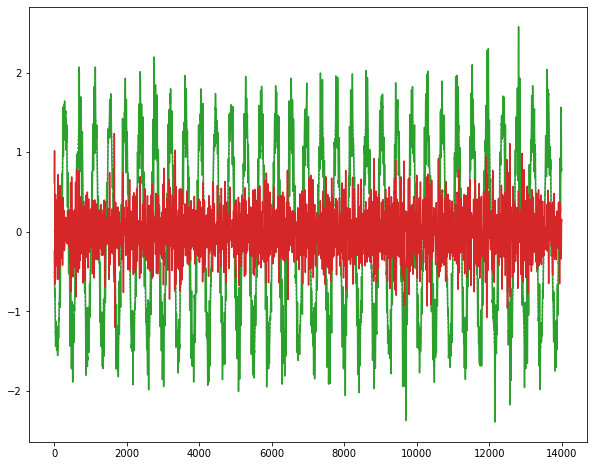

  4%|▍         | 1/24 [00:00<00:03,  7.12it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 84.53it/s]


Epoch 0 , mean error: 5.27542 params: [DeviceArray([[11440.297  ,  -995.4629 ],
             [ -140.03082,  6196.119  ]], dtype=float32), DeviceArray([[ 338.80975, -264.23926],
             [-253.57048,  337.71365]], dtype=float32)]


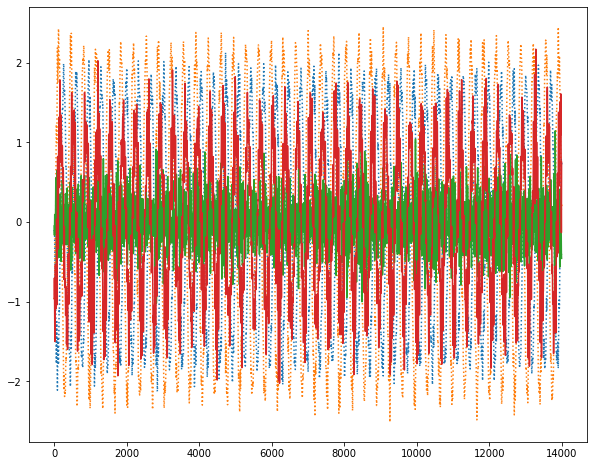

100%|██████████| 24/24 [00:00<00:00, 167.40it/s]

Epoch 1
Epoch 1 , mean error: 0.5402331 params: [DeviceArray([[12654.46   ,  -475.6096 ],
             [ -225.70714,  7869.7656 ]], dtype=float32), DeviceArray([[50.262478, 87.05758 ],
             [85.69531 , 55.54271 ]], dtype=float32)]


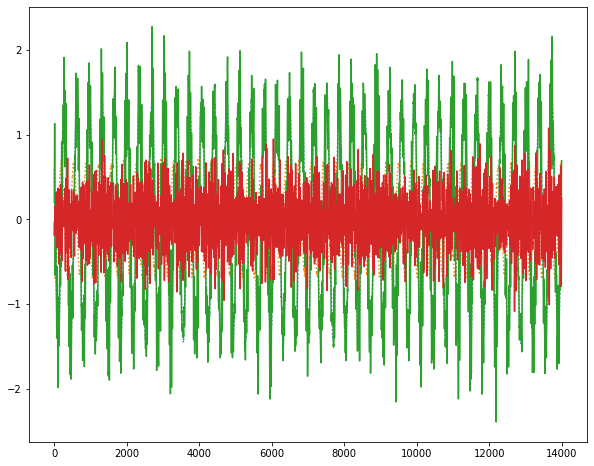

100%|██████████| 24/24 [00:00<00:00, 165.31it/s]

Epoch 2
Epoch 2 , mean error: 0.13205023 params: [DeviceArray([[11735.792  ,  -207.10068],
             [  257.72467,  8023.5156 ]], dtype=float32), DeviceArray([[ 42.78542 , -16.540863],
             [-17.132914,  38.56954 ]], dtype=float32)]


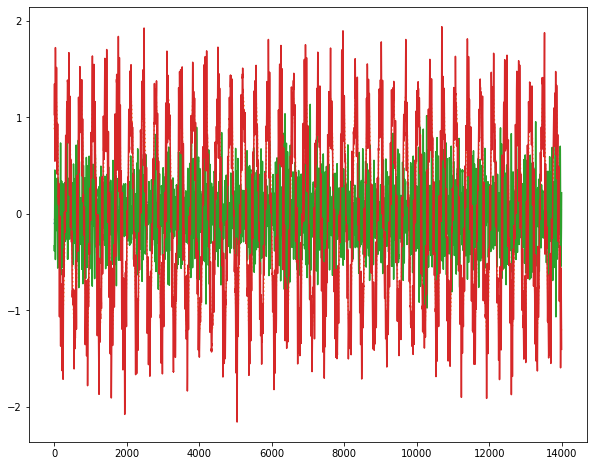

100%|██████████| 24/24 [00:00<00:00, 175.75it/s]

Epoch 3
Epoch 3 , mean error: 0.101257466 params: [DeviceArray([[11720.802  ,  -225.1163 ],
             [  171.77425,  8017.316  ]], dtype=float32), DeviceArray([[65.55384   , -0.32814503],
             [ 0.1008873 , 61.107006  ]], dtype=float32)]


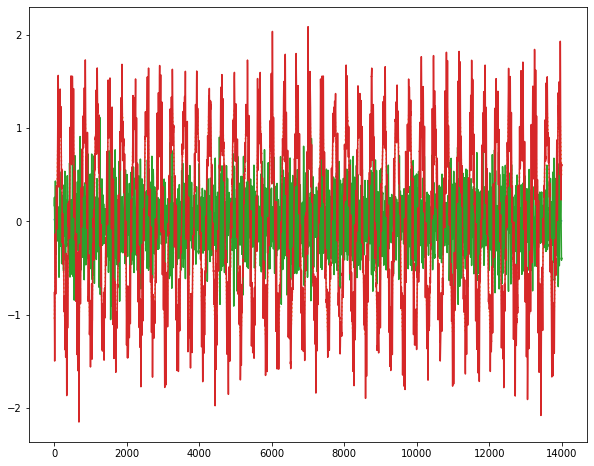

100%|██████████| 24/24 [00:00<00:00, 170.45it/s]

Epoch 4
Epoch 4 , mean error: 0.09902213 params: [DeviceArray([[11797.38   ,  -241.62259],
             [  125.27676,  7992.5728 ]], dtype=float32), DeviceArray([[64.21374  ,  1.8930621],
             [ 1.8146288, 61.075665 ]], dtype=float32)]


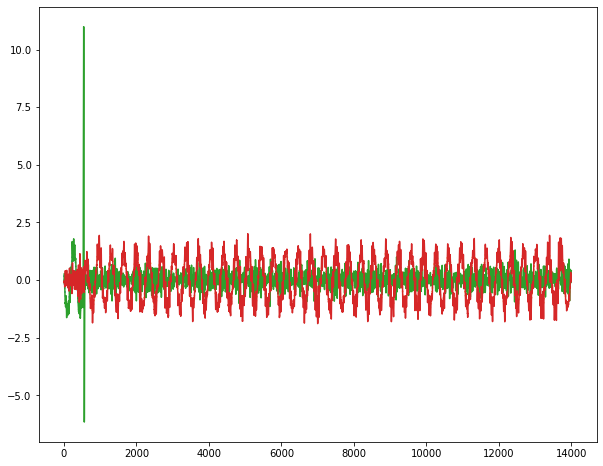

100%|██████████| 24/24 [00:00<00:00, 173.74it/s]

Epoch 5
Epoch 5 , mean error: 0.09883461 params: [DeviceArray([[11792.315  ,  -249.86362],
             [  152.38826,  7981.339  ]], dtype=float32), DeviceArray([[62.65972   , -0.4067577 ],
             [-0.25903717, 59.374706  ]], dtype=float32)]


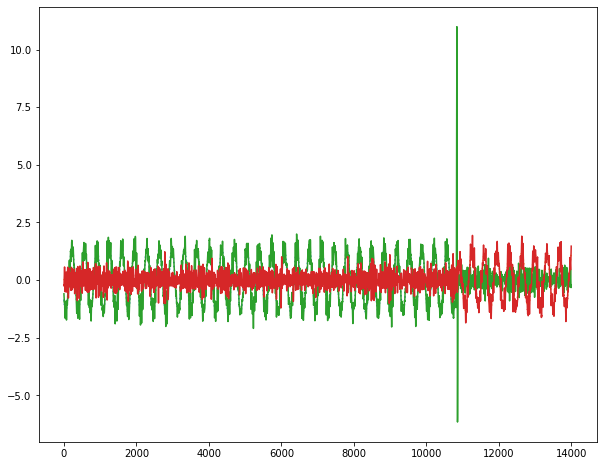

100%|██████████| 24/24 [00:00<00:00, 175.16it/s]

Epoch 6
Epoch 6 , mean error: 0.09881904 params: [DeviceArray([[11786.034  ,  -253.76868],
             [  151.74408,  7979.642  ]], dtype=float32), DeviceArray([[62.821125  ,  0.09839427],
             [ 0.33820835, 59.251038  ]], dtype=float32)]


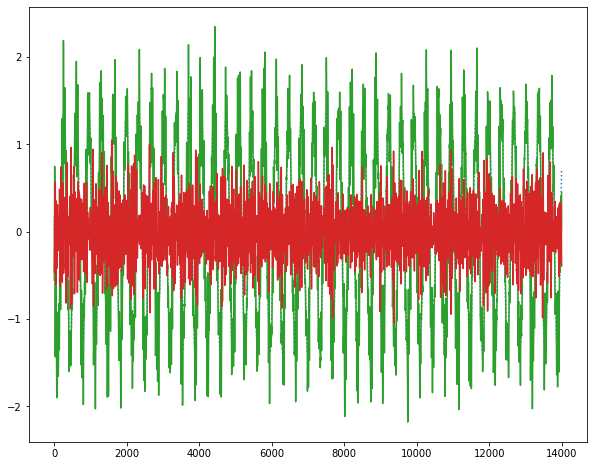

  4%|▍         | 1/24 [00:00<00:02,  8.15it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 94.22it/s]


Epoch 0 , mean error: 5.520542 params: [DeviceArray([[5904.9434,  317.0152],
             [ 736.3197, 6169.5317]], dtype=float32), DeviceArray([[ 297.06613, -258.85913],
             [-261.30853,  290.97473]], dtype=float32)]


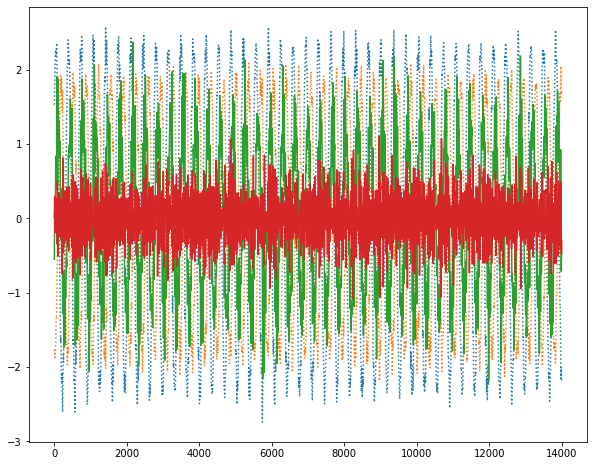

100%|██████████| 24/24 [00:00<00:00, 170.63it/s]

Epoch 1
Epoch 1 , mean error: 0.55866957 params: [DeviceArray([[7135.3687 , -145.81566],
             [ 344.74298, 7164.0234 ]], dtype=float32), DeviceArray([[-52.660946,  84.59619 ],
             [ 83.03633 , -60.74872 ]], dtype=float32)]


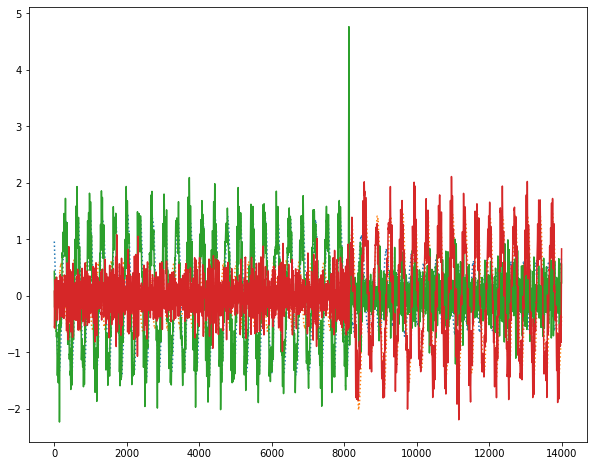

100%|██████████| 24/24 [00:00<00:00, 165.96it/s]

Epoch 2
Epoch 2 , mean error: 0.13184984 params: [DeviceArray([[7420.4644  ,  180.97728 ],
             [  42.965134, 7428.828   ]], dtype=float32), DeviceArray([[ 22.475391, -18.692457],
             [-15.099967,  25.706116]], dtype=float32)]


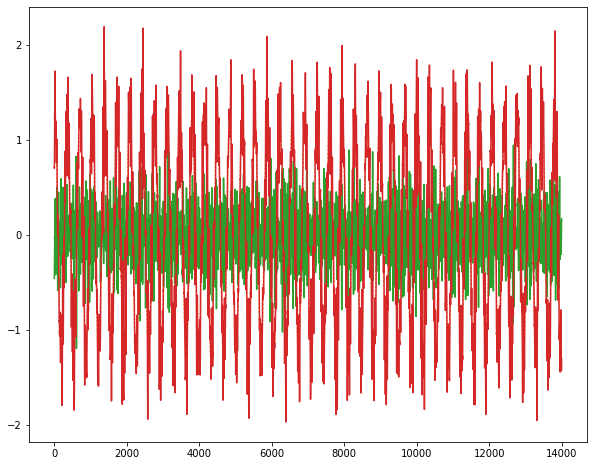

100%|██████████| 24/24 [00:00<00:00, 167.52it/s]

Epoch 3
Epoch 3 , mean error: 0.09884282 params: [DeviceArray([[7502.093   ,   56.089287],
             [  66.42157 , 7516.9927  ]], dtype=float32), DeviceArray([[23.761415 ,  0.4937148],
             [-1.2861867, 19.674084 ]], dtype=float32)]


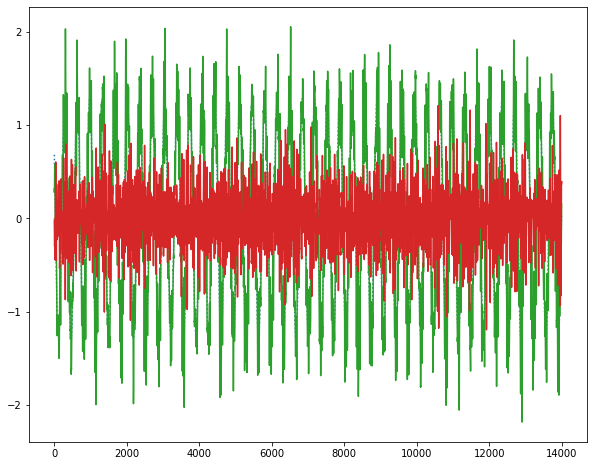

100%|██████████| 24/24 [00:00<00:00, 163.41it/s]

Epoch 4
Epoch 4 , mean error: 0.09633279 params: [DeviceArray([[7526.5537 ,   88.28092],
             [  77.63608, 7528.2686 ]], dtype=float32), DeviceArray([[17.097706 ,  0.7889739],
             [ 1.4068213, 14.662305 ]], dtype=float32)]


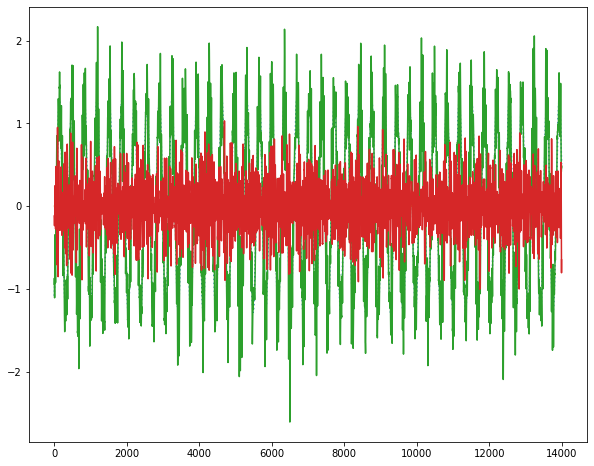

100%|██████████| 24/24 [00:00<00:00, 162.69it/s]

Epoch 5
Epoch 5 , mean error: 0.09620172 params: [DeviceArray([[7528.0415  ,   83.582855],
             [  70.8181  , 7529.887   ]], dtype=float32), DeviceArray([[18.94367  , -1.0124542],
             [-0.7697563, 16.841347 ]], dtype=float32)]


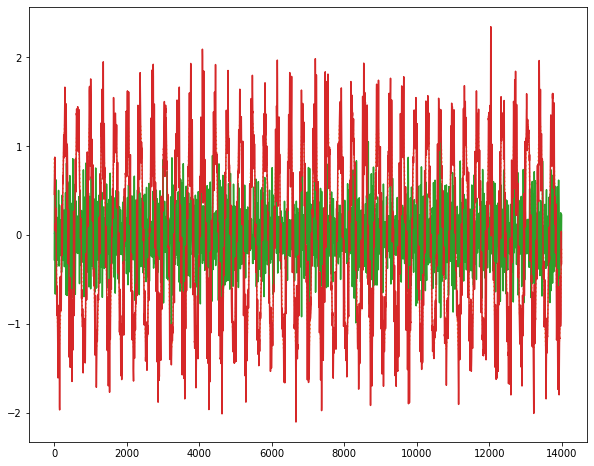

 42%|████▏     | 10/24 [00:00<00:00, 97.28it/s]

Epoch 6


100%|██████████| 24/24 [00:00<00:00, 119.64it/s]


Epoch 6 , mean error: 0.09617283 params: [DeviceArray([[7524.9614  ,   83.27988 ],
             [  66.487366, 7527.892   ]], dtype=float32), DeviceArray([[19.071547 , -0.4048864],
             [-0.2878395, 16.606041 ]], dtype=float32)]


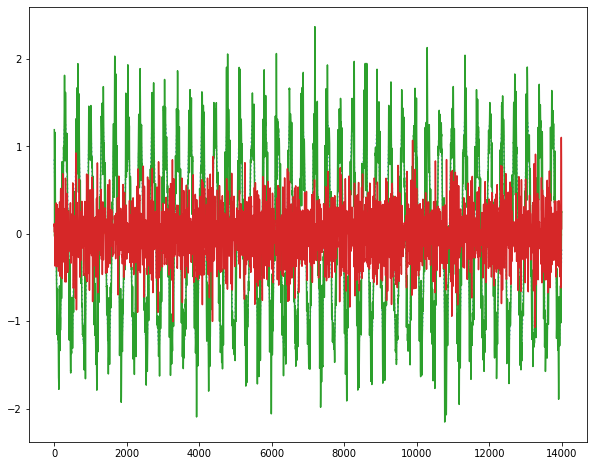

  4%|▍         | 1/24 [00:00<00:02,  8.11it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 84.66it/s]


Epoch 0 , mean error: 3.3983595 params: [DeviceArray([[12091.35  ,  -520.0597],
             [-1083.7379,  6413.322 ]], dtype=float32), DeviceArray([[ 327.02478, -222.26317],
             [-268.25684,  342.20847]], dtype=float32)]


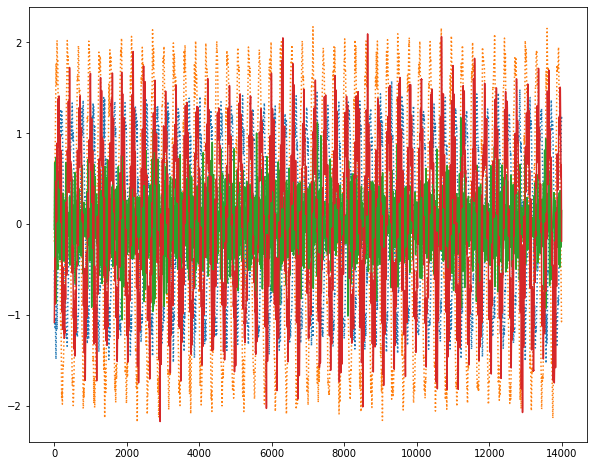

100%|██████████| 24/24 [00:00<00:00, 159.95it/s]

Epoch 1
Epoch 1 , mean error: 0.37175226 params: [DeviceArray([[12360.532  ,    46.85544],
             [  295.04175,  7550.284  ]], dtype=float32), DeviceArray([[75.30893 , 80.43028 ],
             [81.62574 , 19.157719]], dtype=float32)]


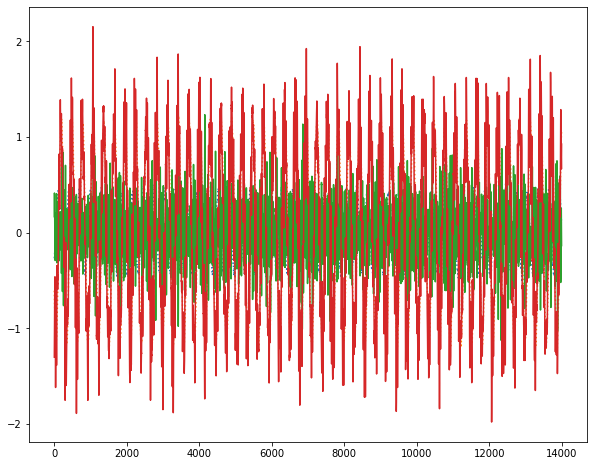

100%|██████████| 24/24 [00:00<00:00, 145.13it/s]

Epoch 2
Epoch 2 , mean error: 0.11677394 params: [DeviceArray([[11806.725  ,  -306.91586],
             [  165.85847,  7516.3237 ]], dtype=float32), DeviceArray([[ 41.712017, -22.802794],
             [ -8.718831,  49.30674 ]], dtype=float32)]


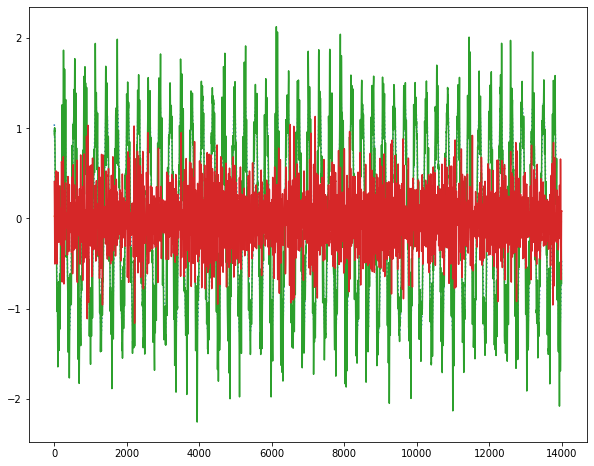

100%|██████████| 24/24 [00:00<00:00, 142.54it/s]

Epoch 3
Epoch 3 , mean error: 0.09793874 params: [DeviceArray([[11865.287  ,  -380.24628],
             [  250.32736,  7596.7515 ]], dtype=float32), DeviceArray([[61.897026 ,  4.532443 ],
             [-2.2979693, 67.08861  ]], dtype=float32)]


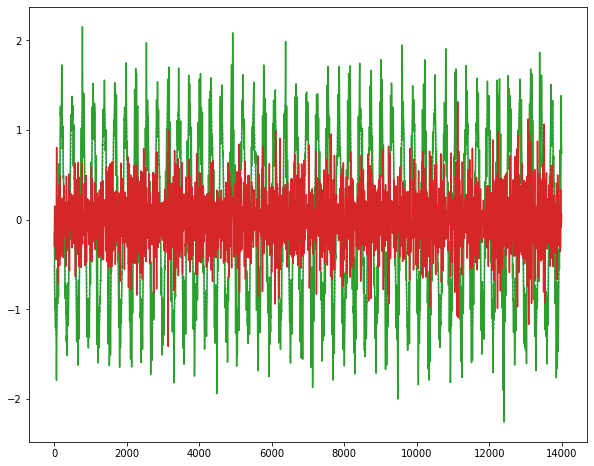

100%|██████████| 24/24 [00:00<00:00, 144.46it/s]

Epoch 4
Epoch 4 , mean error: 0.09651696 params: [DeviceArray([[11876.347  ,  -361.73355],
             [  256.27838,  7608.878  ]], dtype=float32), DeviceArray([[64.644554  , -0.15582395],
             [ 2.9634113 , 60.840496  ]], dtype=float32)]


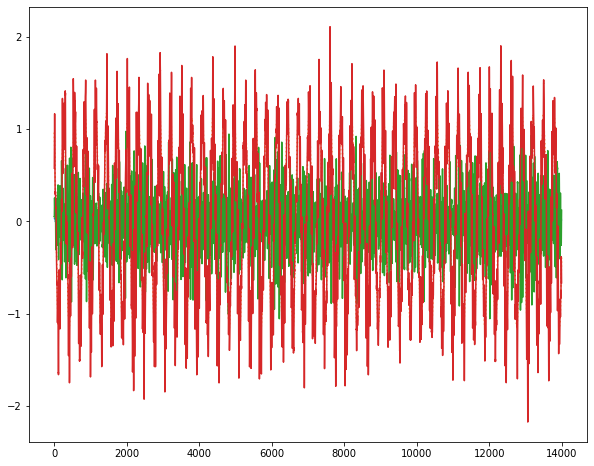

100%|██████████| 24/24 [00:00<00:00, 162.92it/s]

Epoch 5
Epoch 5 , mean error: 0.09640973 params: [DeviceArray([[11866.756  ,  -362.57935],
             [  240.53506,  7600.2695 ]], dtype=float32), DeviceArray([[63.350567 , -0.2938192],
             [ 0.651205 , 60.583424 ]], dtype=float32)]


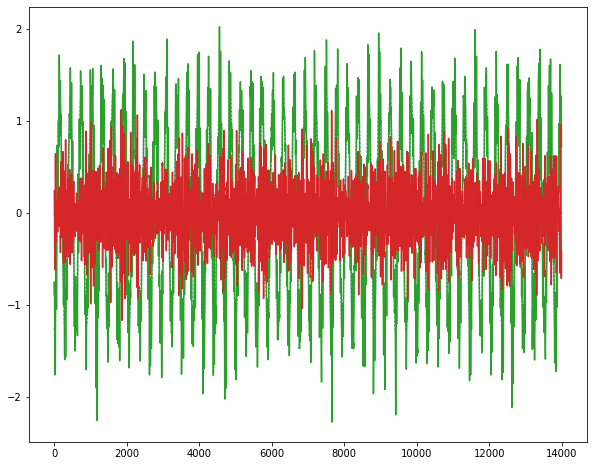

100%|██████████| 24/24 [00:00<00:00, 156.16it/s]

Epoch 6
Epoch 6 , mean error: 0.09639337 params: [DeviceArray([[11867.624  ,  -359.71213],
             [  239.87158,  7598.364  ]], dtype=float32), DeviceArray([[63.077103  ,  0.19767714],
             [ 0.7675591 , 61.16087   ]], dtype=float32)]


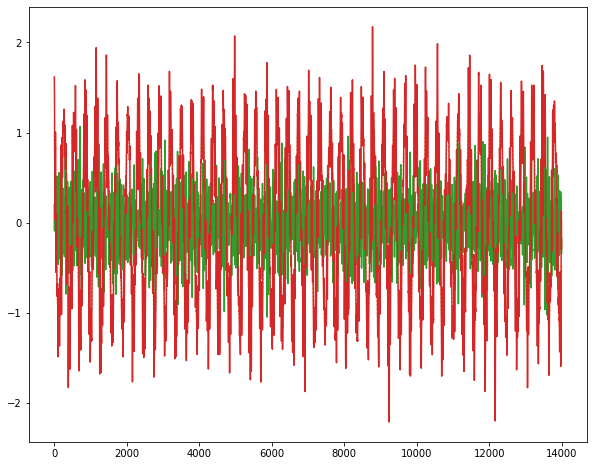

  4%|▍         | 1/24 [00:00<00:03,  6.95it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 79.83it/s]


Epoch 0 , mean error: 3.4937274 params: [DeviceArray([[5984.1885 , -106.64857],
             [-859.3631 , 5233.4907 ]], dtype=float32), DeviceArray([[ 285.4152 , -275.64917],
             [-247.15303,  304.65805]], dtype=float32)]


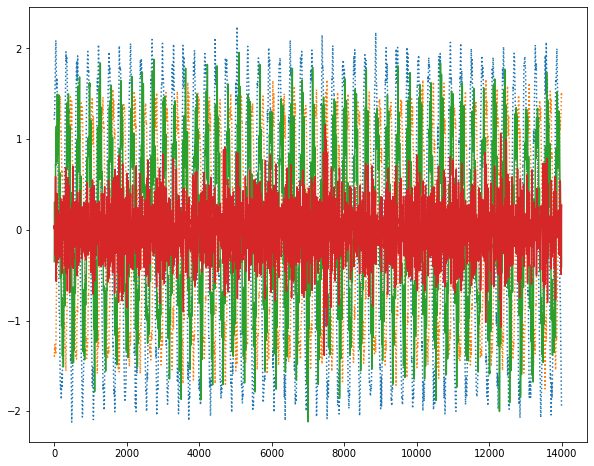

100%|██████████| 24/24 [00:00<00:00, 128.51it/s]

Epoch 1
Epoch 1 , mean error: 0.39222756 params: [DeviceArray([[6924.822   ,  -28.700981],
             [ 520.6902  , 7143.1733  ]], dtype=float32), DeviceArray([[-54.806896,  81.3416  ],
             [ 81.370224, -51.682518]], dtype=float32)]


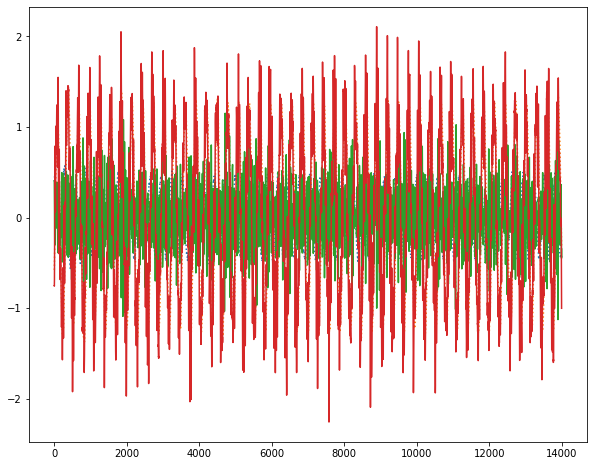

100%|██████████| 24/24 [00:00<00:00, 155.91it/s]

Epoch 2
Epoch 2 , mean error: 0.11665714 params: [DeviceArray([[ 7.1900322e+03,  4.2198715e+00],
             [-1.4750597e+02,  7.6653687e+03]], dtype=float32), DeviceArray([[ 28.506802, -12.721053],
             [-20.156734,  19.500324]], dtype=float32)]


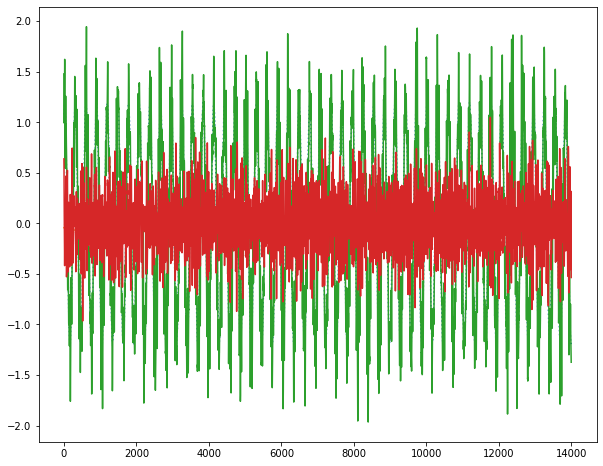

100%|██████████| 24/24 [00:00<00:00, 169.59it/s]

Epoch 3
Epoch 3 , mean error: 0.09600661 params: [DeviceArray([[7.2641221e+03, 3.2517571e+00],
             [9.4485031e+01, 7.7049966e+03]], dtype=float32), DeviceArray([[23.817814  , -3.0231051 ],
             [-0.21942568, 23.15272   ]], dtype=float32)]


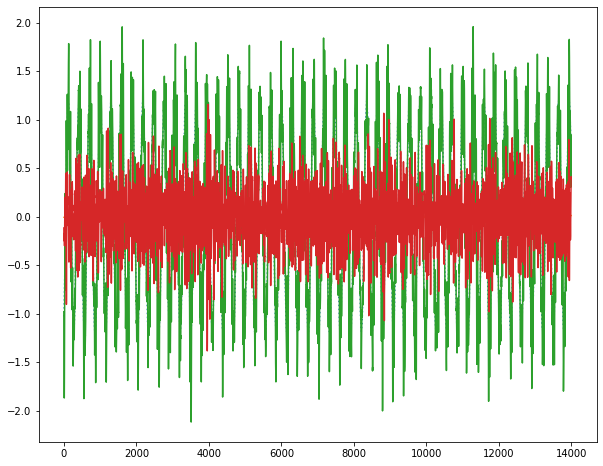

100%|██████████| 24/24 [00:00<00:00, 139.64it/s]

Epoch 4
Epoch 4 , mean error: 0.09462275 params: [DeviceArray([[ 7.2823389e+03, -4.7958422e-01],
             [ 2.4335892e+01,  7.7032295e+03]], dtype=float32), DeviceArray([[18.541937 ,  1.1862409],
             [-0.5087898, 15.917972 ]], dtype=float32)]


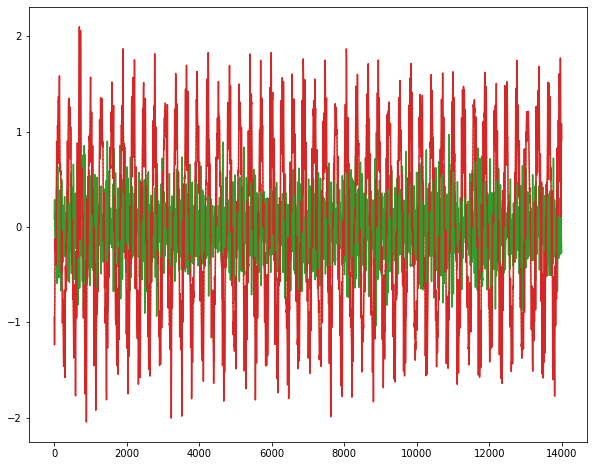

100%|██████████| 24/24 [00:00<00:00, 155.88it/s]

Epoch 5
Epoch 5 , mean error: 0.09449176 params: [DeviceArray([[7.2851147e+03, 2.6493387e+00],
             [3.9721115e+01, 7.6963589e+03]], dtype=float32), DeviceArray([[20.632832 , -1.0623062],
             [-2.0770116, 17.571732 ]], dtype=float32)]


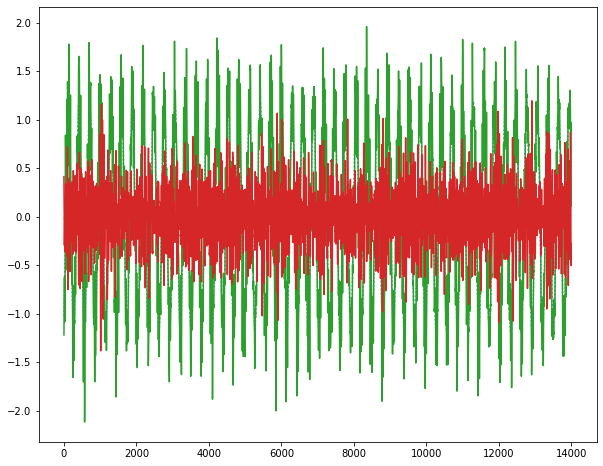

100%|██████████| 24/24 [00:00<00:00, 155.12it/s]

Epoch 6
Epoch 6 , mean error: 0.09448075 params: [DeviceArray([[7.2836279e+03, 3.0286522e+00],
             [3.6842247e+01, 7.6915674e+03]], dtype=float32), DeviceArray([[20.499699 , -0.6829262],
             [-1.4594043, 17.701508 ]], dtype=float32)]


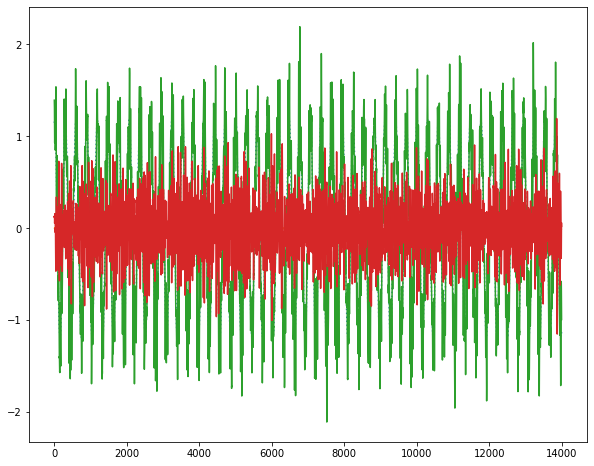

  4%|▍         | 1/24 [00:00<00:02,  8.48it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 93.35it/s]


Epoch 0 , mean error: 2.3615696 params: [DeviceArray([[12058.822 ,  -990.6575],
             [ -816.786 ,  5961.9155]], dtype=float32), DeviceArray([[349.71436, 275.56894],
             [269.82886, 332.9283 ]], dtype=float32)]


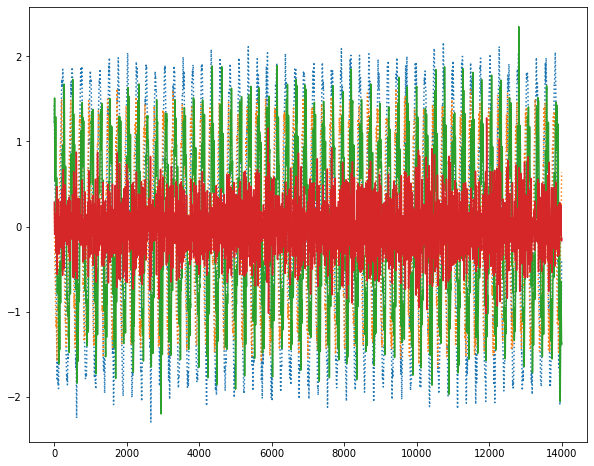

100%|██████████| 24/24 [00:00<00:00, 166.84it/s]

Epoch 1
Epoch 1 , mean error: 0.2870919 params: [DeviceArray([[12639.309  ,  -514.61273],
             [ -207.94884,  7747.286  ]], dtype=float32), DeviceArray([[ 50.588764, -61.81199 ],
             [-89.68761 ,  52.99942 ]], dtype=float32)]


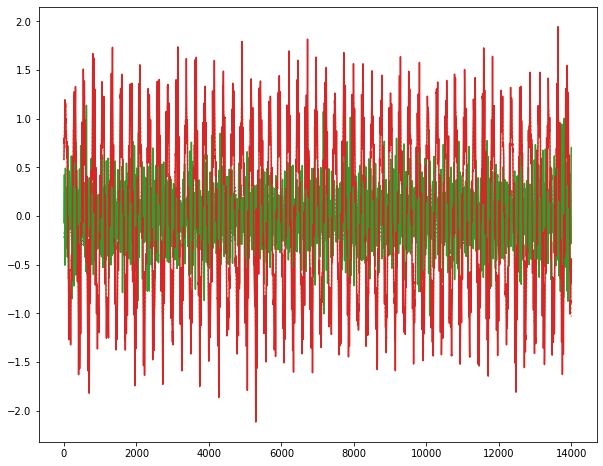

100%|██████████| 24/24 [00:00<00:00, 161.24it/s]

Epoch 2
Epoch 2 , mean error: 0.10703591 params: [DeviceArray([[11716.35    ,  -689.60077 ],
             [   30.443436,  8193.961   ]], dtype=float32), DeviceArray([[41.05139 , -3.935481],
             [18.175545, 39.823025]], dtype=float32)]


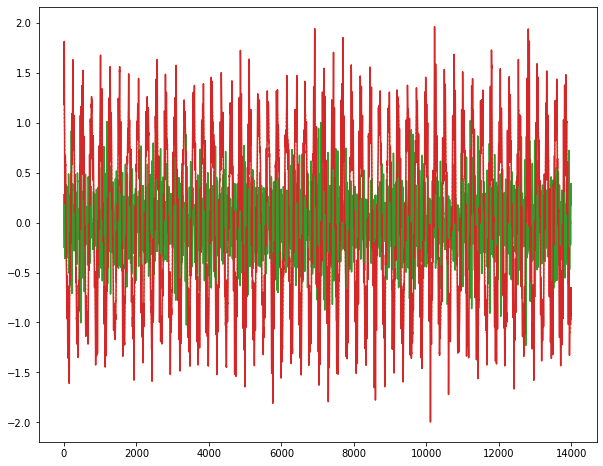

100%|██████████| 24/24 [00:00<00:00, 156.51it/s]

Epoch 3
Epoch 3 , mean error: 0.094444804 params: [DeviceArray([[11789.304   ,  -738.07434 ],
             [  -93.329575,  8147.64    ]], dtype=float32), DeviceArray([[66.23706  ,  4.3329763],
             [-2.6364279, 63.68211  ]], dtype=float32)]


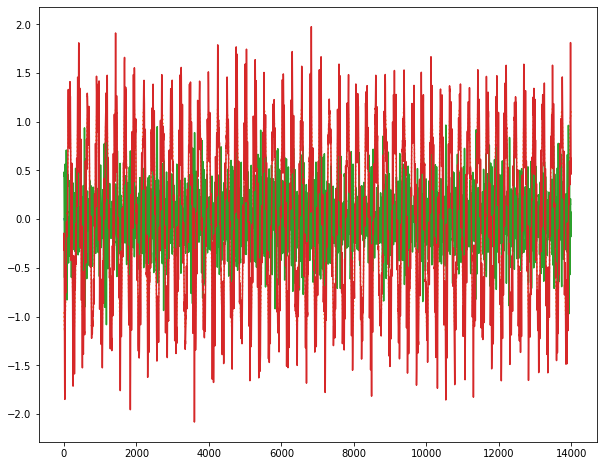

100%|██████████| 24/24 [00:00<00:00, 153.16it/s]

Epoch 4
Epoch 4 , mean error: 0.09341425 params: [DeviceArray([[11854.709  ,  -738.51355],
             [ -103.26575,  8106.7036 ]], dtype=float32), DeviceArray([[63.57952  , -2.8328316],
             [-2.3419688, 62.5997   ]], dtype=float32)]


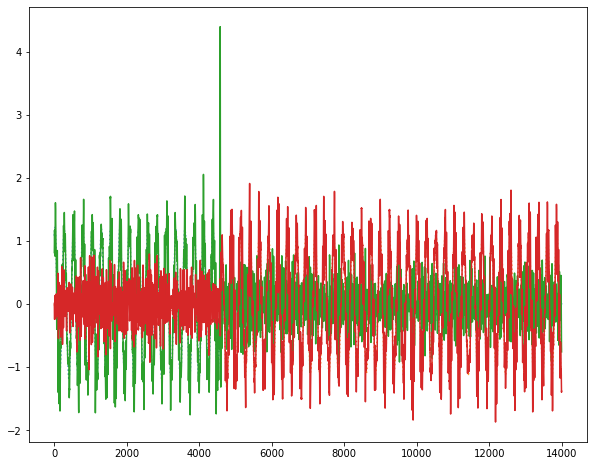

100%|██████████| 24/24 [00:00<00:00, 173.29it/s]

Epoch 5
Epoch 5 , mean error: 0.093302846 params: [DeviceArray([[11839.433  ,  -741.52155],
             [ -105.10777,  8097.724  ]], dtype=float32), DeviceArray([[61.81012  , -1.7529049],
             [-0.6149627, 60.918682 ]], dtype=float32)]


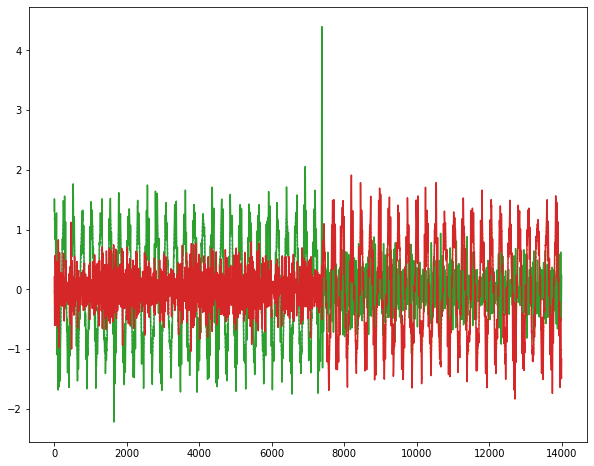

100%|██████████| 24/24 [00:00<00:00, 169.77it/s]

Epoch 6
Epoch 6 , mean error: 0.09330049 params: [DeviceArray([[11833.896  ,  -741.2989 ],
             [ -110.10597,  8096.9297 ]], dtype=float32), DeviceArray([[62.03781  , -1.4179001],
             [-1.2394006, 61.060455 ]], dtype=float32)]


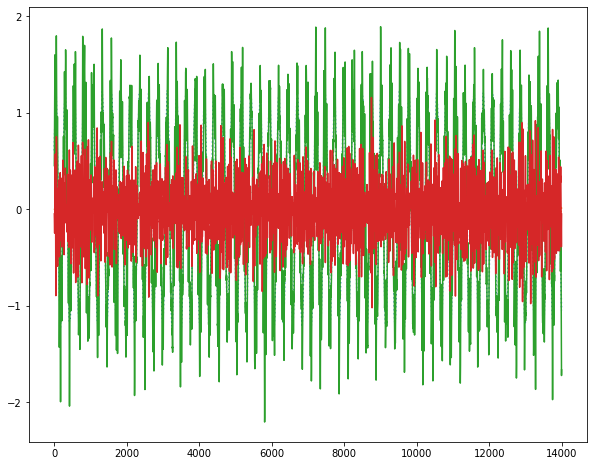

  4%|▍         | 1/24 [00:00<00:02,  8.78it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 95.47it/s]


Epoch 0 , mean error: 2.4720726 params: [DeviceArray([[ 5506.598 ,  1078.0145],
             [-1303.616 ,  6644.8364]], dtype=float32), DeviceArray([[ 296.09793, -244.25516],
             [-262.9778 ,  277.9074 ]], dtype=float32)]


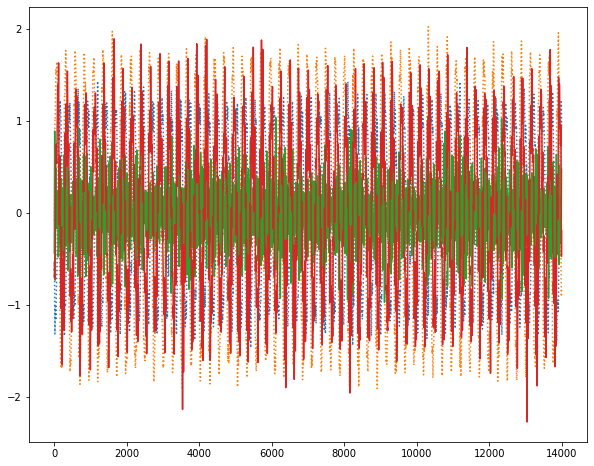

100%|██████████| 24/24 [00:00<00:00, 166.53it/s]

Epoch 1
Epoch 1 , mean error: 0.29498103 params: [DeviceArray([[6773.168  ,  953.62396],
             [-322.04398, 7082.1016 ]], dtype=float32), DeviceArray([[-52.91399,  84.48226],
             [ 82.1626 , -65.94578]], dtype=float32)]


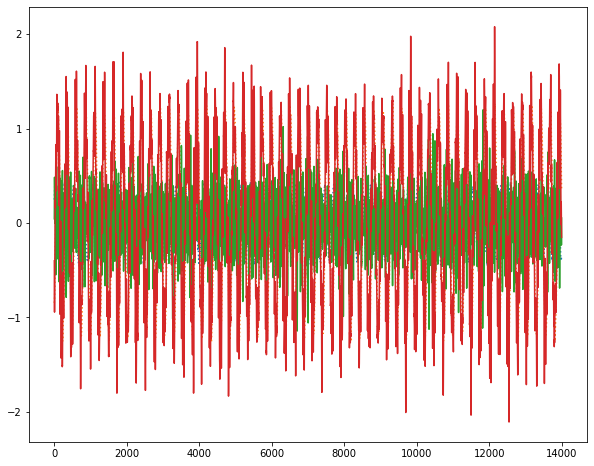

100%|██████████| 24/24 [00:00<00:00, 160.26it/s]

Epoch 2
Epoch 2 , mean error: 0.109995805 params: [DeviceArray([[7467.44   ,  324.9669 ],
             [ -79.30242, 7562.3823 ]], dtype=float32), DeviceArray([[ 20.204891, -23.050722],
             [-11.093591,  27.183714]], dtype=float32)]


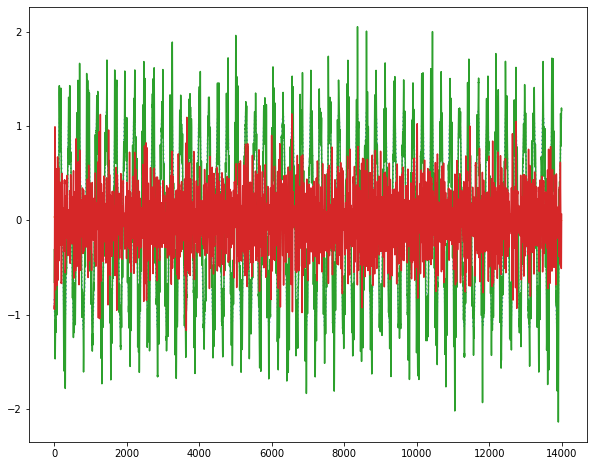

100%|██████████| 24/24 [00:00<00:00, 150.44it/s]

Epoch 3
Epoch 3 , mean error: 0.09475738 params: [DeviceArray([[7594.6816 ,  261.30396],
             [-223.10223, 7629.511  ]], dtype=float32), DeviceArray([[22.183094  , -0.19752955],
             [-0.39662886, 17.800598  ]], dtype=float32)]


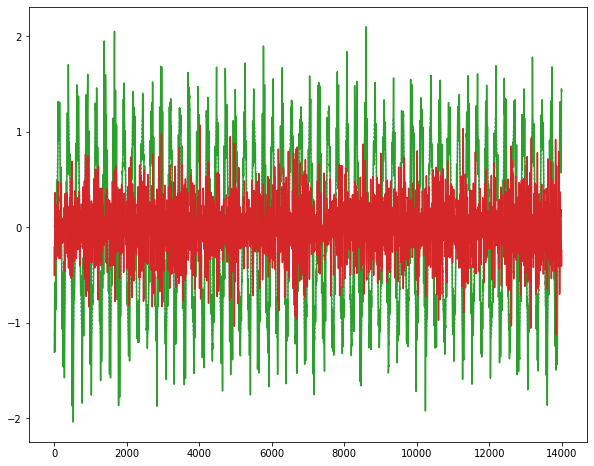

 58%|█████▊    | 14/24 [00:00<00:00, 112.96it/s]

Epoch 4


100%|██████████| 24/24 [00:00<00:00, 106.19it/s]


Epoch 4 , mean error: 0.09374509 params: [DeviceArray([[7598.103  ,  241.55867],
             [-203.72601, 7630.221  ]], dtype=float32), DeviceArray([[15.409202 , -1.2963752],
             [ 3.4252884, 13.434983 ]], dtype=float32)]


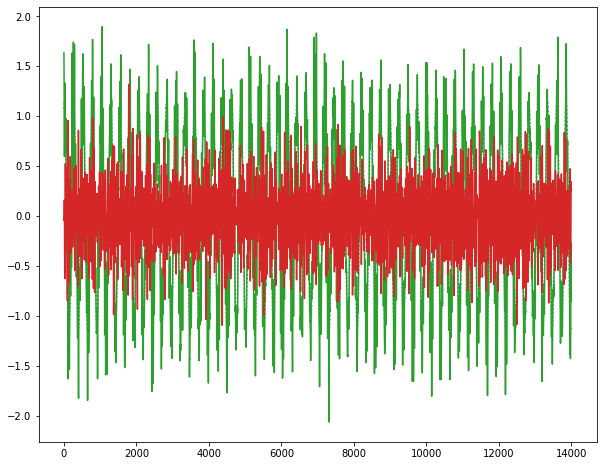

100%|██████████| 24/24 [00:00<00:00, 162.20it/s]

Epoch 5
Epoch 5 , mean error: 0.09371463 params: [DeviceArray([[7597.336  ,  233.68652],
             [-183.46774, 7638.7476 ]], dtype=float32), DeviceArray([[17.189238 , -2.784813 ],
             [ 1.3460449, 15.583923 ]], dtype=float32)]


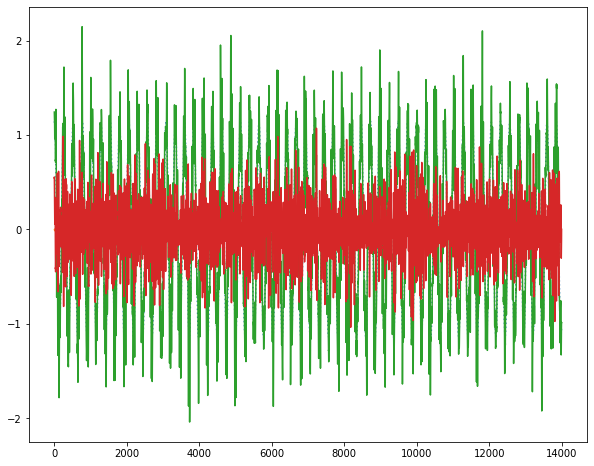

100%|██████████| 24/24 [00:00<00:00, 128.39it/s]

Epoch 6
Epoch 6 , mean error: 0.093685746 params: [DeviceArray([[7593.09   ,  235.92822],
             [-184.7919 , 7640.2144 ]], dtype=float32), DeviceArray([[17.304857 , -2.1220784],
             [ 1.8552904, 15.206844 ]], dtype=float32)]


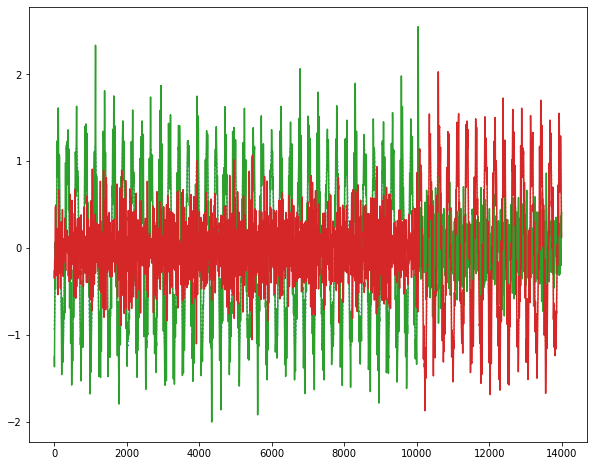

  4%|▍         | 1/24 [00:00<00:02,  8.90it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 98.97it/s]


Epoch 0 , mean error: 1.789245 params: [DeviceArray([[12110.296   ,  -127.342514],
             [  904.0266  ,  5821.373   ]], dtype=float32), DeviceArray([[ 329.85168, -243.90363],
             [-268.78513,  341.96356]], dtype=float32)]


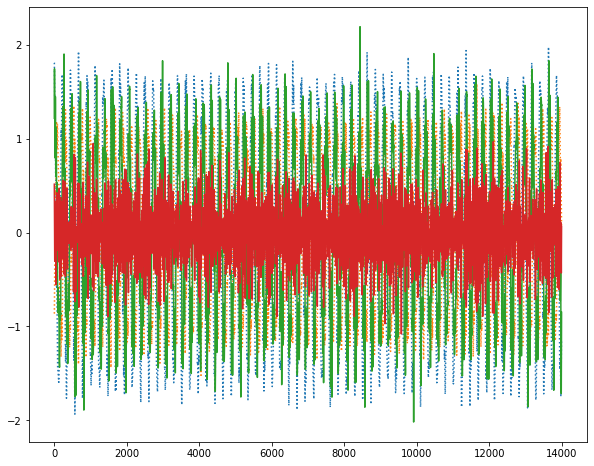

100%|██████████| 24/24 [00:00<00:00, 177.43it/s]

Epoch 1
Epoch 1 , mean error: 0.23610227 params: [DeviceArray([[12974.399  ,  -694.30115],
             [  199.5601 ,  7910.2817 ]], dtype=float32), DeviceArray([[68.608055, 84.8576  ],
             [80.979195, 36.61697 ]], dtype=float32)]


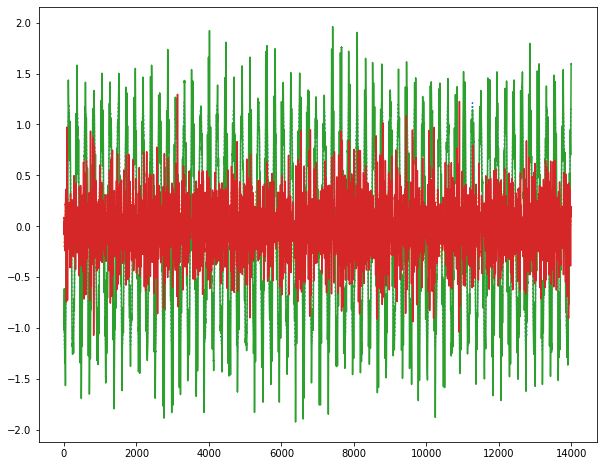

100%|██████████| 24/24 [00:00<00:00, 168.86it/s]

Epoch 2
Epoch 2 , mean error: 0.10455224 params: [DeviceArray([[12035.941  ,  -579.7064 ],
             [  616.14453,  8349.637  ]], dtype=float32), DeviceArray([[ 40.07475 , -18.874535],
             [ -8.962476,  43.80019 ]], dtype=float32)]


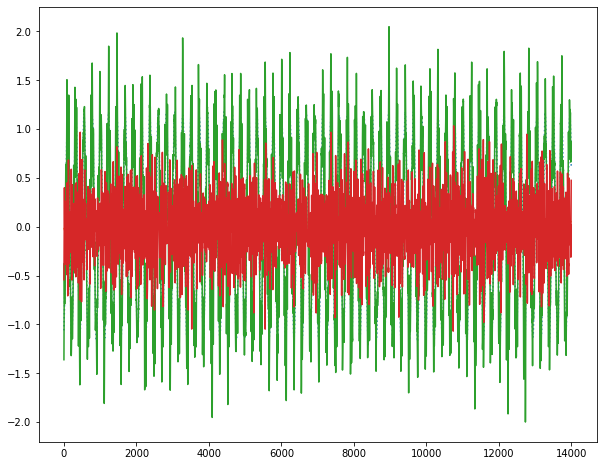

100%|██████████| 24/24 [00:00<00:00, 158.67it/s]

Epoch 3
Epoch 3 , mean error: 0.09454024 params: [DeviceArray([[12056.606  ,  -474.59174],
             [  559.29126,  8359.151  ]], dtype=float32), DeviceArray([[61.71979  ,  1.8580472],
             [-2.1333575, 66.395584 ]], dtype=float32)]


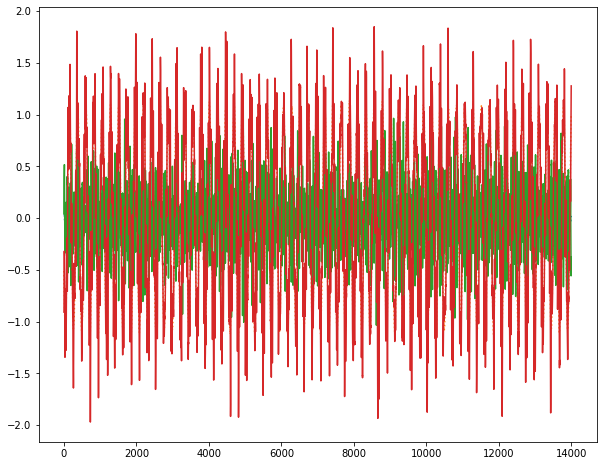

 33%|███▎      | 8/24 [00:00<00:00, 73.31it/s]

Epoch 4


100%|██████████| 24/24 [00:00<00:00, 101.40it/s]


Epoch 4 , mean error: 0.09388725 params: [DeviceArray([[12125.802  ,  -535.13226],
             [  527.1124 ,  8311.386  ]], dtype=float32), DeviceArray([[63.274    ,  1.7494774],
             [ 3.044006 , 62.45267  ]], dtype=float32)]


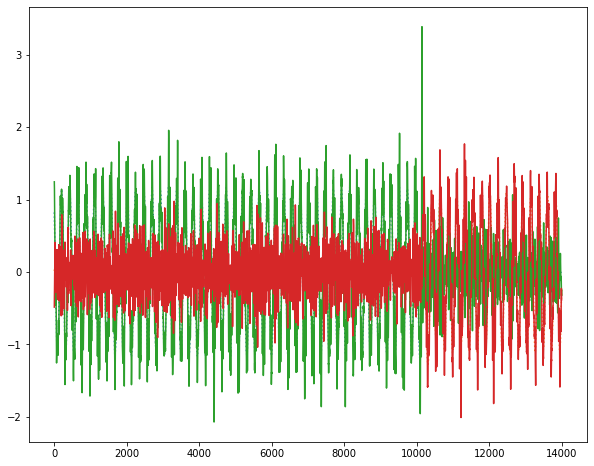

100%|██████████| 24/24 [00:00<00:00, 172.15it/s]

Epoch 5
Epoch 5 , mean error: 0.093794554 params: [DeviceArray([[12120.626  ,  -552.36725],
             [  548.3721 ,  8298.148  ]], dtype=float32), DeviceArray([[61.582157  ,  0.22473347],
             [ 0.8854151 , 61.138126  ]], dtype=float32)]


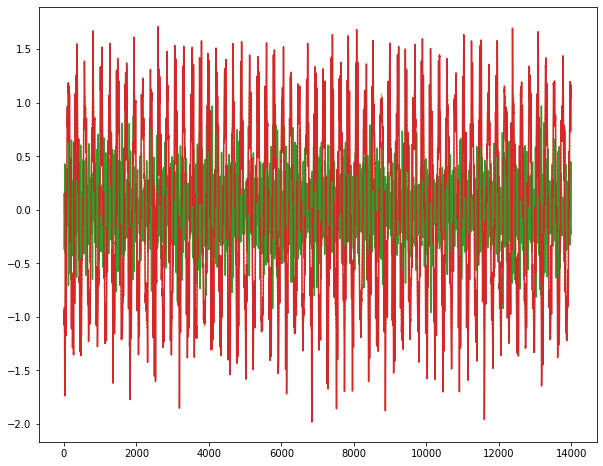

100%|██████████| 24/24 [00:00<00:00, 172.76it/s]

Epoch 6
Epoch 6 , mean error: 0.0937858 params: [DeviceArray([[12116.279  ,  -563.81287],
             [  547.63165,  8302.177  ]], dtype=float32), DeviceArray([[61.197983 ,  1.0036517],
             [ 1.1601586, 61.536526 ]], dtype=float32)]


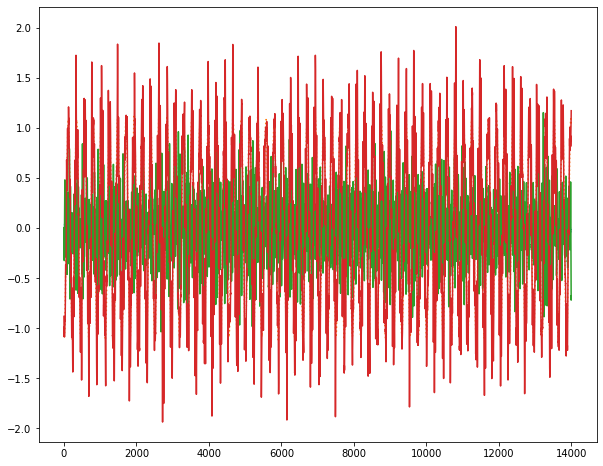

  4%|▍         | 1/24 [00:00<00:02,  9.11it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 98.06it/s]


Epoch 0 , mean error: 1.8624607 params: [DeviceArray([[4955.38  , -523.208 ],
             [ 187.3314, 6003.784 ]], dtype=float32), DeviceArray([[ 290.6356 , -244.9496 ],
             [ 261.98004,  287.57977]], dtype=float32)]


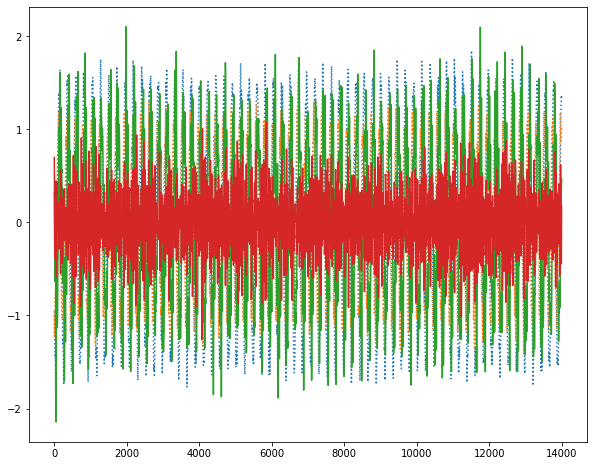

100%|██████████| 24/24 [00:00<00:00, 178.00it/s]

Epoch 1
Epoch 1 , mean error: 0.24728549 params: [DeviceArray([[7267.242  , -253.15681],
             [-527.0227 , 7608.3945 ]], dtype=float32), DeviceArray([[-51.51528 ,  83.532036],
             [-81.99818 , -59.30736 ]], dtype=float32)]


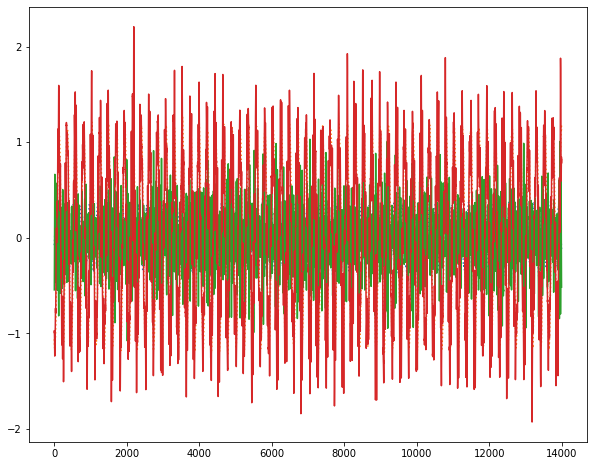

100%|██████████| 24/24 [00:00<00:00, 179.21it/s]

Epoch 2
Epoch 2 , mean error: 0.10477841 params: [DeviceArray([[7709.9546 ,  211.39502],
             [-155.04361, 7776.0356 ]], dtype=float32), DeviceArray([[ 21.221375, -23.64061 ],
             [ 13.564401,  33.315544]], dtype=float32)]


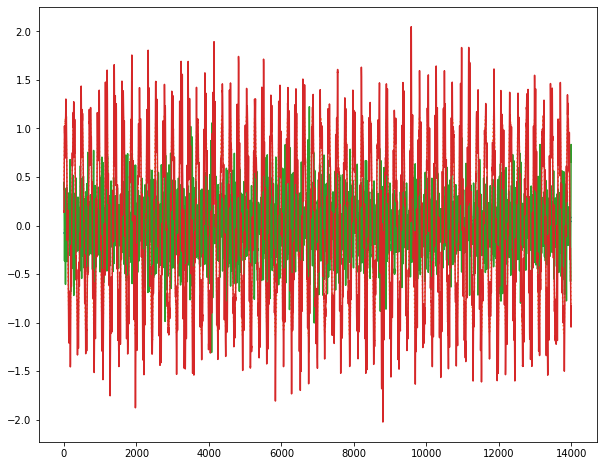

100%|██████████| 24/24 [00:00<00:00, 168.66it/s]

Epoch 3
Epoch 3 , mean error: 0.094558656 params: [DeviceArray([[7692.7217  ,   43.343796],
             [-221.1879  , 7822.104   ]], dtype=float32), DeviceArray([[23.161888 , -1.32532  ],
             [ 1.1102011, 24.413246 ]], dtype=float32)]


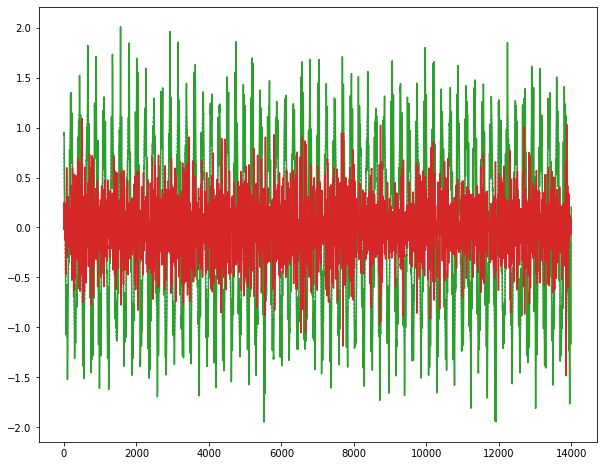

100%|██████████| 24/24 [00:00<00:00, 165.30it/s]

Epoch 4
Epoch 4 , mean error: 0.09370303 params: [DeviceArray([[7666.6045  ,   14.609518],
             [-210.66592 , 7812.41    ]], dtype=float32), DeviceArray([[16.490992 , -2.19607  ],
             [-1.9775424, 20.20539  ]], dtype=float32)]


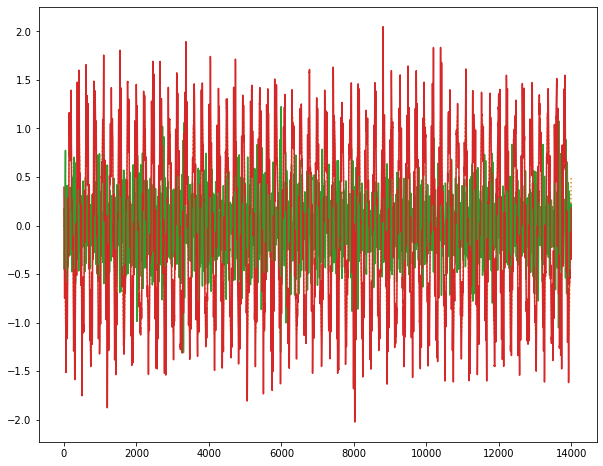

100%|██████████| 24/24 [00:00<00:00, 177.97it/s]

Epoch 5
Epoch 5 , mean error: 0.09361889 params: [DeviceArray([[7650.3403 ,   10.77578],
             [-202.3695 , 7804.867  ]], dtype=float32), DeviceArray([[18.301931  , -3.8102329 ],
             [ 0.17298004, 22.559975  ]], dtype=float32)]


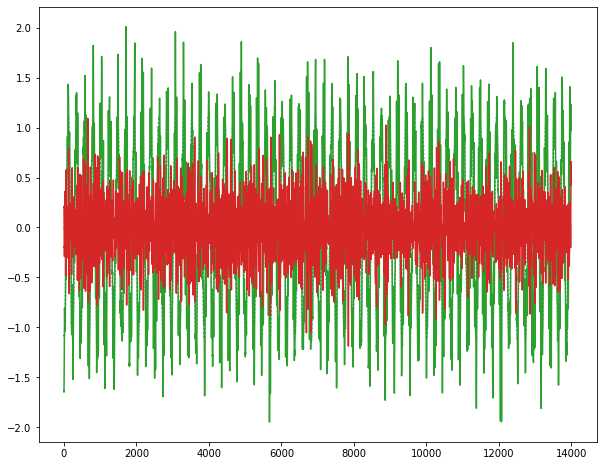

100%|██████████| 24/24 [00:00<00:00, 178.33it/s]

Epoch 6
Epoch 6 , mean error: 0.0936281 params: [DeviceArray([[ 7.644790e+03,  5.501255e+00],
             [-1.976557e+02,  7.806082e+03]], dtype=float32), DeviceArray([[18.495014  , -3.2109458 ],
             [-0.28196794, 22.409342  ]], dtype=float32)]


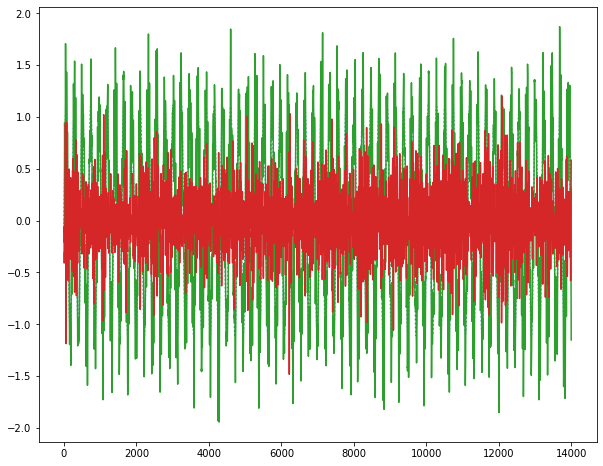

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 73.12it/s]


Epoch 0 , mean error: 1.4270693 params: [DeviceArray([[13556.061   ,    57.159454],
             [  169.71667 ,  5543.8564  ]], dtype=float32), DeviceArray([[ 344.6947 , -272.5266 ],
             [-248.32292,  324.4478 ]], dtype=float32)]


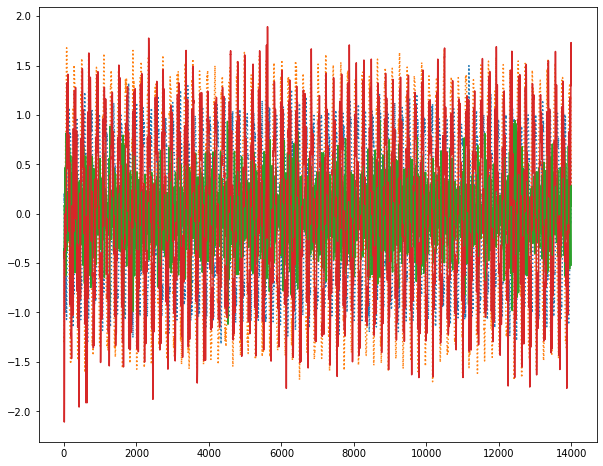

100%|██████████| 24/24 [00:00<00:00, 174.52it/s]

Epoch 1
Epoch 1 , mean error: 0.20714176 params: [DeviceArray([[12933.416  , -1199.0635 ],
             [  574.09985,  7963.7676 ]], dtype=float32), DeviceArray([[24.65242 , 74.059074],
             [86.74983 , 77.19373 ]], dtype=float32)]


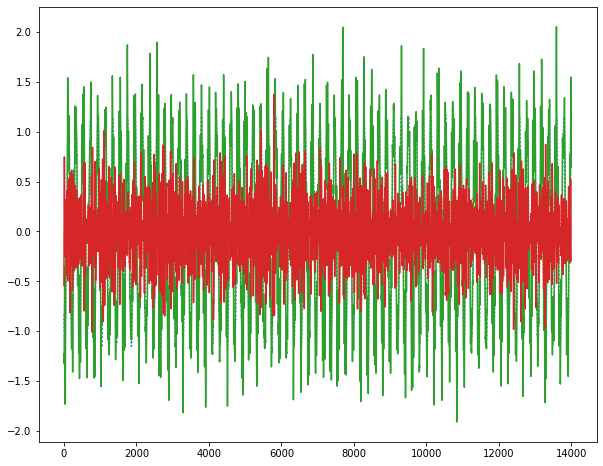

100%|██████████| 24/24 [00:00<00:00, 175.39it/s]

Epoch 2
Epoch 2 , mean error: 0.1040724 params: [DeviceArray([[11837.293  ,  -869.21185],
             [  354.96564,  8179.6733 ]], dtype=float32), DeviceArray([[ 46.275627 ,  -3.9874535],
             [-18.81899  ,  43.996483 ]], dtype=float32)]


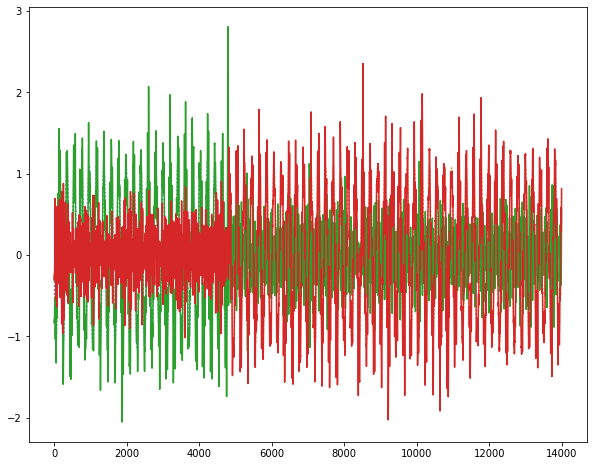

100%|██████████| 24/24 [00:00<00:00, 165.01it/s]

Epoch 3
Epoch 3 , mean error: 0.09667153 params: [DeviceArray([[12088.23   ,  -737.26215],
             [  255.83578,  7946.0815 ]], dtype=float32), DeviceArray([[66.567795 , -2.4292839],
             [ 3.2304263, 65.37682  ]], dtype=float32)]


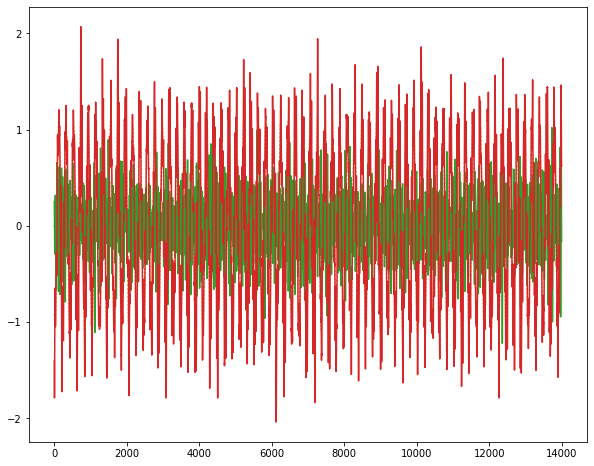

100%|██████████| 24/24 [00:00<00:00, 168.32it/s]

Epoch 4
Epoch 4 , mean error: 0.09620281 params: [DeviceArray([[12138.659  ,  -722.38586],
             [  241.402  ,  7897.5415 ]], dtype=float32), DeviceArray([[60.93087  ,  3.6992347],
             [ 2.2440677, 67.09393  ]], dtype=float32)]


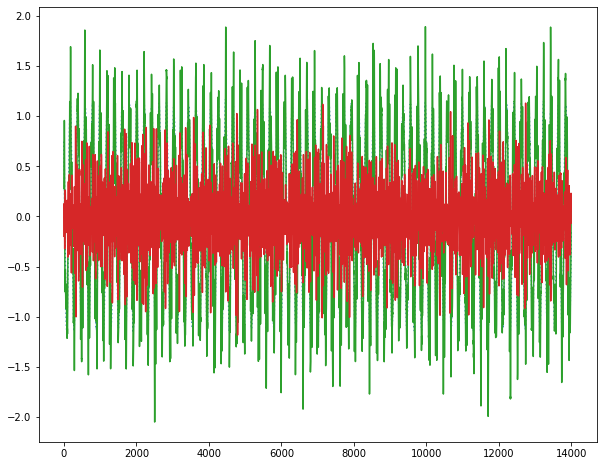

100%|██████████| 24/24 [00:00<00:00, 160.88it/s]

Epoch 5
Epoch 5 , mean error: 0.09610266 params: [DeviceArray([[12110.618  ,  -714.1665 ],
             [  221.58524,  7911.019  ]], dtype=float32), DeviceArray([[60.169273  ,  1.7136554 ],
             [ 0.82381403, 65.50466   ]], dtype=float32)]


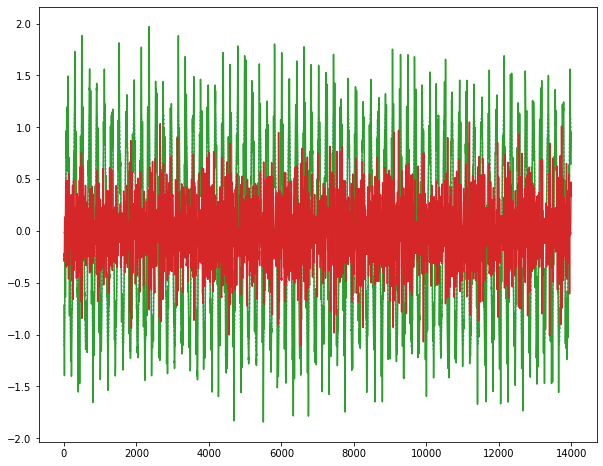

100%|██████████| 24/24 [00:00<00:00, 156.49it/s]

Epoch 6
Epoch 6 , mean error: 0.09609852 params: [DeviceArray([[12109.894  ,  -714.8644 ],
             [  212.80254,  7917.147  ]], dtype=float32), DeviceArray([[60.67784  ,  1.7929875],
             [ 1.527194 , 65.25512  ]], dtype=float32)]


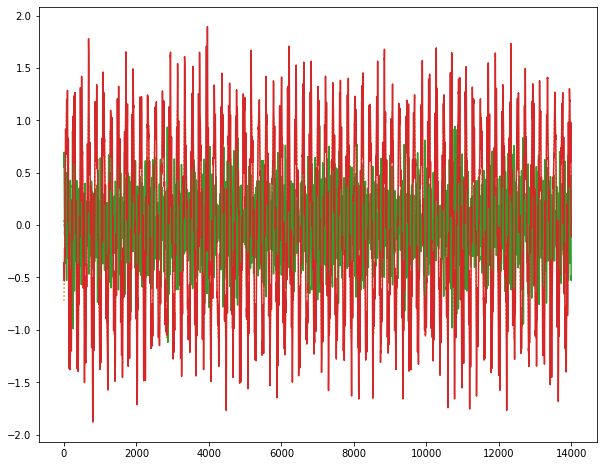

  4%|▍         | 1/24 [00:00<00:02,  8.52it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 88.48it/s]


Epoch 0 , mean error: 1.4564105 params: [DeviceArray([[ 6299.3496, -2299.0679],
             [ 1234.5325,  4685.328 ]], dtype=float32), DeviceArray([[ 285.13977,  272.80707],
             [-248.93925,  287.6173 ]], dtype=float32)]


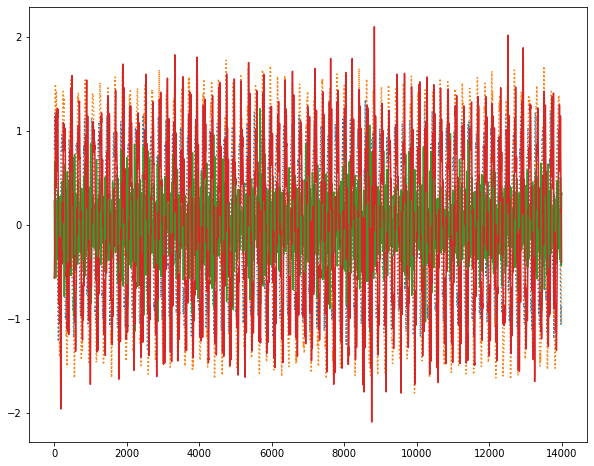

100%|██████████| 24/24 [00:00<00:00, 169.23it/s]

Epoch 1
Epoch 1 , mean error: 0.21214096 params: [DeviceArray([[7951.202 , -903.8599],
             [ 892.9857, 6961.552 ]], dtype=float32), DeviceArray([[-65.54256, -74.02074],
             [ 84.77828, -40.51575]], dtype=float32)]


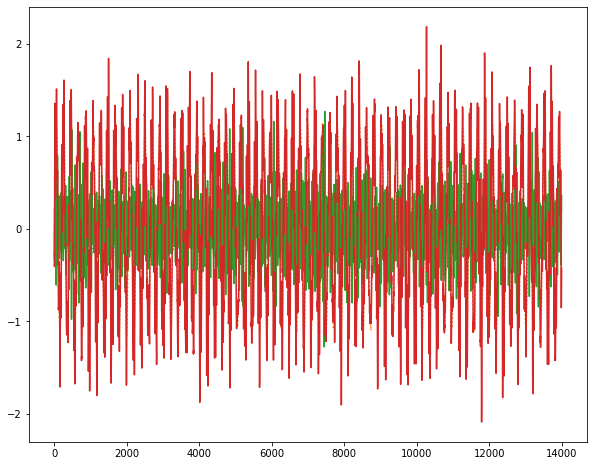

100%|██████████| 24/24 [00:00<00:00, 178.55it/s]

Epoch 2
Epoch 2 , mean error: 0.1051778 params: [DeviceArray([[7767.378  , -717.38837],
             [ 488.642  , 7746.082  ]], dtype=float32), DeviceArray([[ 28.789558 ,   5.6846037],
             [-20.848293 ,   5.8499775]], dtype=float32)]


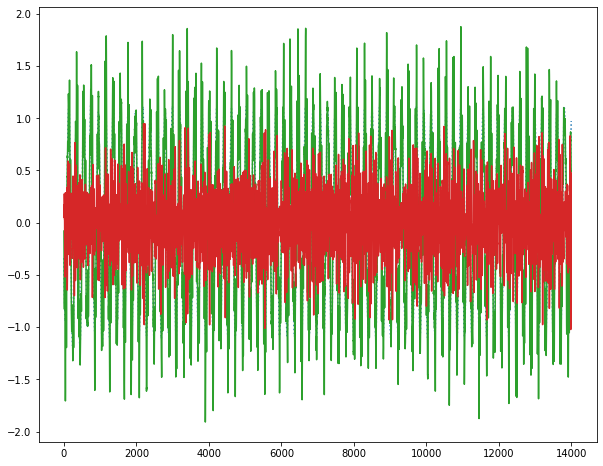

100%|██████████| 24/24 [00:00<00:00, 166.08it/s]

Epoch 3
Epoch 3 , mean error: 0.09695205 params: [DeviceArray([[7562.3223 , -714.1161 ],
             [ 422.30817, 7875.046  ]], dtype=float32), DeviceArray([[17.85101   ,  3.9854426 ],
             [ 0.44898129, 19.150822  ]], dtype=float32)]


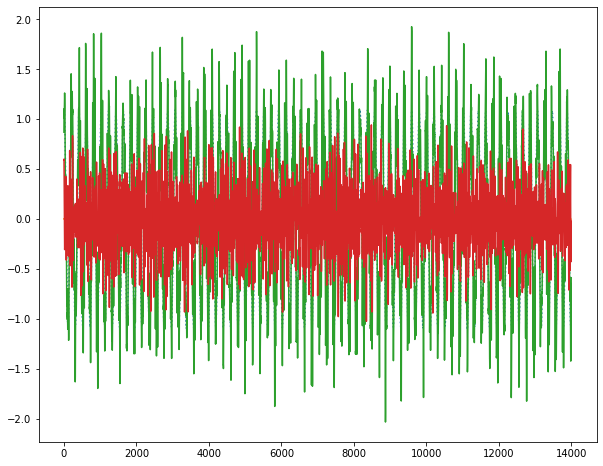

100%|██████████| 24/24 [00:00<00:00, 178.88it/s]

Epoch 4
Epoch 4 , mean error: 0.09646141 params: [DeviceArray([[7593.482  , -691.88666],
             [ 376.0449 , 7945.08   ]], dtype=float32), DeviceArray([[14.337256  , -2.099638  ],
             [ 0.01870131, 11.986166  ]], dtype=float32)]


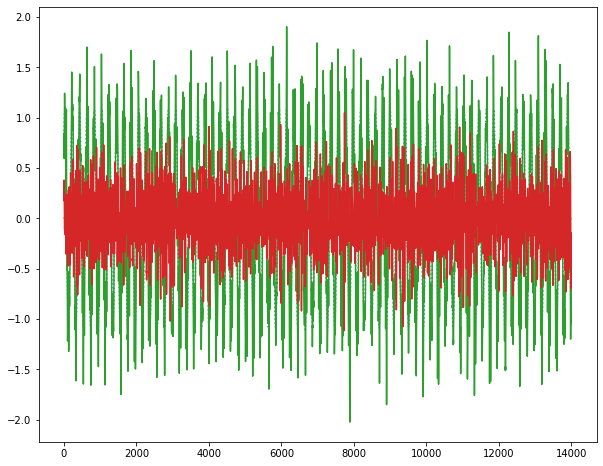

100%|██████████| 24/24 [00:00<00:00, 171.48it/s]

Epoch 5
Epoch 5 , mean error: 0.09640408 params: [DeviceArray([[7611.316  , -696.51245],
             [ 364.90393, 7971.453  ]], dtype=float32), DeviceArray([[16.60216   , -0.09369278],
             [-1.6212571 , 12.105564  ]], dtype=float32)]


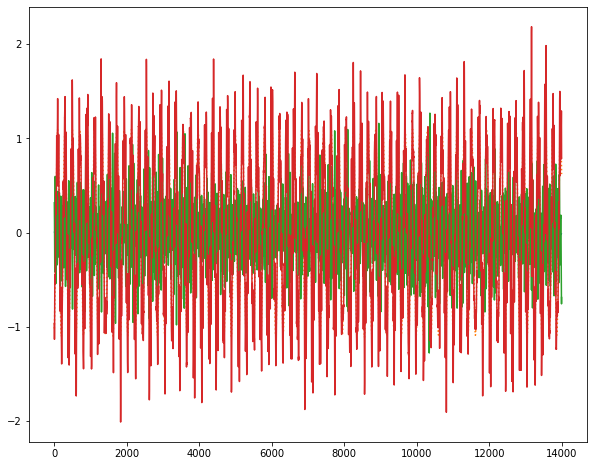

100%|██████████| 24/24 [00:00<00:00, 156.53it/s]

Epoch 6
Epoch 6 , mean error: 0.096398175 params: [DeviceArray([[7604.6445 , -701.1761 ],
             [ 362.27817, 7983.233  ]], dtype=float32), DeviceArray([[16.262554  , -0.09611607],
             [-0.9512292 , 12.453335  ]], dtype=float32)]


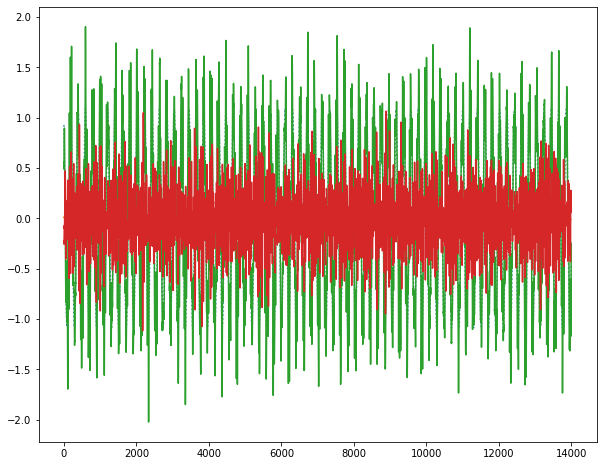

  4%|▍         | 1/24 [00:00<00:02,  9.40it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 100.14it/s]


Epoch 0 , mean error: 1.1471885 params: [DeviceArray([[13399.38    ,   -25.566528],
             [   61.059586,  6542.4004  ]], dtype=float32), DeviceArray([[ 344.59702, -262.87604],
             [-260.07654,  332.73596]], dtype=float32)]


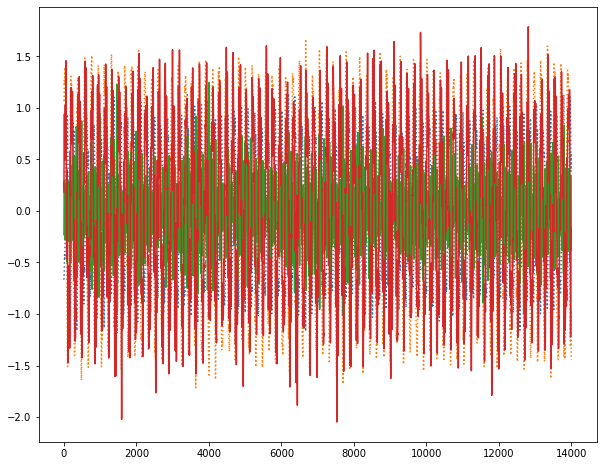

100%|██████████| 24/24 [00:00<00:00, 176.45it/s]

Epoch 1
Epoch 1 , mean error: 0.18277942 params: [DeviceArray([[12959.264  ,   161.35477],
             [  915.17993,  8185.437  ]], dtype=float32), DeviceArray([[44.77211 , 83.235344],
             [86.58451 , 52.141777]], dtype=float32)]


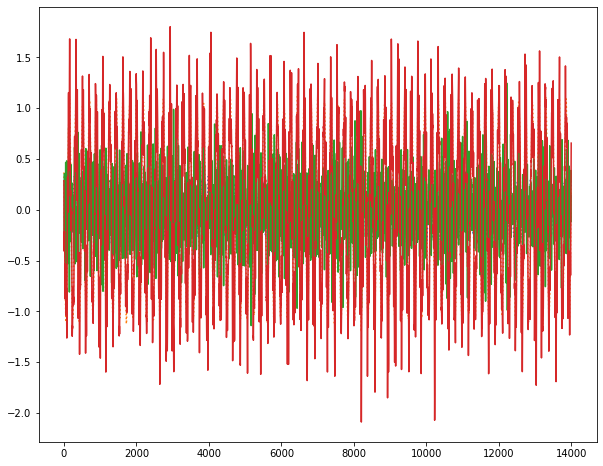

100%|██████████| 24/24 [00:00<00:00, 164.66it/s]

Epoch 2
Epoch 2 , mean error: 0.101717345 params: [DeviceArray([[12337.73   ,  -331.68738],
             [  455.29727,  8474.367  ]], dtype=float32), DeviceArray([[ 40.465546, -12.497482],
             [-13.074979,  37.239563]], dtype=float32)]


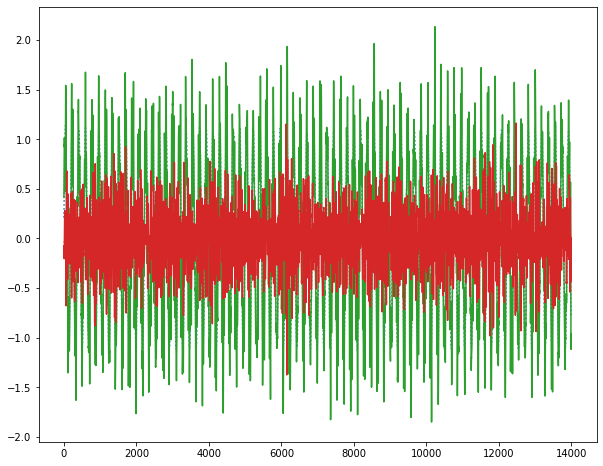

100%|██████████| 24/24 [00:00<00:00, 178.19it/s]

Epoch 3
Epoch 3 , mean error: 0.09552401 params: [DeviceArray([[12413.18  ,  -286.8541],
             [  328.542 ,  8356.154 ]], dtype=float32), DeviceArray([[64.64659   , -0.39341688],
             [ 1.5688889 , 60.536865  ]], dtype=float32)]


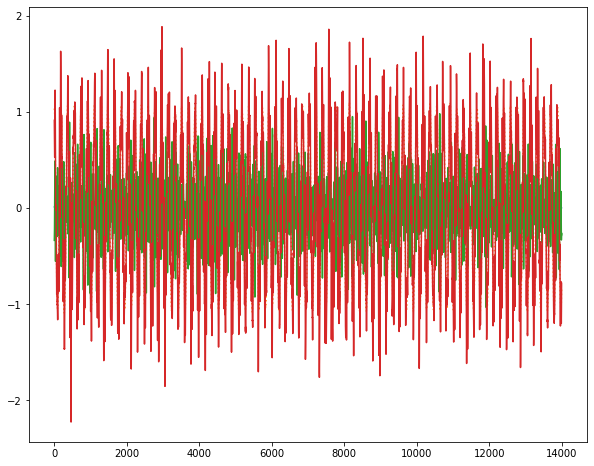

100%|██████████| 24/24 [00:00<00:00, 145.95it/s]

Epoch 4
Epoch 4 , mean error: 0.0950259 params: [DeviceArray([[12433.117  ,  -260.26877],
             [  142.31834,  8300.606  ]], dtype=float32), DeviceArray([[61.9782   ,  2.8190553],
             [ 4.3375645, 59.683277 ]], dtype=float32)]


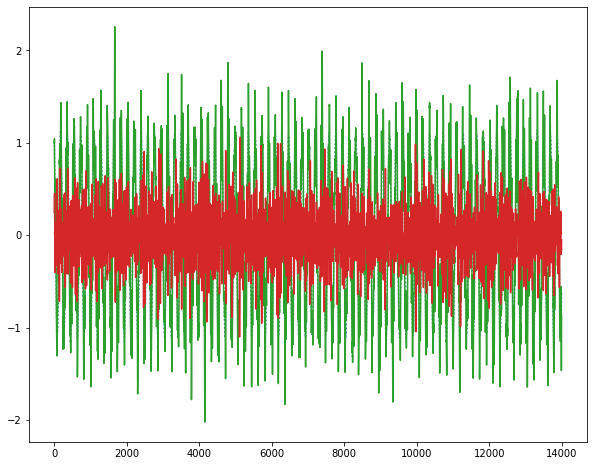

100%|██████████| 24/24 [00:00<00:00, 170.73it/s]

Epoch 5
Epoch 5 , mean error: 0.09500071 params: [DeviceArray([[12432.852   ,  -263.392   ],
             [  -29.538925,  8300.394   ]], dtype=float32), DeviceArray([[60.303493 ,  0.6040378],
             [ 2.4111326, 57.692093 ]], dtype=float32)]


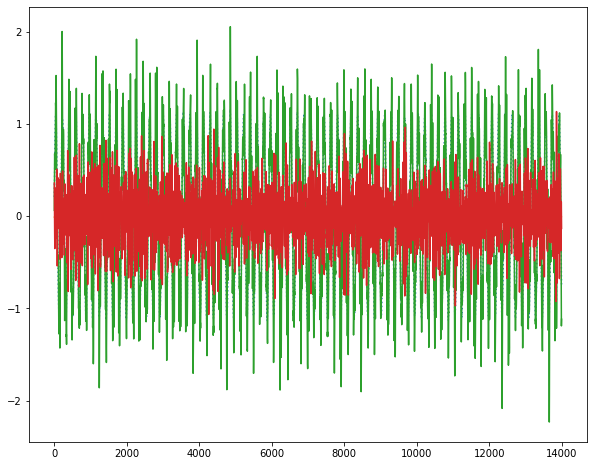

100%|██████████| 24/24 [00:00<00:00, 174.67it/s]

Epoch 6
Epoch 6 , mean error: 0.09499734 params: [DeviceArray([[12431.217  ,  -266.91534],
             [ -162.19916,  8306.478  ]], dtype=float32), DeviceArray([[60.514668 ,  1.0049654],
             [ 3.181875 , 57.43442  ]], dtype=float32)]


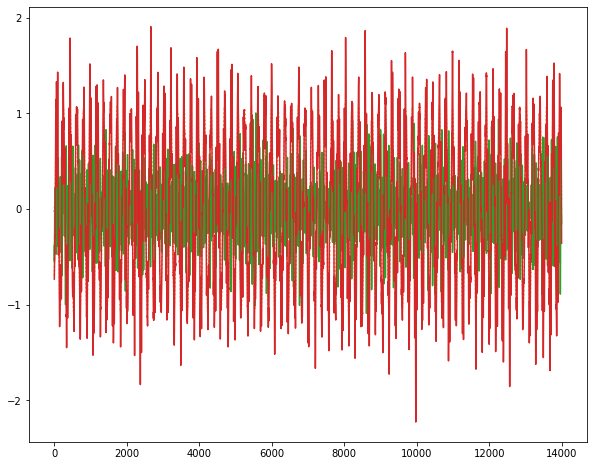

  4%|▍         | 1/24 [00:00<00:02,  9.08it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 99.49it/s]


Epoch 0 , mean error: 1.1918216 params: [DeviceArray([[ 6400.1484 , -2436.4744 ],
             [  689.73517,  7332.9365 ]], dtype=float32), DeviceArray([[ 298.89703, -258.32535],
             [ 280.78937,  289.58942]], dtype=float32)]


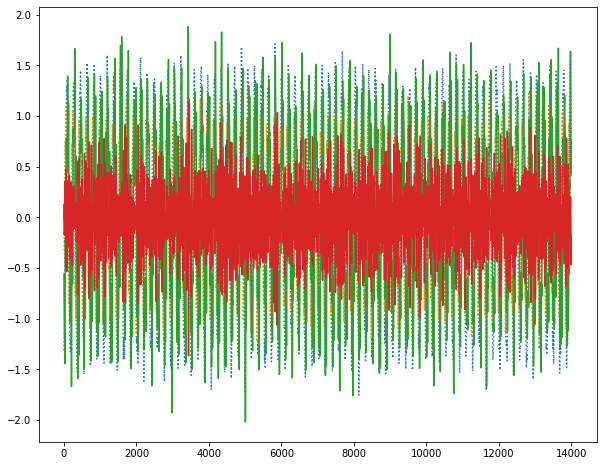

100%|██████████| 24/24 [00:00<00:00, 167.44it/s]

Epoch 1
Epoch 1 , mean error: 0.19150944 params: [DeviceArray([[7425.3423 , -801.97174],
             [1031.2133 , 7748.2524 ]], dtype=float32), DeviceArray([[-47.51556,  79.9972 ],
             [-68.29915, -58.98619]], dtype=float32)]


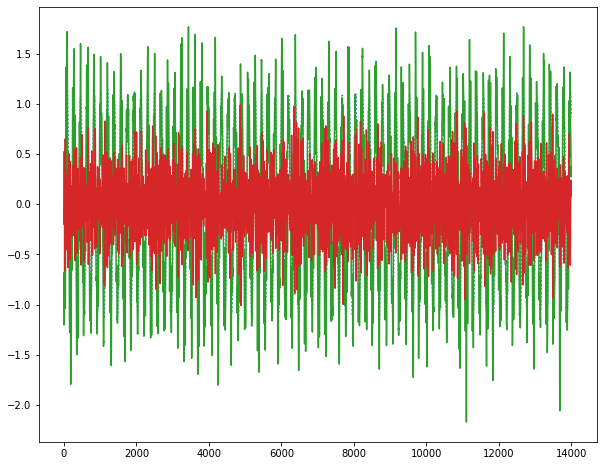

100%|██████████| 24/24 [00:00<00:00, 158.45it/s]

Epoch 2
Epoch 2 , mean error: 0.103065155 params: [DeviceArray([[7837.256  , -257.80322],
             [1255.3699 , 7951.7144 ]], dtype=float32), DeviceArray([[ 20.422956 , -23.440628 ],
             [  3.4499388,  24.046803 ]], dtype=float32)]


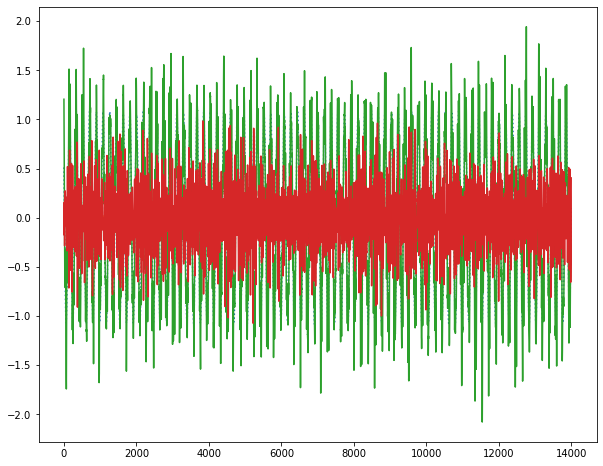

100%|██████████| 24/24 [00:00<00:00, 164.16it/s]

Epoch 3
Epoch 3 , mean error: 0.0974023 params: [DeviceArray([[7832.8477,  -66.7265],
             [1339.1259, 8065.564 ]], dtype=float32), DeviceArray([[24.660706 , -3.9689808],
             [ 5.383582 , 20.703594 ]], dtype=float32)]


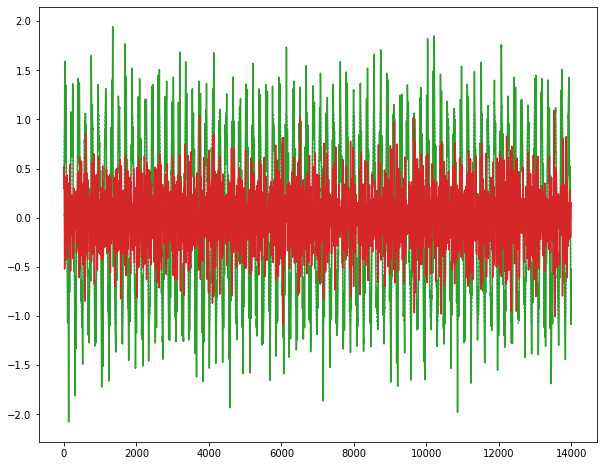

100%|██████████| 24/24 [00:00<00:00, 163.47it/s]

Epoch 4
Epoch 4 , mean error: 0.09681853 params: [DeviceArray([[7797.305  ,   36.85884],
             [1354.4756 , 8076.6997 ]], dtype=float32), DeviceArray([[17.822628 , -4.0280533],
             [-1.2693088, 14.922516 ]], dtype=float32)]


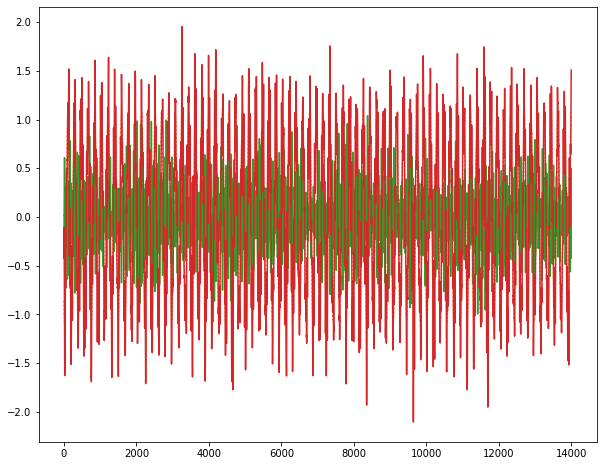

100%|██████████| 24/24 [00:00<00:00, 164.93it/s]

Epoch 5
Epoch 5 , mean error: 0.096779935 params: [DeviceArray([[7789.203  ,   89.52876],
             [1316.8704 , 8083.7676 ]], dtype=float32), DeviceArray([[19.613316 , -5.9229774],
             [ 0.5397601, 17.012957 ]], dtype=float32)]


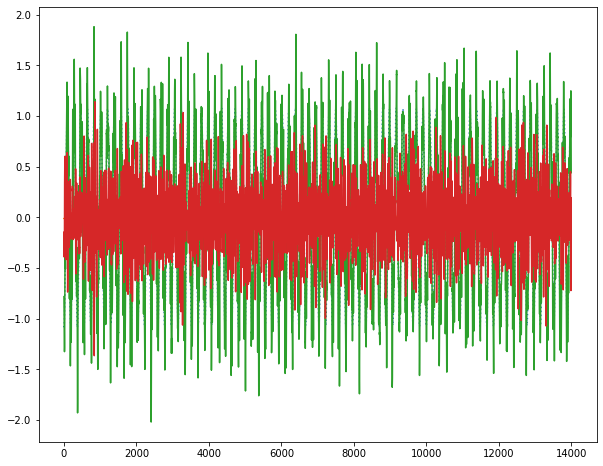

100%|██████████| 24/24 [00:00<00:00, 145.32it/s]

Epoch 6
Epoch 6 , mean error: 0.096787274 params: [DeviceArray([[7784.9116 ,  125.99686],
             [1235.3385 , 8086.8325 ]], dtype=float32), DeviceArray([[19.979788  , -5.479112  ],
             [ 0.63097763, 16.9255    ]], dtype=float32)]


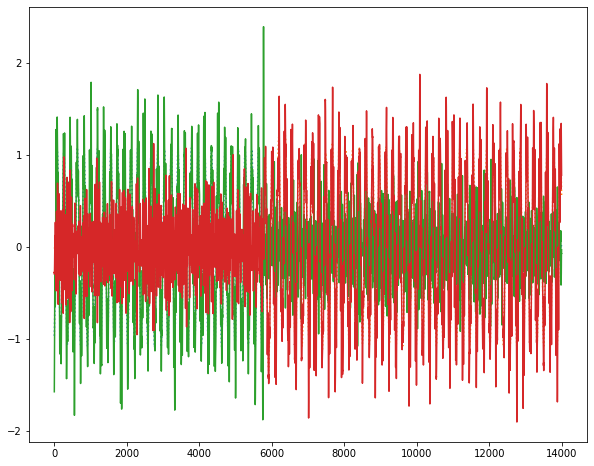

  4%|▍         | 1/24 [00:00<00:02,  8.35it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 91.07it/s]


Epoch 0 , mean error: 0.9656617 params: [DeviceArray([[13654.816 ,  1128.398 ],
             [-1057.1843,  7193.887 ]], dtype=float32), DeviceArray([[ 328.14185, -266.23718],
             [-261.08466,  334.87323]], dtype=float32)]


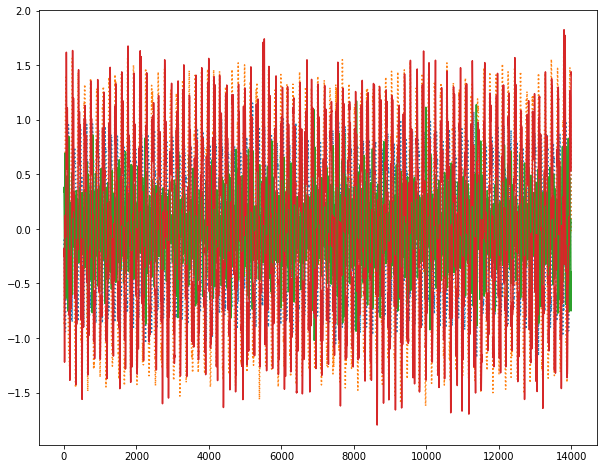

100%|██████████| 24/24 [00:00<00:00, 127.04it/s]

Epoch 1
Epoch 1 , mean error: 0.16824634 params: [DeviceArray([[13791.703  ,   403.87497],
             [  394.61722,  8278.881  ]], dtype=float32), DeviceArray([[42.6653 , 85.15282],
             [80.00981, 49.47534]], dtype=float32)]


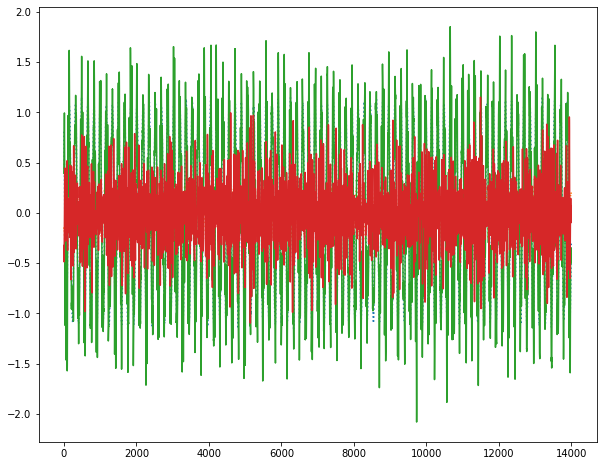

100%|██████████| 24/24 [00:00<00:00, 168.57it/s]

Epoch 2
Epoch 2 , mean error: 0.10038809 params: [DeviceArray([[12891.531 ,   509.3049],
             [  617.2266,  8413.307 ]], dtype=float32), DeviceArray([[ 30.394526, -16.923075],
             [-15.364197,  35.16978 ]], dtype=float32)]


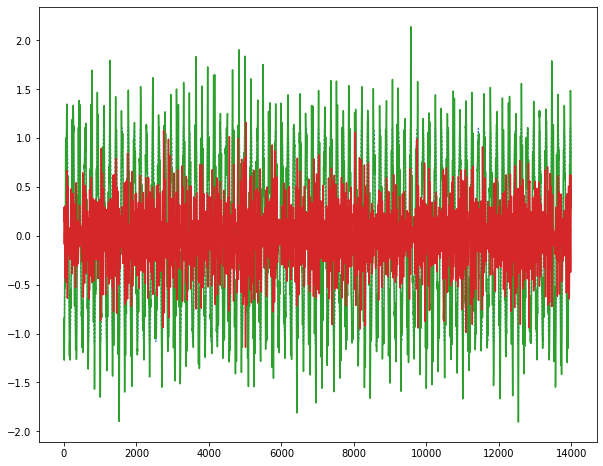

100%|██████████| 24/24 [00:00<00:00, 173.78it/s]

Epoch 3
Epoch 3 , mean error: 0.095583916 params: [DeviceArray([[12942.061  ,   563.63055],
             [  636.9746 ,  8439.745  ]], dtype=float32), DeviceArray([[54.050034  , -0.44640732],
             [-2.6630366 , 58.999573  ]], dtype=float32)]


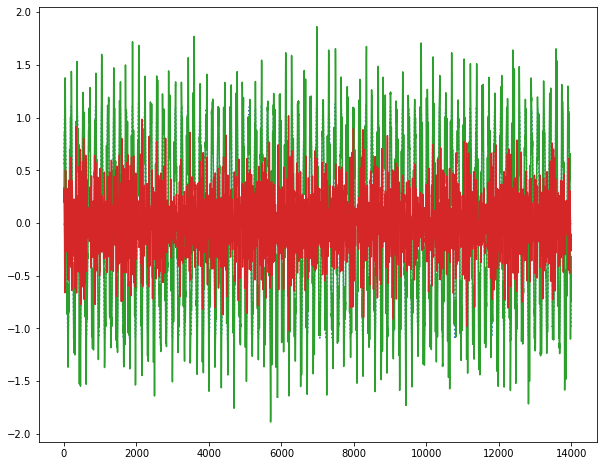

100%|██████████| 24/24 [00:00<00:00, 156.82it/s]

Epoch 4
Epoch 4 , mean error: 0.095039345 params: [DeviceArray([[13006.547  ,   602.05804],
             [  661.46796,  8426.228  ]], dtype=float32), DeviceArray([[52.796585  ,  1.07051   ],
             [ 0.24404001, 57.97576   ]], dtype=float32)]


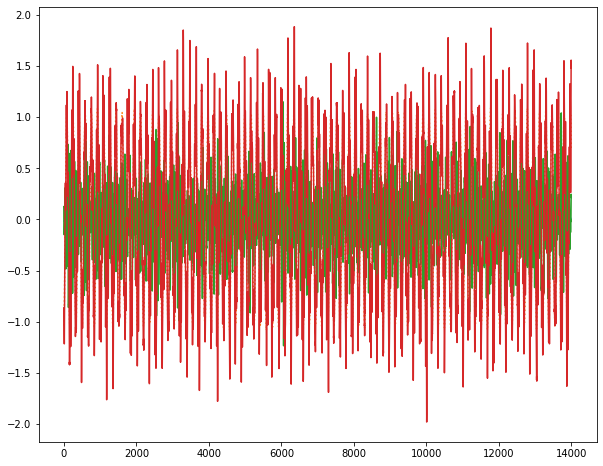

100%|██████████| 24/24 [00:00<00:00, 172.29it/s]

Epoch 5
Epoch 5 , mean error: 0.09502836 params: [DeviceArray([[13000.277 ,   581.8082],
             [  666.1506,  8417.3   ]], dtype=float32), DeviceArray([[50.90499  , -1.0224838],
             [-1.9058971, 56.05123  ]], dtype=float32)]


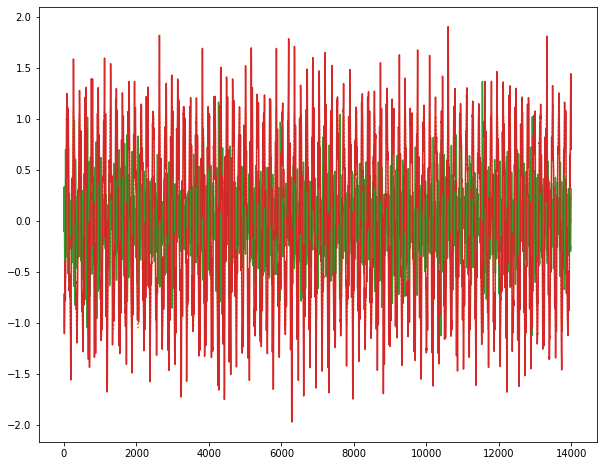

100%|██████████| 24/24 [00:00<00:00, 181.34it/s]

Epoch 6
Epoch 6 , mean error: 0.09503577 params: [DeviceArray([[12994.493 ,   520.6688],
             [  667.2209,  8414.579 ]], dtype=float32), DeviceArray([[50.826252 , -0.5279486],
             [-1.459713 , 55.93202  ]], dtype=float32)]


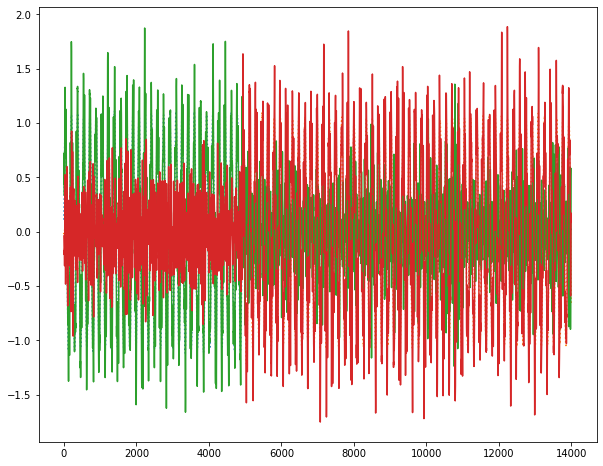

  4%|▍         | 1/24 [00:00<00:02,  8.32it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 95.24it/s]


Epoch 0 , mean error: 0.9854308 params: [DeviceArray([[6224.799  , -566.99164],
             [ 395.2347 , 6241.0024 ]], dtype=float32), DeviceArray([[ 291.41995, -264.4897 ],
             [-262.31598,  289.43048]], dtype=float32)]


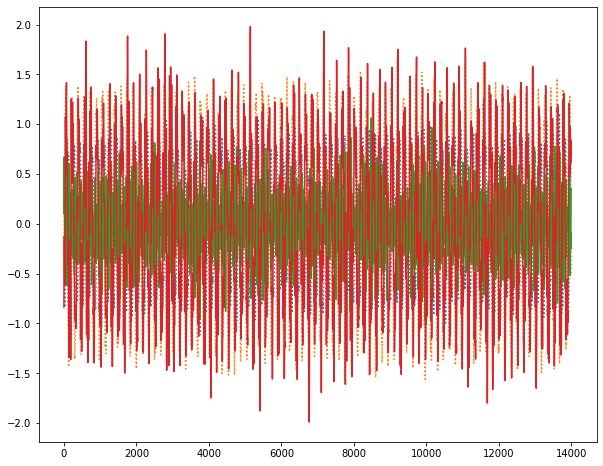

100%|██████████| 24/24 [00:00<00:00, 179.54it/s]

Epoch 1
Epoch 1 , mean error: 0.16952133 params: [DeviceArray([[8346.582  ,   57.30928],
             [ 670.80884, 7564.8975 ]], dtype=float32), DeviceArray([[-53.271866,  70.56798 ],
             [ 83.16834 , -41.84377 ]], dtype=float32)]


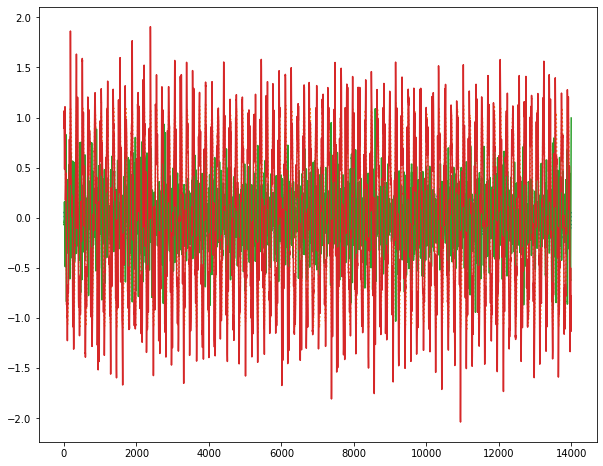

100%|██████████| 24/24 [00:00<00:00, 154.03it/s]

Epoch 2
Epoch 2 , mean error: 0.10052397 params: [DeviceArray([[8358.252  ,   66.37299],
             [ 882.6361 , 7896.7583 ]], dtype=float32), DeviceArray([[28.847786 , -4.4677267],
             [-7.1641054,  9.984514 ]], dtype=float32)]


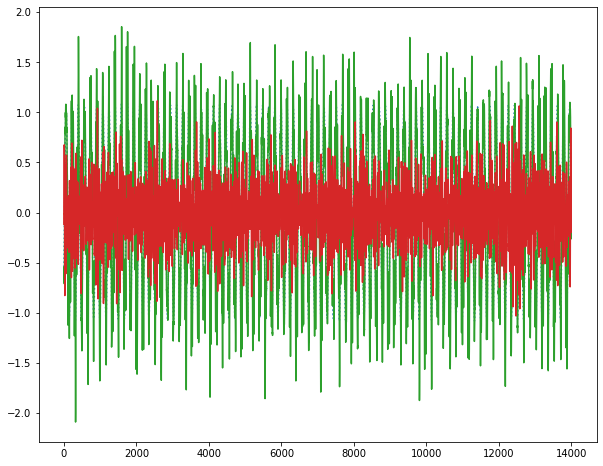

100%|██████████| 24/24 [00:00<00:00, 159.57it/s]

Epoch 3
Epoch 3 , mean error: 0.09535239 params: [DeviceArray([[ 8.2902646e+03, -5.5395813e+00],
             [ 1.0650303e+03,  7.9021533e+03]], dtype=float32), DeviceArray([[25.986818 , -4.530257 ],
             [ 0.8647287, 20.94587  ]], dtype=float32)]


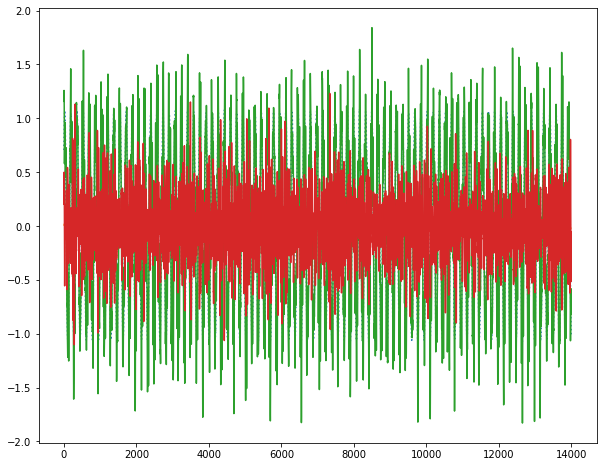

100%|██████████| 24/24 [00:00<00:00, 160.08it/s]

Epoch 4
Epoch 4 , mean error: 0.094990455 params: [DeviceArray([[8257.162   ,  -18.986221],
             [1192.0378  , 7835.5063  ]], dtype=float32), DeviceArray([[20.120827 ,  1.8701391],
             [ 5.5328994, 13.875001 ]], dtype=float32)]


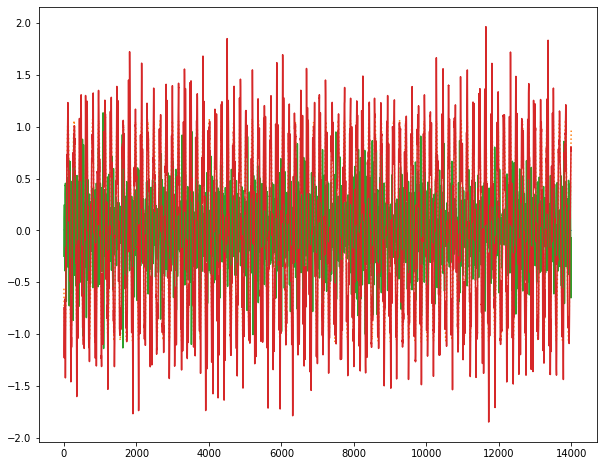

100%|██████████| 24/24 [00:00<00:00, 167.58it/s]

Epoch 5
Epoch 5 , mean error: 0.09497162 params: [DeviceArray([[8242.836  ,  -53.44104],
             [1336.2897 , 7830.3955 ]], dtype=float32), DeviceArray([[22.163462  ,  0.16247532],
             [ 3.349047  , 14.676867  ]], dtype=float32)]


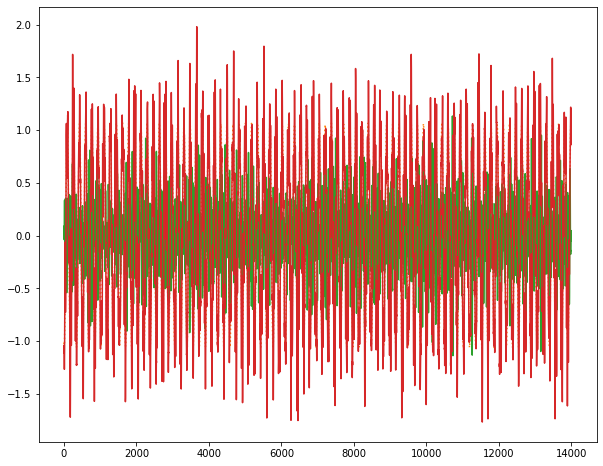

100%|██████████| 24/24 [00:00<00:00, 172.26it/s]

Epoch 6
Epoch 6 , mean error: 0.09496487 params: [DeviceArray([[8241.554  ,  -83.96681],
             [1447.6237 , 7836.5464 ]], dtype=float32), DeviceArray([[22.112951  ,  0.17726538],
             [ 3.67993   , 15.225074  ]], dtype=float32)]


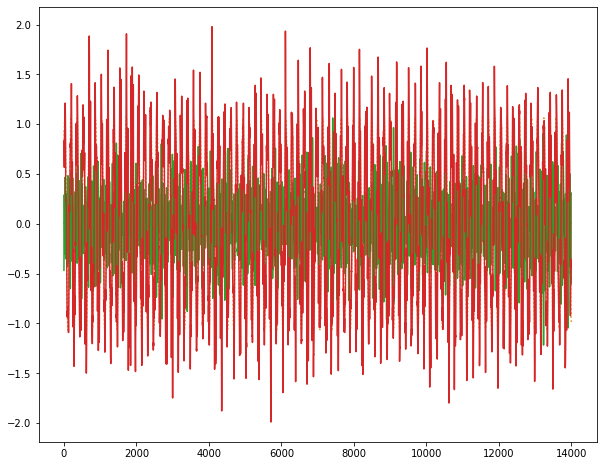

  4%|▍         | 1/24 [00:00<00:02,  8.00it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 88.88it/s]


Epoch 0 , mean error: 0.81513184 params: [DeviceArray([[13780.916 , -1462.7738],
             [-1430.1406,  6656.673 ]], dtype=float32), DeviceArray([[ 319.48065, -246.47348],
             [ 280.80978,  343.12827]], dtype=float32)]


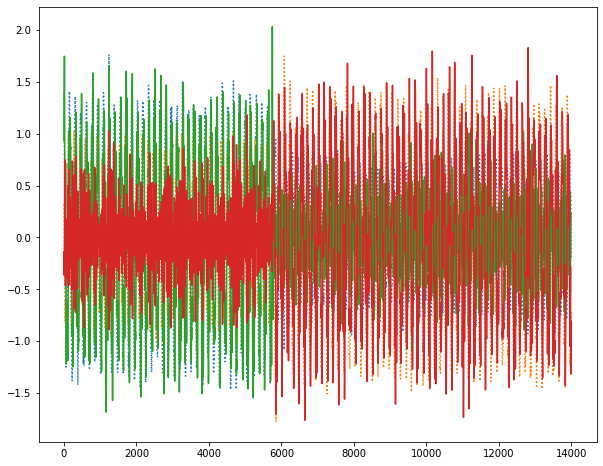

100%|██████████| 24/24 [00:00<00:00, 163.29it/s]

Epoch 1
Epoch 1 , mean error: 0.15412374 params: [DeviceArray([[14067.951  ,  -967.7766 ],
             [  105.31528,  8497.888  ]], dtype=float32), DeviceArray([[ 66.52934 ,  87.209694],
             [-59.18067 ,  36.058083]], dtype=float32)]


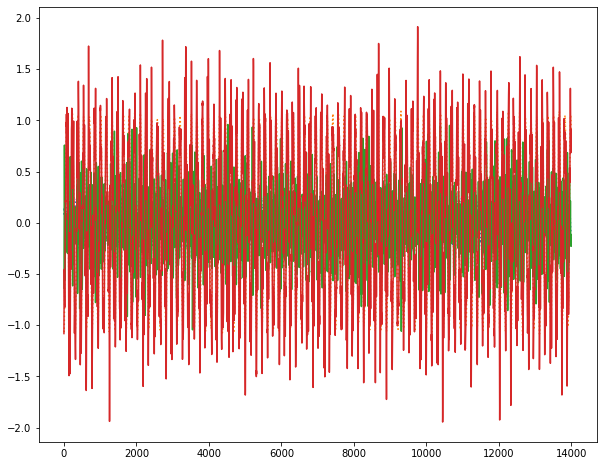

100%|██████████| 24/24 [00:00<00:00, 147.20it/s]

Epoch 2
Epoch 2 , mean error: 0.09910234 params: [DeviceArray([[12625.729 ,  -391.8183],
             [  625.7937,  8573.417 ]], dtype=float32), DeviceArray([[ 34.394253, -21.6286  ],
             [ -5.836606,  43.721966]], dtype=float32)]


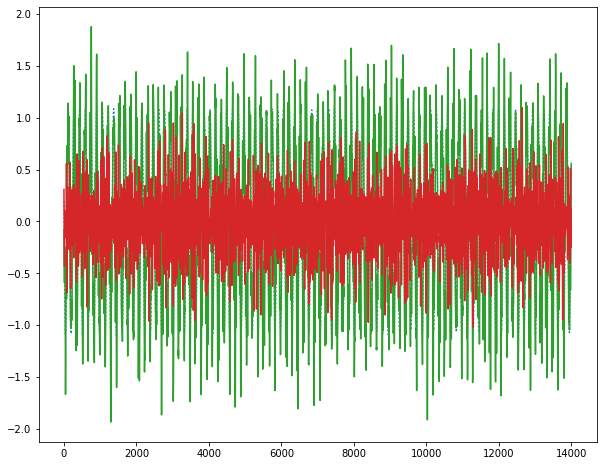

100%|██████████| 24/24 [00:00<00:00, 169.82it/s]

Epoch 3
Epoch 3 , mean error: 0.09528005 params: [DeviceArray([[13010.578  ,  -209.03381],
             [  644.97534,  8449.512  ]], dtype=float32), DeviceArray([[55.18467  ,  0.9149704],
             [ 4.1641874, 66.87504  ]], dtype=float32)]


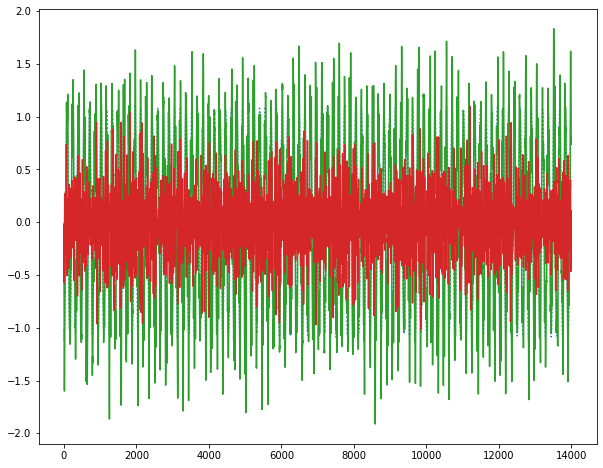

100%|██████████| 24/24 [00:00<00:00, 158.63it/s]

Epoch 4
Epoch 4 , mean error: 0.09489715 params: [DeviceArray([[13018.489   ,  -120.404495],
             [  686.19336 ,  8435.823   ]], dtype=float32), DeviceArray([[56.9163    ,  0.18803358],
             [-3.05663   , 63.07448   ]], dtype=float32)]


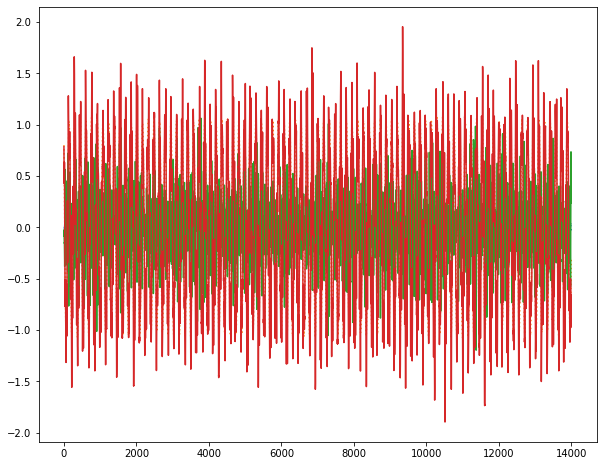

100%|██████████| 24/24 [00:00<00:00, 168.17it/s]

Epoch 5
Epoch 5 , mean error: 0.09486272 params: [DeviceArray([[12982.83    ,   -90.135864],
             [  688.9617  ,  8447.76    ]], dtype=float32), DeviceArray([[55.07005  , -1.484014 ],
             [-2.0029714, 61.896225 ]], dtype=float32)]


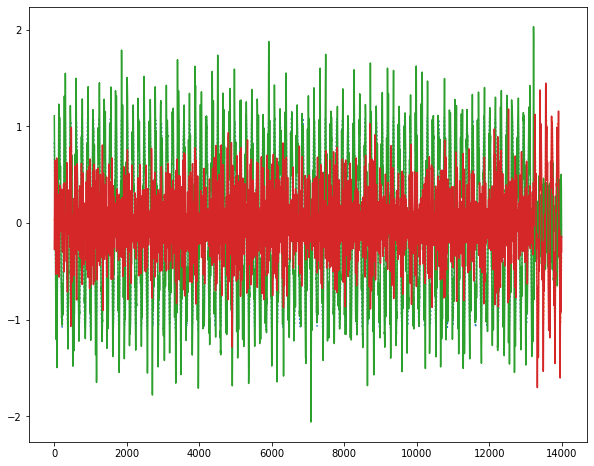

100%|██████████| 24/24 [00:00<00:00, 166.79it/s]

Epoch 6
Epoch 6 , mean error: 0.09486449 params: [DeviceArray([[12991.303  ,   -83.29217],
             [  680.70807,  8453.369  ]], dtype=float32), DeviceArray([[54.42482   , -0.85191333],
             [-1.5742692 , 62.528446  ]], dtype=float32)]


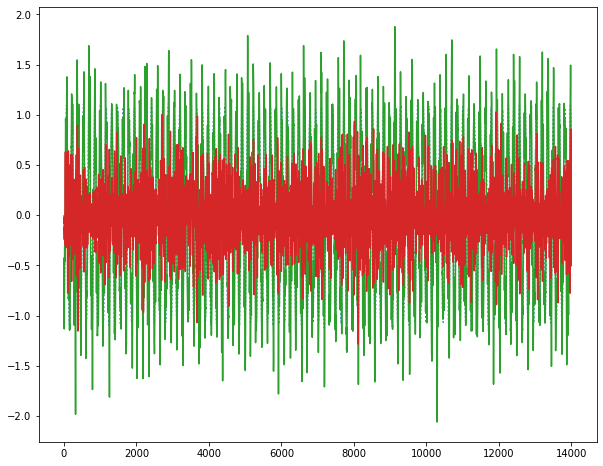

  0%|          | 0/24 [00:00<?, ?it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 56.87it/s]


Epoch 0 , mean error: 0.8706536 params: [DeviceArray([[ 6903.7734 , -1081.3933 ],
             [ -568.13055,  8402.158  ]], dtype=float32), DeviceArray([[ 298.6452 , -245.22832],
             [ 269.92053,  285.82574]], dtype=float32)]


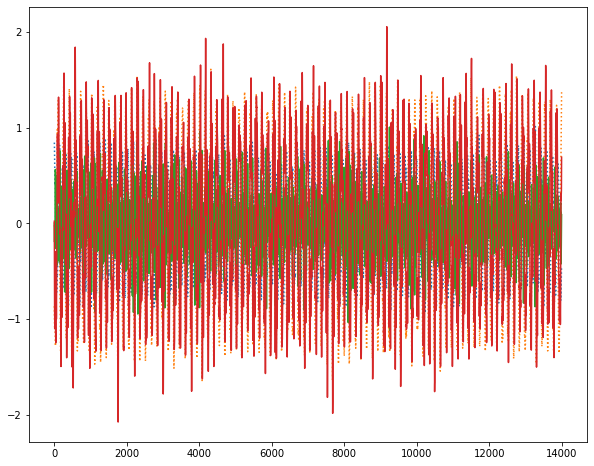

100%|██████████| 24/24 [00:00<00:00, 145.23it/s]

Epoch 1
Epoch 1 , mean error: 0.16513027 params: [DeviceArray([[9540.519  , -506.93515],
             [ 675.0674 , 8146.491  ]], dtype=float32), DeviceArray([[-61.6376  ,  94.177216],
             [-85.01512 , -65.097206]], dtype=float32)]


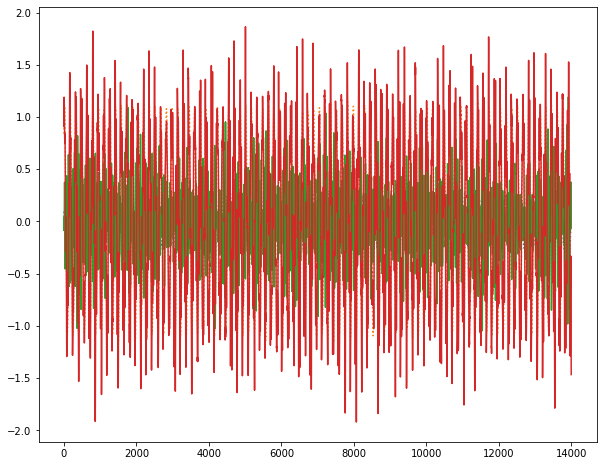

100%|██████████| 24/24 [00:00<00:00, 139.48it/s]

Epoch 2
Epoch 2 , mean error: 0.10059937 params: [DeviceArray([[8454.065  , -493.57245],
             [ 146.16547, 8059.721  ]], dtype=float32), DeviceArray([[ 26.80114 , -14.538666],
             [ 21.006477,  33.330288]], dtype=float32)]


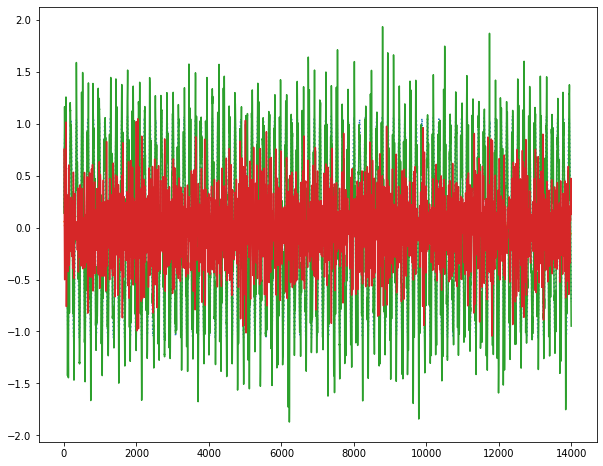

100%|██████████| 24/24 [00:00<00:00, 174.45it/s]

Epoch 3
Epoch 3 , mean error: 0.095912196 params: [DeviceArray([[8392.221   , -626.7008  ],
             [ -58.156403, 8164.7188  ]], dtype=float32), DeviceArray([[20.616177 ,  7.4212804],
             [ 1.2924035, 20.891382 ]], dtype=float32)]


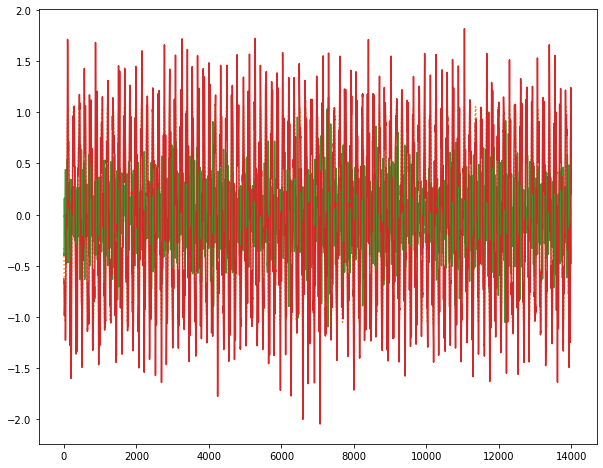

100%|██████████| 24/24 [00:00<00:00, 177.61it/s]

Epoch 4
Epoch 4 , mean error: 0.09550047 params: [DeviceArray([[8496.529  , -609.2436 ],
             [-152.69205, 8164.193  ]], dtype=float32), DeviceArray([[15.730672 ,  6.7312813],
             [ 1.0835204, 17.53954  ]], dtype=float32)]


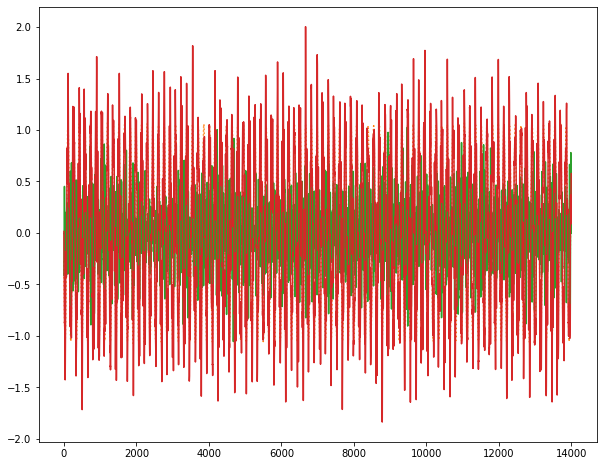

100%|██████████| 24/24 [00:00<00:00, 172.99it/s]

Epoch 5
Epoch 5 , mean error: 0.09546862 params: [DeviceArray([[8479.989  , -588.48596],
             [-210.76556, 8191.3486 ]], dtype=float32), DeviceArray([[18.148993 ,  4.950024 ],
             [ 2.9288995, 19.788692 ]], dtype=float32)]


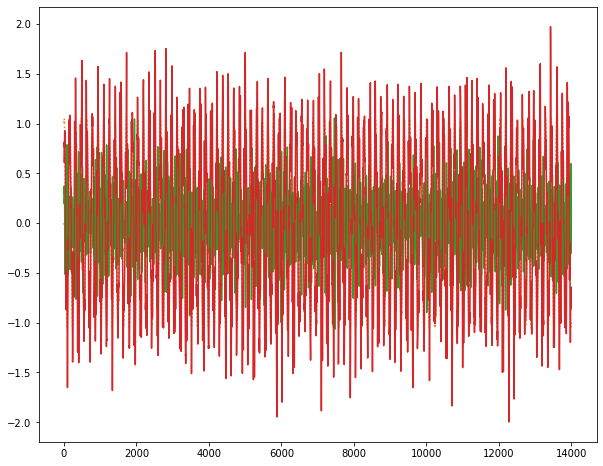

100%|██████████| 24/24 [00:00<00:00, 164.62it/s]

Epoch 6
Epoch 6 , mean error: 0.09547316 params: [DeviceArray([[8474.796  , -553.5048 ],
             [-222.57925, 8214.259  ]], dtype=float32), DeviceArray([[18.07922  ,  5.4858627],
             [ 2.3291533, 19.387026 ]], dtype=float32)]


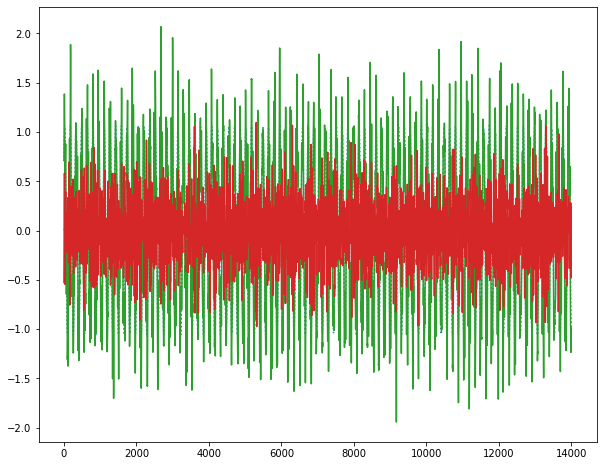

  4%|▍         | 1/24 [00:00<00:02,  7.89it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 77.49it/s]


Epoch 0 , mean error: 0.70575505 params: [DeviceArray([[16307.66   ,   369.83035],
             [ 2744.4482 ,  8317.523  ]], dtype=float32), DeviceArray([[339.5208 , 242.98758],
             [285.4228 , 342.4359 ]], dtype=float32)]


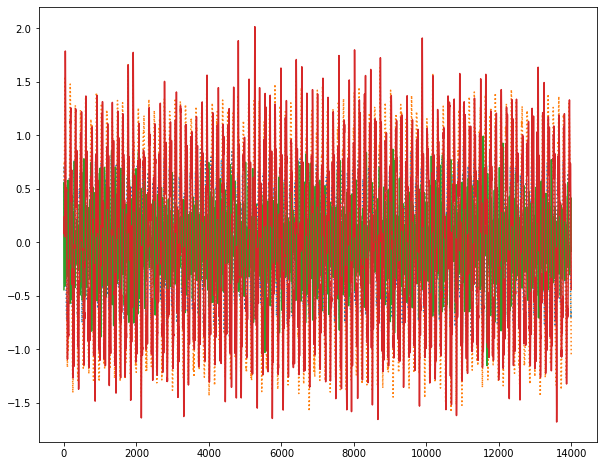

100%|██████████| 24/24 [00:00<00:00, 135.77it/s]

Epoch 1
Epoch 1 , mean error: 0.14662407 params: [DeviceArray([[13639.926  ,   337.34714],
             [ 2068.188  ,  8870.597  ]], dtype=float32), DeviceArray([[ 44.262222, -87.40115 ],
             [-28.914177,  41.093063]], dtype=float32)]


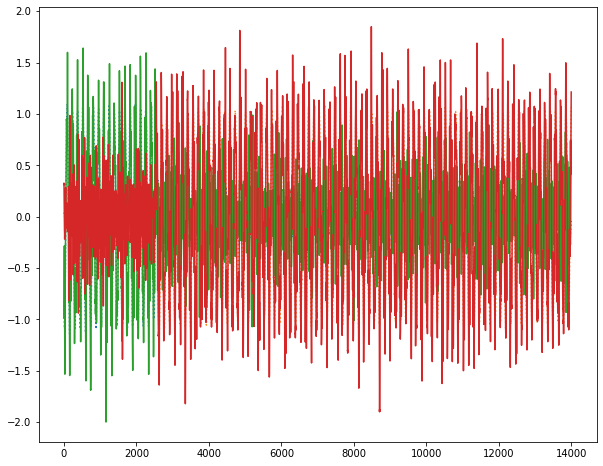

100%|██████████| 24/24 [00:00<00:00, 169.73it/s]

Epoch 2
Epoch 2 , mean error: 0.09900329 params: [DeviceArray([[13021.545  ,   397.36273],
             [ 1355.4412 ,  8756.505  ]], dtype=float32), DeviceArray([[ 35.24451 ,  12.567194],
             [-16.234718,  41.639854]], dtype=float32)]


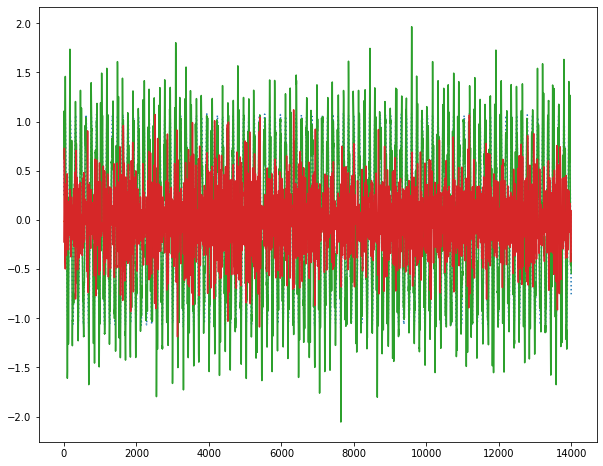

100%|██████████| 24/24 [00:00<00:00, 153.51it/s]

Epoch 3
Epoch 3 , mean error: 0.095694065 params: [DeviceArray([[13478.196  ,   591.96985],
             [ 1161.2183 ,  8847.673  ]], dtype=float32), DeviceArray([[60.755775, -5.801875],
             [ 5.54393 , 65.21736 ]], dtype=float32)]


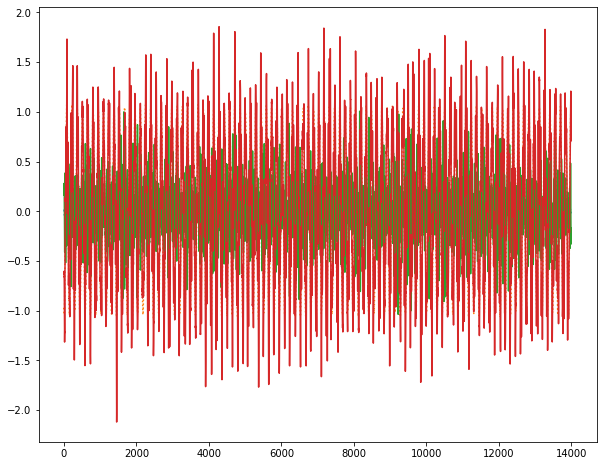

100%|██████████| 24/24 [00:00<00:00, 170.11it/s]

Epoch 4
Epoch 4 , mean error: 0.09538888 params: [DeviceArray([[13375.351 ,   657.2559],
             [ 1133.3693,  8807.602 ]], dtype=float32), DeviceArray([[58.356693  , -6.3739624 ],
             [ 0.51638186, 61.879402  ]], dtype=float32)]


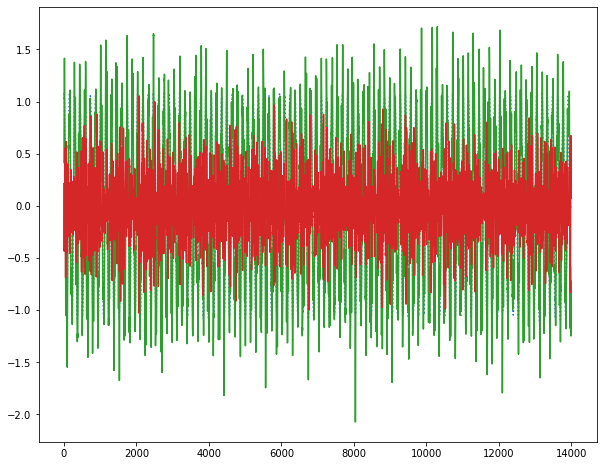

100%|██████████| 24/24 [00:00<00:00, 156.51it/s]

Epoch 5
Epoch 5 , mean error: 0.09535077 params: [DeviceArray([[13378.8125 ,   633.96625],
             [ 1098.2947 ,  8812.473  ]], dtype=float32), DeviceArray([[56.536526 , -4.9652686],
             [-0.632794 , 60.16062  ]], dtype=float32)]


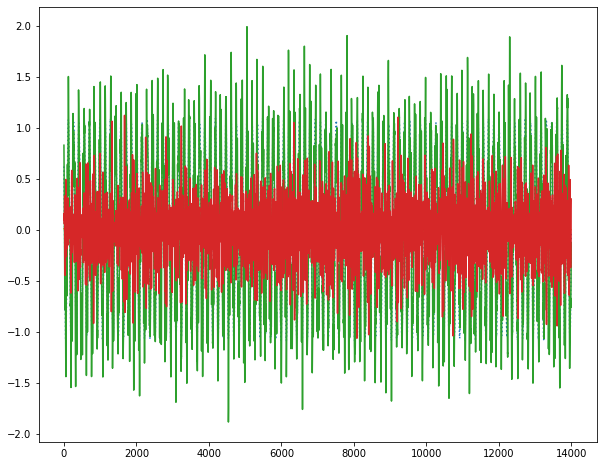

100%|██████████| 24/24 [00:00<00:00, 176.02it/s]

Epoch 6
Epoch 6 , mean error: 0.09535431 params: [DeviceArray([[13384.568  ,   550.04364],
             [ 1064.0583 ,  8829.343  ]], dtype=float32), DeviceArray([[56.745686 , -5.8359456],
             [-0.2973125, 60.306858 ]], dtype=float32)]


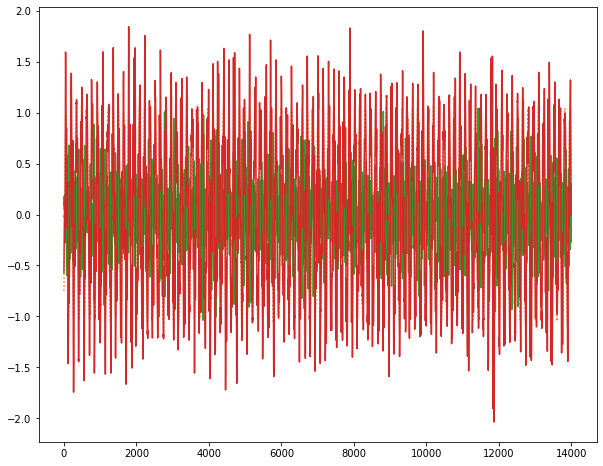

  4%|▍         | 1/24 [00:00<00:02,  9.01it/s]

Epoch 0


100%|██████████| 24/24 [00:00<00:00, 99.52it/s]


Epoch 0 , mean error: 0.76069355 params: [DeviceArray([[7513.276  , -898.2082 ],
             [-247.22789, 9823.669  ]], dtype=float32), DeviceArray([[ 292.31888, -261.79553],
             [-265.8964 ,  288.64844]], dtype=float32)]


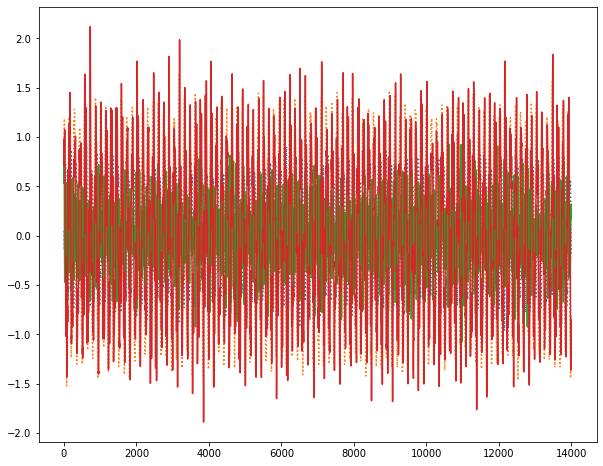

100%|██████████| 24/24 [00:00<00:00, 177.02it/s]

Epoch 1
Epoch 1 , mean error: 0.15588768 params: [DeviceArray([[ 9773.233 ,  -744.0408],
             [-1190.1666, 11128.221 ]], dtype=float32), DeviceArray([[-56.114838,  85.7099  ],
             [ 80.89919 , -65.563416]], dtype=float32)]


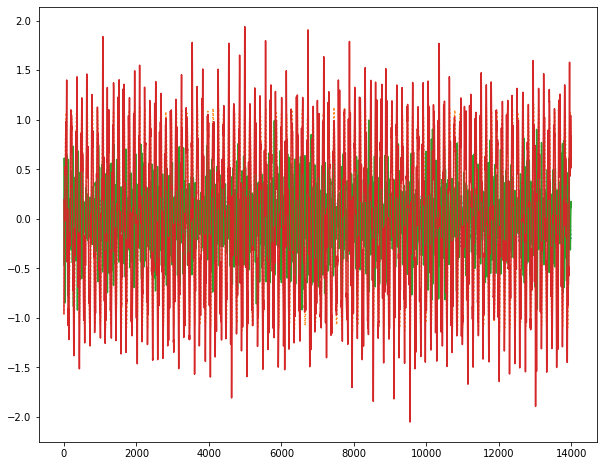

100%|██████████| 24/24 [00:00<00:00, 168.67it/s]

Epoch 2
Epoch 2 , mean error: 0.100837864 params: [DeviceArray([[8592.883  ,  -65.58707],
             [-624.98694, 9800.595  ]], dtype=float32), DeviceArray([[ 26.630014, -22.742558],
             [-21.092976,  28.969463]], dtype=float32)]


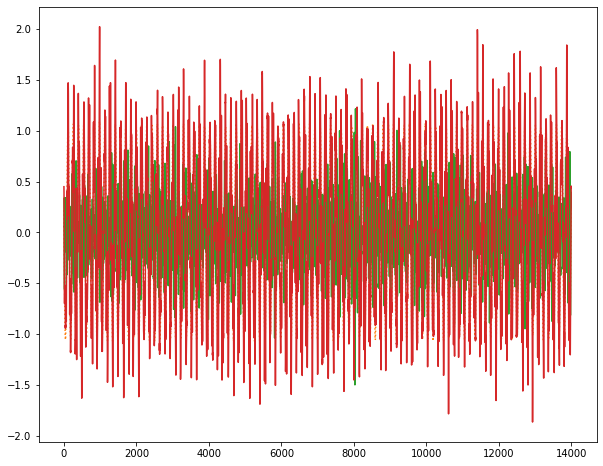

100%|██████████| 24/24 [00:00<00:00, 174.51it/s]

Epoch 3
Epoch 3 , mean error: 0.09697604 params: [DeviceArray([[8666.077  , -197.1104 ],
             [-557.38556, 9777.885  ]], dtype=float32), DeviceArray([[23.905684 ,  0.9758992],
             [-4.4466233, 17.789248 ]], dtype=float32)]


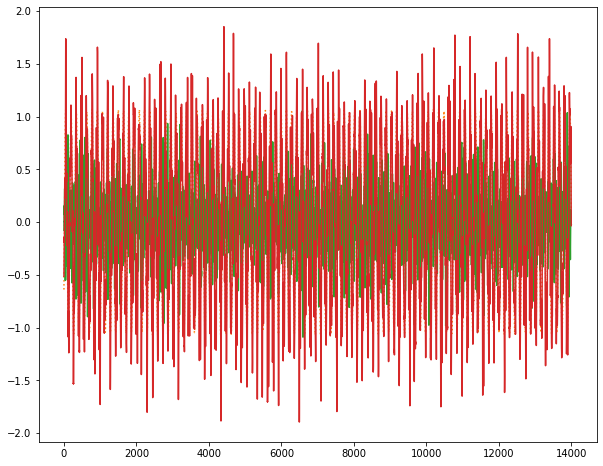

100%|██████████| 24/24 [00:00<00:00, 174.40it/s]

Epoch 4
Epoch 4 , mean error: 0.09664041 params: [DeviceArray([[8776.078  , -209.49928],
             [-480.558  , 9761.269  ]], dtype=float32), DeviceArray([[17.86287  , -1.2192123],
             [-2.8824177, 14.454253 ]], dtype=float32)]


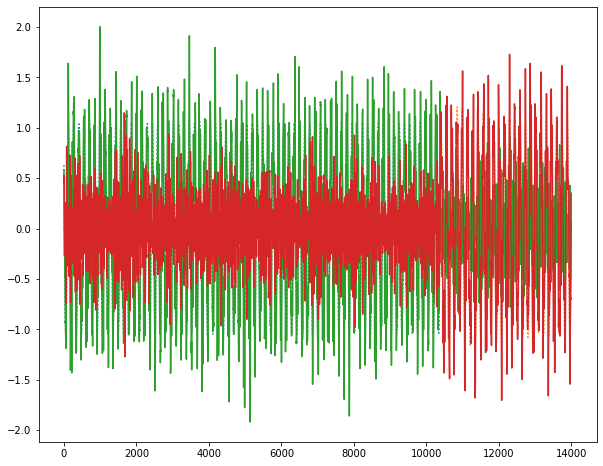

100%|██████████| 24/24 [00:00<00:00, 177.85it/s]

Epoch 5
Epoch 5 , mean error: 0.09660822 params: [DeviceArray([[8762.269  , -205.2124 ],
             [-431.98962, 9689.219  ]], dtype=float32), DeviceArray([[19.93143 , -2.519916],
             [-4.988607, 16.747702]], dtype=float32)]


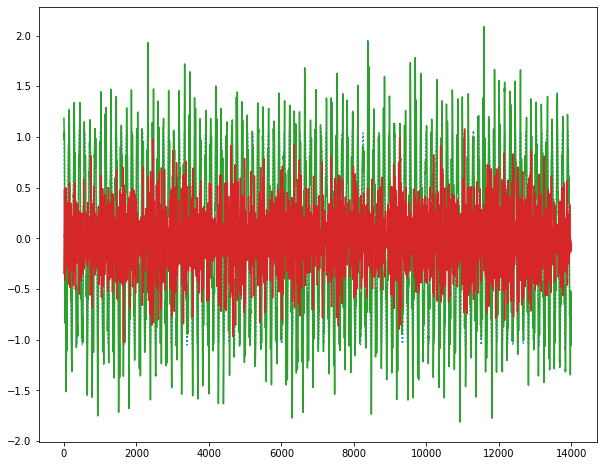

100%|██████████| 24/24 [00:00<00:00, 173.11it/s]

Epoch 6
Epoch 6 , mean error: 0.09661452 params: [DeviceArray([[8776.755  , -202.2998 ],
             [-410.66675, 9643.542  ]], dtype=float32), DeviceArray([[19.86771  , -2.0586164],
             [-4.489352 , 16.416365 ]], dtype=float32)]


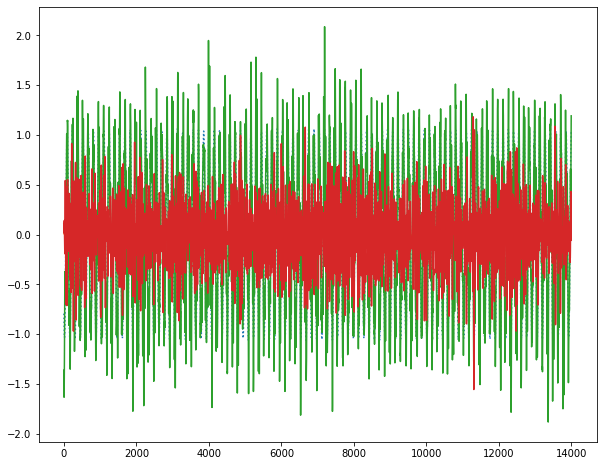

In [91]:
Cs = []
Ks = []
Fs = []

for freq in df_.freq.unique():
    
    sel_df = df_[(df_.seal == True) &  (df_.freq == freq)]
    with_seal = optimization_estimate(sel_df)
    
    sel_df = df_[(df_.seal == False) &  (df_.freq == freq)]
    wo_seal = optimization_estimate(sel_df)

    C = with_seal["C"] - wo_seal["C"]
    K = with_seal["K"] - wo_seal["K"]
    
    Cs.append(C)
    Ks.append(K)
    Fs.append(freq)
    
Cs = np.array(Cs)
Ks = np.array(Ks)
Fs = np.array(Fs)

In [92]:
2**13

8192

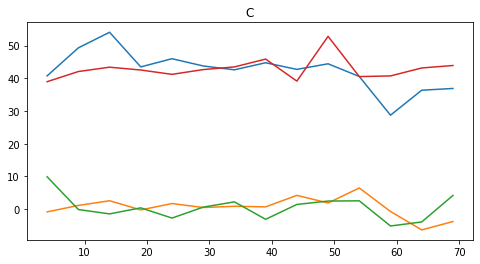

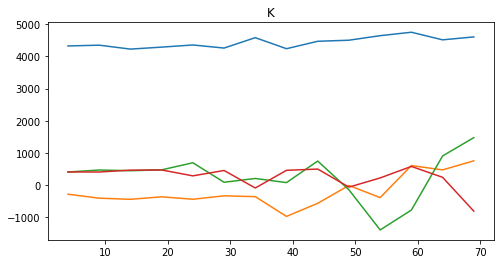

In [95]:
plt.figure(figsize=(8,4))
plt.title("C")
plt.plot(Fs, Cs[:, 0, 0])
plt.plot(Fs, Cs[:, 0, 1])
plt.plot(Fs, Cs[:, 1, 0])
plt.plot(Fs, Cs[:, 1, 1])
plt.show()


plt.figure(figsize=(8,4))
plt.title("K")
plt.plot(Fs, Ks[:, 0, 0])
plt.plot(Fs, Ks[:, 0, 1])
plt.plot(Fs, Ks[:, 1, 0])
plt.plot(Fs, Ks[:, 1, 1])
plt.show()

In [97]:
Ks.shape

(14, 2, 2)

In [100]:
Fs

array([ 4,  9, 14, 19, 24, 29, 34, 39, 44, 49, 54, 59, 64, 69])

In [99]:
df

,Unnamed: 0,t,x,y,fx,fy,freq,axis,seal,episode
0,0,0.0000,6.848546e-07,-6.186171e-07,-0.058351,-0.019020,4,x,True,0
1,1,0.0001,-7.602323e-07,1.305000e-06,0.015808,0.008943,4,x,True,0
2,2,0.0002,6.286123e-07,2.155544e-07,-0.016834,0.016824,4,x,True,0
3,3,0.0003,-1.456910e-07,1.227568e-06,0.008314,-0.009363,4,x,True,0
4,4,0.0004,1.245632e-07,-9.123509e-07,0.013657,0.009945,4,x,True,0
...,...,...,...,...,...,...,...,...,...,...
5599995,99995,9.9995,-6.194120e-07,1.078341e-06,-0.025812,-0.201203,69,y,False,0
5599996,99996,9.9996,3.940618e-07,8.447836e-07,-0.013240,-0.170195,69,y,False,0
5599997,99997,9.9997,3.352136e-07,-1.368463e-06,0.005164,-0.117828,69,y,False,0
5599998,99998,9.9998,1.354163e-06,-1.234131e-06,0.014042,-0.080056,69,y,False,0


In [107]:
def to_dataframe(Fs, Ks, Cs):
    
    all_data = []
    for i, freq in enumerate(Fs):
        K = Ks[i]
        C = Cs[i]
        
        data = {"freq" : freq,
                "kxx" : K[0, 0],
                "kxy" : K[0, 1],
                "kyy" : K[1, 1],
                "kyx" : K[1, 0],
                "cxx" : C[0, 0],
                "cxy" : C[0, 1],
                "cyy" : C[1, 1],
                "cyx" : C[1, 0]}
        all_data.append(data)
        
    df = pd.DataFrame(all_data)
        
    return df


to_dataframe(Fs, Ks, Cs)
        

,freq,kxx,kxy,kyy,kyx,cxx,cxy,cyy,cyx
0,4,4326.413574,-287.203613,406.025391,404.393433,40.725594,-0.831037,38.947624,9.902393
1,9,4350.675293,-409.744537,404.115723,466.161774,49.278980,1.134079,42.049397,-0.104750
2,14,4228.357910,-445.349823,462.351074,444.744385,54.053413,2.575629,43.378021,-1.440892
3,19,4289.920898,-367.265350,467.489746,471.448395,43.464611,-0.229862,42.512249,0.403201
4,24,4356.703125,-443.631836,284.636230,691.557312,45.970169,1.723308,41.187092,-2.720476
5,29,4261.072754,-337.048553,451.750000,85.256714,43.749580,0.503281,42.644997,0.626048
6,34,4583.996094,-362.740784,-93.203613,203.029327,42.577404,0.880603,43.459362,2.226964
7,39,4240.806641,-977.227112,456.715332,74.685928,44.732956,0.704178,45.853611,-3.094691
8,44,4471.489258,-569.314148,496.094727,745.287354,42.702969,4.214598,39.127182,1.442127
9,49,4505.249023,-13.688293,-66.085938,-149.475632,44.415287,1.889104,52.801785,2.478423


In [104]:
data = {"freq" : 4,
                "kxx" : 0.99,
                "kxy" : 0.1,
                "kyy" : 22,
                "kyx" : 11,
                "cxx" : 23,
                "cxy" : 2,
                "cyy" : 23,
                "cyx" : 123}

In [106]:
pd.DataFrame(data=data)

ValueError: If using all scalar values, you must pass an index